In [1]:
!pip install scikit-optimize

In [2]:
import pandas as pd
import numpy as np

import warnings
warnings.filterwarnings("ignore")

In [3]:
from scipy.stats import norm
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 

## Functions

In [4]:
def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [5]:
def count_skewness_kurtosis(data):
    print("Skewness: %f" % data.skew())
    print("Kurtosis: %f" % data.kurt())

In [6]:
def draw_lognorm(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(np.log1p(data), hist=True,  kde=True, rug=True, fit=norm,  ax=ax_hist)
    plt.title("Distribution AFTER Log transformation")
    plt.xlabel("values")
    mean=np.log1p(data).mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()

    plt.show()

In [7]:
def draw_histograms(data, cols):
    count = 1
    for col in cols:
        plt.figure(figsize=(10, 7))
        ax_hist = plt.subplot(3,3,count,)
        sns.distplot(data[col], hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
        plt.xlabel("values")
        plt.title(f"Distribution of {col}") 

        mean=data[col].mean()

        ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
        ax_hist.legend()

        plt.show()
        count += 1

In [8]:
def get_numeric_analysis(data, col):
    skewness = data[col].skew()
    kurtosis = data[col].kurt()
    mean = data[col].mean()
    minval = data[col].min()
    maxval = data[col].max()
    st_dev = data[col].std()
    median = data[col].median()
    rangeval = maxval - minval
    points = mean-st_dev, mean+st_dev
    fig, axes = plt.subplots(1, 2,figsize=(6,5))
#     data.boxplot(column=[col],  ax=axes[0])
    stats.probplot(data[col],plot=axes[1])
    fig.suptitle('std_dev = {}; kurtosis = {};\nskew = {}; range = {}\nmean = {}; median = {}'.format((round(points[0],2),round(points[1],2)),
                                                                                                   round(kurtosis,2),
                                                                                                   round(skewness,2),
                                                                                                   (round(minval,2),round(maxval,2),round(rangeval,2)),
                                                                                                   round(mean,2),
                                                                                                   round(median,2)),fontsize="13")    

## Unhashing

In [9]:
genre_mapping = {'0ef0aa70-f86c-4141-8054-8b39af97867d': 'Biography',
                '287a1485-7a88-4c2f-bc94-ca418b6c47a1': 'Cartoons',
                '66fad8c3-d84f-458d-a8bf-5b4f154969e0': 'Show',
                '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Theater',
                '9fa28b61-a257-4a3e-945b-a9ef76a146d6': 'Fantasy',
                'b0836a1d-635f-4d89-bcc5-25d10ba56642': 'Anime',
                'd7214feb-8c11-4aea-aabb-ac98a8d56fd5': 'History',
                'dc65dbc8-34ba-4df1-b32c-4f895e10bff8': 'Shorts',
                'eb001d27-5be3-4d42-9d88-90d593f2627d': 'War_movies',
                '364fdc2e-bdfe-40be-b2c5-d30f43ec432e': 'Crime'}

In [10]:
types_mapping = {'1f22ccf1-288a-4e6e-b39a-7502799e7125': 'Лекции',
    '6d640e04-be3a-4c8c-852e-4e9b12449d5d': 'Концерты',
    '7b7c97f6-1adb-4b43-bfe8-9455812fac0b': 'Театр',
    '2f7908cc-e2fd-43cf-b626-ec1aef436160': 'Курсы' }

In [4]:
import pickle

with open('./income_target.pkl', 'rb') as f:
    df = pickle.load(f, encoding='utf-8')

In [5]:
df.shape

(4140, 20)

In [6]:
df.isna().sum()

actor                   0
age_access_type         0
country                 0
average_rating        139
duration                0
type                    0
name                    0
release_year            0
genre                   0
director                0
element_uid             0
subscription_only       0
av_rate_x               0
av_rate_y               0
users_number_x          0
users_number_y          0
user_count_3months      0
av_ratings_3months      0
min_ts                  0
price                   0
dtype: int64

In [12]:
df.head().T

,0,1,2,3,4
actor,"[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 39124be...","[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, fd401c6...","[21c7a451-d42c-4c4b-90ee-7bc9658f9361, dd3fe56...","[d836951c-a818-4829-ad5c-073752d344e5, fbdae85...","[2bc636e4-be60-40db-81b8-ed4fa112a414, 01b40bd..."
age_access_type,16,12,16,6,16
country,[usa],[usa],"[germany, usa]","[usa, great-britain, canada, china]",[usa]
average_rating,NaN,6.78,7.75,7.2,6.9
duration,5280000,4800000,7620000,5580000,7200000
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
name,Роман с кукушкой,Лесная братва,Звездный путь,Пес-самурай и город кошек,Стартрек: Бесконечность
release_year,2021,2006,2009,2022,2016
genre,"[Comedy, Melodrama, Drama]","[Family, 287a1485-7a88-4c2f-bc94-ca418b6c47a1]","[Sci-Fi, Action, Thriller, Adventure]","[Action, Comedy, Family, 287a1485-7a88-4c2f-bc...","[Sci-Fi, Action, Thriller]"
director,[f5fba6fe-94b3-4e69-acfc-da6867320386],"[e6af9a88-9cdc-469b-96ba-e77d203d703f, 8a0d275...",[5a7ba90d-25b5-40ed-aa38-c923850c254c],"[558348e8-62ac-43b9-bbcb-02ed0a6325c8, 84155e6...",[d4ecb571-a231-4d94-8c78-1f84e674c53e]


# Unhashing

In [13]:
all_genres = []

for item_genres in df['genre']:
    all_genres.extend(item_genres)

In [14]:
all_unique_genres = set(all_genres)

In [15]:
len(all_unique_genres)

27

In [16]:
all_unique_genres

{'0ef0aa70-f86c-4141-8054-8b39af97867d',
 '287a1485-7a88-4c2f-bc94-ca418b6c47a1',
 '364fdc2e-bdfe-40be-b2c5-d30f43ec432e',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 '7b7c97f6-1adb-4b43-bfe8-9455812fac0b',
 '9fa28b61-a257-4a3e-945b-a9ef76a146d6',
 'Action',
 'Adventure',
 'ArtHouse',
 'Comedy',
 'Detective',
 'Documentary',
 'Drama',
 'Family',
 'ForKids',
 'Horror',
 'Humor',
 'Melodrama',
 'Music',
 'Sci-Fi',
 'Sport',
 'Thriller',
 'b0836a1d-635f-4d89-bcc5-25d10ba56642',
 'd7214feb-8c11-4aea-aabb-ac98a8d56fd5',
 'dc65dbc8-34ba-4df1-b32c-4f895e10bff8',
 'eb001d27-5be3-4d42-9d88-90d593f2627d'}

In [17]:
decoded_genres = [genre_mapping.get(genre, genre) for genre in all_unique_genres]

In [18]:
decoded_genres

['Adventure',
 'Comedy',
 'Documentary',
 'Anime',
 'War_movies',
 'Melodrama',
 '3e6e08b4-2bb0-46d6-aee7-98780e394c86',
 'Family',
 'ArtHouse',
 'Music',
 '5c403894-146a-47a4-ae75-9f1956a30dbb',
 'Sport',
 'Drama',
 'Thriller',
 'Crime',
 'Shorts',
 'Sci-Fi',
 'Horror',
 'Theater',
 'History',
 'Action',
 'Biography',
 'Detective',
 'Humor',
 'ForKids',
 'Fantasy',
 'Cartoons']

In [19]:
all_genres = []

for col in ['actor', 'country', 'genre', 'director']:
    print(f'======{col}======')
    all_values = []
    for i, item_values in enumerate(df[col]):
        try:
            all_values.extend(item_values)
        except:
            print(i, item_values)
    all_values = set(all_values)
    print('Len:', len(all_values))
    # print(all_values)

======actor======
Len: 14397
======country======
Len: 90
======genre======
Len: 27
======director======
Len: 3062


**Unique values**

In [20]:
for column in df.columns:
    if not isinstance(df[column][0], list):
        print(column, df[column].nunique())

age_access_type 5
average_rating 486
duration 150
type 2
name 4052
release_year 76
element_uid 4140
subscription_only 2
av_rate_x 3587
av_rate_y 3655
users_number_x 431
users_number_y 438
user_count_3months 431
av_ratings_3months 3587
min_ts 3973
price 4056


**shouldn't use:**  
- name 4052  
- element_uid 4140  
- av_rate_x 3587  
- av_rate_y 3655  
- users_number_x 431  
- users_number_y 438  
- min_ts 3973  

# Preprocessing

In [51]:
prep_df = df.copy(deep=True)

prep_df.head(1).T

,0
actor,"[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 39124be..."
age_access_type,16
country,[usa]
average_rating,NaN
duration,5280000
type,MOVIE
name,Роман с кукушкой
release_year,2021
genre,"[Comedy, Melodrama, Drama]"
director,[f5fba6fe-94b3-4e69-acfc-da6867320386]


In [52]:
cols = ['actor', 'age_access_type', 'country', 'average_rating', 'duration',
       'type', 'name', 'release_year', 'genre', 'director', 'element_uid',
       'subscription_only', 'user_count_3months', 'av_ratings_3months', 'price']

In [53]:
prep_df = prep_df[cols]

## **Target variable**

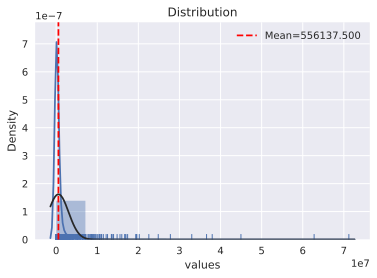

In [23]:
draw_histogram(prep_df['price']) 

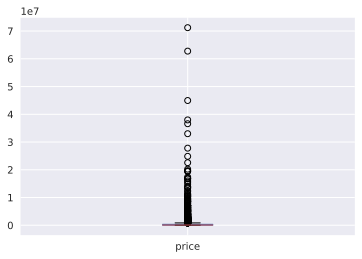

In [26]:
prep_df.boxplot(column=['price'])
plt.show()

In [24]:
count_skewness_kurtosis(prep_df['price'])

Skewness: 15.390329
Kurtosis: 331.992035


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long tail.
* Data looks like needed to be log transformed.

**Log transformation**

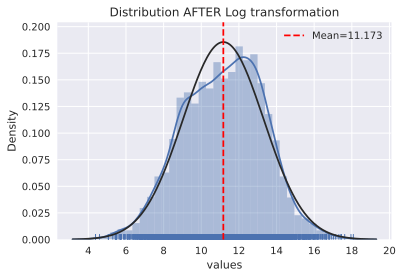

In [25]:
draw_lognorm(prep_df['price'])

* We see that the distribution seems to be more the normal one after lognorm transformation - it is more symmetrical now , domed, and  the variance turned out to be less. This is exactly what we assumed as the noise distribution.


## **Numeric features**

In [28]:
NUMERICAL = ['average_rating', 'duration', 'user_count_3months', 'av_ratings_3months']

**Distribution**

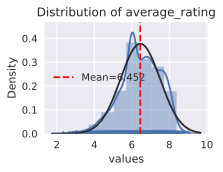

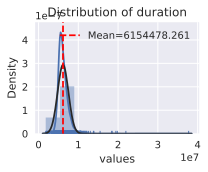

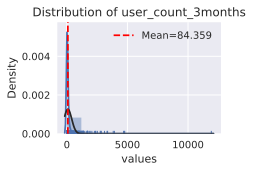

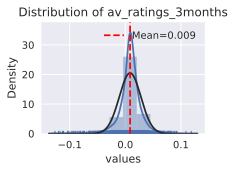

In [29]:
draw_histograms(prep_df, NUMERICAL)

* **needed to be lognorm:**  
    - duration
    - user_count_3months

## **Multivariate analysis**

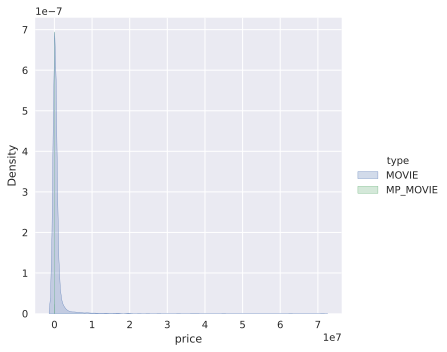

In [30]:
sns.displot(prep_df, x='price',hue ='type', kind ='kde', fill="True")
plt.show()

In [36]:
prep_df['type'].value_counts()

MOVIE       4100
MP_MOVIE      40
Name: type, dtype: int64

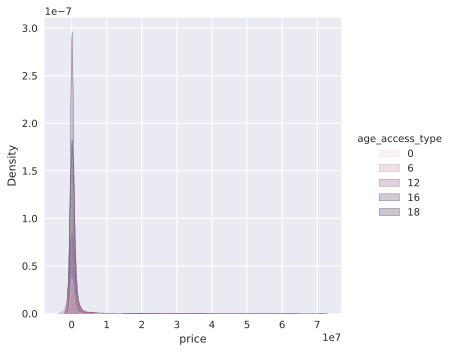

In [31]:
sns.displot(prep_df, x='price',hue ='age_access_type', kind ='kde', fill="True")
plt.show()

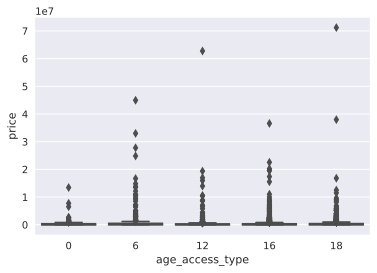

In [32]:
sns.boxplot(x='age_access_type', y='price', data=prep_df)
plt.show()

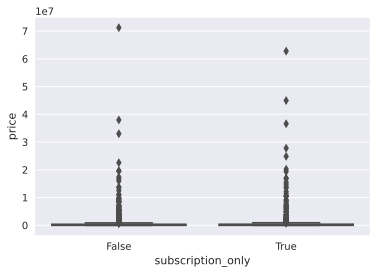

In [33]:
sns.boxplot(x='subscription_only', y='price', data=prep_df)
plt.show()

### Multiple value categorical features: tops' tf-idf

In [54]:
mltpl_cat_features = ['actor', 'country', 'genre', 'director']
num_features = [ 'average_rating', 'duration', 'av_ratings_3months']
skewed_num_features = ['duration', 'user_count_3months'] # can try 'average_rating'
text_features = ['name']
mltpl_cat_n_top = {'actor': 4, 'country': 1, 'genre': 2, 'director': 1}

In [55]:
prep_df.head(1)

,actor,age_access_type,country,average_rating,duration,type,name,release_year,genre,director,element_uid,subscription_only,user_count_3months,av_ratings_3months,price
0,"[cff3362f-ad91-498d-80b3-ea3ab8ec65cf, 39124be...",16,[usa],NaN,5280000,MOVIE,Роман с кукушкой,2021,"[Comedy, Melodrama, Drama]",[f5fba6fe-94b3-4e69-acfc-da6867320386],a367ca50-ef7d-4a4c-b89a-c8692defa697,False,5,0.010101,114578.0


In [56]:
from collections import Counter
from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
from sklearn.model_selection import train_test_split
# from spacy.tokenizer import Tokenizer
# from spacy.lang.en import English
# nlp = English()


class Preprocesser:
    def __init__(self, 
                mulpiple_cat_features: list,
                skewed_num_features: list,
               # text_features: list,
               # release_year_feature: str,
                mltpl_cat_n_top: dict):
        self.mulpiple_cat_features = mulpiple_cat_features
        self.skewed_num_features = skewed_num_features
        #self.text_features = text_features
        self.mltpl_cat_n_top = mltpl_cat_n_top
       # self.release_year_feature = release_year_feature
        # self.tokenizer = Tokenizer(nlp.vocab)
        
    def __get_top_n_mltpl_cat_features(self, df_pr, col):
        all_cats = []
        for element_values in df_pr[col]:
            all_cats.extend(element_values)
        return Counter(all_cats).most_common(self.mltpl_cat_n_top[col])
            
    def __preprocess_mulpiple_cat_features(self, df_pr):
        for col in self.mulpiple_cat_features:
            feature_number = self.mltpl_cat_n_top[col]
            df_pr[[f'{col}_{i}' for i in range(feature_number)]] = pd.DataFrame(np.full((len(df), feature_number), np.nan))
            for i in df_pr.index:
                names = df_pr.loc[i, col]
                for k, name in enumerate(names[:int(feature_number)]):
                    df_pr.loc[i, f'{col}_{k}'] = name
            df_pr.drop(col, axis=1, inplace=True)

        return df_pr
    
    def __preprocess_skewed_num_features(self, df_pr):
        for col in self.skewed_num_features:
            df_pr[col] = df_pr[col].apply(lambda x: np.log1p(x))
        return df_pr
    
    def __preprocess_text_features(self, df_pr):
        for col in self.text_features:
            df_pr[col] = df_pr[col].apply(lambda x: self.tokenizer(x))
        return df_pr
            
    def preprocess(self,
                   df: pd.DataFrame):
        df_pr = df.copy()
        df_pr = self.__preprocess_mulpiple_cat_features(df_pr)
        df_pr = self.__preprocess_skewed_num_features(df_pr)
        # df_pr = self.__preprocess_text_features(df_pr)
        
        return df_pr
        

In [57]:
preprocesser = Preprocesser(mltpl_cat_features,
            skewed_num_features,
            #text_features,
            mltpl_cat_n_top)

In [58]:
df_pr = preprocesser.preprocess(df)

In [59]:
df_pr.isnull().sum()

age_access_type         0
average_rating        139
duration                0
type                    0
name                    0
release_year            0
element_uid             0
subscription_only       0
av_rate_x               0
av_rate_y               0
users_number_x          0
users_number_y          0
user_count_3months      0
av_ratings_3months      0
min_ts                  0
price                   0
actor_0                 0
actor_1                18
actor_2                49
actor_3               106
country_0               0
genre_0                 0
genre_1               976
director_0              0
dtype: int64

In [60]:
df_pr['subscription_only'] = df_pr['subscription_only'].astype(int)

### user_count_3months filter

In [62]:
df_pr = df_pr[df_pr['user_count_3months'] <= 6]

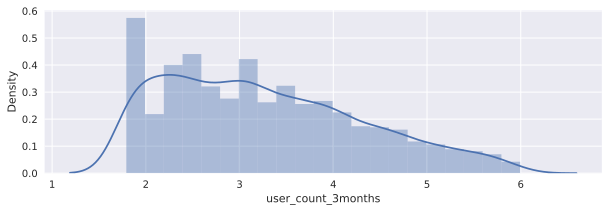

In [63]:
plt.figure(figsize=(10, 3))
sns.distplot(df_pr['user_count_3months'])
plt.show()

### year filter

<AxesSubplot:>

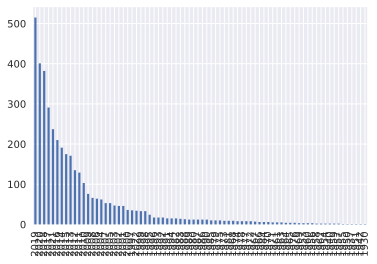

In [64]:
df_pr['release_year'].value_counts().plot(kind='bar')

In [65]:
df_pr = df_pr[df_pr['release_year'] >= 2000]

<AxesSubplot:>

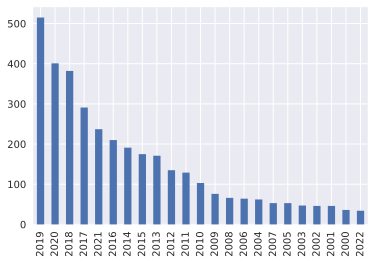

In [66]:
df_pr['release_year'].value_counts().plot(kind='bar')

### choose features

In [67]:
df_pr.head(1).T

,0
age_access_type,16
average_rating,NaN
duration,15.479437
type,MOVIE
name,Роман с кукушкой
release_year,2021
element_uid,a367ca50-ef7d-4a4c-b89a-c8692defa697
subscription_only,0
av_rate_x,0.010101
av_rate_y,0.006173


In [68]:
data = df_pr[['age_access_type', 'average_rating', 'duration', 'type',
       'release_year', 'subscription_only', 'user_count_3months',
       'av_ratings_3months', 'actor_0', 'actor_1',
       'actor_2', 'actor_3', 'country_0', 'genre_0', 'genre_1',
     'director_0', 'price']]

In [69]:
cat_features = ['type', 'actor_0', 'actor_1', 'actor_2', 'actor_3',
               'country_0', 'genre_0', 'genre_1', 'director_0']

data[cat_features] = data[cat_features].replace(np.nan, 'Na')

In [70]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3523 entries, 0 to 4101
Data columns (total 17 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   age_access_type     3523 non-null   object 
 1   average_rating      3388 non-null   object 
 2   duration            3523 non-null   float64
 3   type                3523 non-null   object 
 4   release_year        3523 non-null   object 
 5   subscription_only   3523 non-null   int64  
 6   user_count_3months  3523 non-null   float64
 7   av_ratings_3months  3523 non-null   float64
 8   actor_0             3523 non-null   object 
 9   actor_1             3523 non-null   object 
 10  actor_2             3523 non-null   object 
 11  actor_3             3523 non-null   object 
 12  country_0           3523 non-null   object 
 13  genre_0             3523 non-null   object 
 14  genre_1             3523 non-null   object 
 15  director_0          3523 non-null   object 
 16  price 

In [71]:
data['release_year'] =data['release_year'].astype(int)
data['average_rating'] =data['average_rating'].astype(float)
data['age_access_type'] =data['age_access_type'].astype(int)

### Split

In [72]:
X, y = data.drop(['price'], axis=1), data['price']

y = y.apply(lambda x: np.log1p(x))

In [73]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, shuffle=True)

In [74]:
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.1, random_state=42, shuffle=True)

In [75]:
X_train.shape, X_val.shape, X_test.shape, y_train.shape, y_val.shape, y_test.shape

((2853, 16), (317, 16), (353, 16), (2853,), (317,), (353,))

In [76]:
X_train.columns

Index(['age_access_type', 'average_rating', 'duration', 'type', 'release_year',
       'subscription_only', 'user_count_3months', 'av_ratings_3months',
       'actor_0', 'actor_1', 'actor_2', 'actor_3', 'country_0', 'genre_0',
       'genre_1', 'director_0'],
      dtype='object')

### Missing data

In [77]:
X_train.isna().sum()

age_access_type         0
average_rating        117
duration                0
type                    0
release_year            0
subscription_only       0
user_count_3months      0
av_ratings_3months      0
actor_0                 0
actor_1                 0
actor_2                 0
actor_3                 0
country_0               0
genre_0                 0
genre_1                 0
director_0              0
dtype: int64

In [78]:
X_test.isna().sum()

age_access_type       0
average_rating        9
duration              0
type                  0
release_year          0
subscription_only     0
user_count_3months    0
av_ratings_3months    0
actor_0               0
actor_1               0
actor_2               0
actor_3               0
country_0             0
genre_0               0
genre_1               0
director_0            0
dtype: int64

In [79]:
from sklearn.impute import KNNImputer

In [81]:
imputer = KNNImputer()

imputer.fit(X_train[['average_rating']])
# imp_data = pd.DataFrame(imputer.fit_transform(X_train), columns=['average_rating'])
# imp_data.isna().sum()

KNNImputer()

In [82]:
train = imputer.transform(X_train[['average_rating']])
test = imputer.transform(X_test[['average_rating']])

In [83]:
train

array([[7.66],
       [7.75],
       [5.6 ],
       ...,
       [6.97],
       [6.14],
       [4.5 ]])

In [84]:
X_train.shape

(2853, 16)

In [85]:
X_train['average_rating'] = train

In [86]:
X_test['average_rating'] = test

### OHE

In [87]:
from sklearn.preprocessing import OneHotEncoder

enc = OneHotEncoder(dtype='int8', handle_unknown='ignore')

enc_train = enc.fit_transform(X_train[['age_access_type']])

In [88]:
enc_train = pd.DataFrame(enc_train.toarray())

enc_train.columns = enc.get_feature_names_out(['age_access_type'])

X_train.drop(['age_access_type'], axis=1, inplace=True)
X_train = X_train.merge(enc_train, on=X_train.index, how='left', sort=False)

In [89]:
X_train.head().T

,0,1,2,3,4
key_0,209,164,965,1830,298
average_rating,7.66,7.75,5.6,7.05,6.78
duration,15.729488,15.747032,15.555977,15.693448,15.51296
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
release_year,2002,2007,2018,2005,2001
subscription_only,0,0,0,1,0
user_count_3months,2.197225,3.218876,3.988984,3.401197,3.78419
av_ratings_3months,0.0,0.01087,0.011162,0.003122,0.010865
actor_0,9a0ebf04-adbe-4e3e-8646-ec9dae83b363,98bfd360-0f70-4751-8536-c1d33ae5f136,91eb68ac-e234-4e50-b471-31c5ef28839e,54fe8c13-9bf7-4195-bfbb-bb63764351cb,e7e8df57-9f5d-4d45-ba58-2cfaa0843047
actor_1,f6449e61-98c2-4ebc-8b68-f12b60dbd6b7,d3c5d6d7-4c7b-46e1-9012-3a27096902c0,184edfa0-f143-4c72-a789-5b3a8ac044f3,3e3bbd35-1567-4bcb-82e5-12e88ab30a97,3aba6ae6-c6bc-4c7e-b44e-6b166b90ef61


In [90]:
enc_test = enc.transform(X_test[['age_access_type']])

In [91]:
enc_test = pd.DataFrame(enc_test.toarray())

enc_test.columns = enc.get_feature_names_out(['age_access_type'])

X_test.drop(['age_access_type'], axis=1, inplace=True)
X_test = X_test.merge(enc_test, on=X_test.index, how='left', sort=False)

In [92]:
X_test.head().T

,0,1,2,3,4
key_0,1910,1932,3318,3620,3566
average_rating,5.17,7.56,6.74,6.0,6.27
duration,15.566448,15.89994,15.490736,15.877297,15.523889
type,MOVIE,MOVIE,MOVIE,MOVIE,MOVIE
release_year,2021,2005,2008,2019,2014
subscription_only,0,0,0,0,0
user_count_3months,2.197225,2.302585,2.197225,4.543295,2.833213
av_ratings_3months,-0.01278,0.013953,0.016393,0.025205,0.009317
actor_0,7ee1b08f-9324-4245-ba76-4dfd1db3ecaa,8f75dc99-5e88-42ef-96eb-6bc2462c6abc,5ed4a527-5a31-4443-ae08-e63e76e88990,d52f3a59-9e9f-4639-a344-b6cdc810b039,19dbe2db-5070-41a4-98a7-df8927ab45ae
actor_1,c93982ac-f1c4-46cd-992f-72e2b47232c7,8375f294-e2f9-456f-8ef1-f90f3a156ed2,4b2a66a2-5ad1-4efe-891f-a8e76d5d2983,7334b2a4-7c4f-4887-a2ec-7dc35cdf9209,b304f17e-bcc4-4243-8d56-d35d1a7283a5


In [93]:
enc_val = enc.transform(X_val[['age_access_type']])

enc_val = pd.DataFrame(enc_val.toarray())

enc_val.columns = enc.get_feature_names_out(['age_access_type'])

X_val.drop(['age_access_type'], axis=1, inplace=True)
X_val = X_val.merge(enc_val, on=X_val.index, how='left', sort=False)

### Standartisation

In [179]:
# X_train.describe(include='all')

In [180]:
# X_train.head(1)

In [181]:
# from sklearn.preprocessing import StandardScaler

# numerical = [ 'duration', 'user_count_3months']  # 'average_rating',
# numeric_transformer = StandardScaler()
# X_train[numerical] = numeric_transformer.fit_transform(X_train[numerical])
# X_test[numerical] = numeric_transformer.transform(X_test[numerical])

## Modeling

In [94]:
import catboost as cat
from catboost import CatBoostRegressor
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

In [95]:
cat_features = ['type',
'release_year',
'subscription_only',
 'actor_0',
 'actor_1',
 'actor_2',
 'actor_3',
 'country_0',
 'genre_0',
 'genre_1',
 'director_0',
'age_access_type_0', 
'age_access_type_6',
'age_access_type_12', 
'age_access_type_16', 
'age_access_type_18']

In [96]:
X_train.drop('key_0', inplace=True, axis=1)


In [97]:
X_val.drop('key_0', inplace=True, axis=1)

In [98]:
X_test.drop('key_0', inplace=True, axis=1)

In [107]:
train_dataset = cat.Pool(data=X_train,
                        label=y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(data=X_test, 
                        label=y_test,
                         cat_features=cat_features)

val_dataset = cat.Pool(X_val, 
                       y_val,
                       cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

cat_model = cat.CatBoostRegressor(**cat_params)

cat_model.fit(
    train_dataset,
    eval_set=val_dataset,
    early_stopping_rounds=500,
    verbose=100,
    plot=False
)

Learning rate set to 0.060031
0:	learn: 1.6371284	test: 1.5988173	best: 1.5988173 (0)	total: 19ms	remaining: 19s
100:	learn: 1.1291538	test: 1.1473270	best: 1.1473270 (100)	total: 1.18s	remaining: 10.5s
200:	learn: 1.0549350	test: 1.1255411	best: 1.1249159 (198)	total: 2.28s	remaining: 9.05s
300:	learn: 0.9892509	test: 1.1167285	best: 1.1127756 (283)	total: 3.43s	remaining: 7.96s
400:	learn: 0.9310613	test: 1.1090543	best: 1.1080471 (394)	total: 4.62s	remaining: 6.9s
500:	learn: 0.8782043	test: 1.1007733	best: 1.1004894 (495)	total: 5.82s	remaining: 5.79s
600:	learn: 0.8331241	test: 1.0998498	best: 1.0992418 (597)	total: 7.02s	remaining: 4.66s
700:	learn: 0.7970960	test: 1.0956722	best: 1.0956042 (698)	total: 8.26s	remaining: 3.52s
800:	learn: 0.7660352	test: 1.0922697	best: 1.0904600 (781)	total: 9.47s	remaining: 2.35s
900:	learn: 0.7364969	test: 1.0952608	best: 1.0904600 (781)	total: 10.7s	remaining: 1.18s
999:	learn: 0.7088391	test: 1.0921671	best: 1.0904600 (781)	total: 11.9s	remai

In [108]:
y_pred = cat_model.predict(test_dataset)

In [109]:
from sklearn import metrics

def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

In [110]:
cat_model.save_model('cat_reg_income_prepr_new')

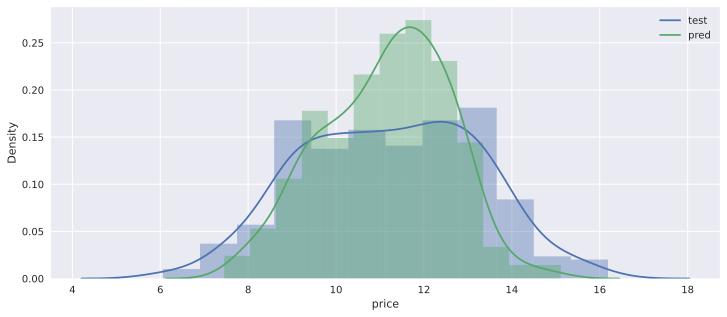

In [111]:
plt.figure(figsize=(12, 5))
sns.distplot(y_test)
sns.distplot(y_pred)
plt.legend(['test', 'pred'])
plt.show()

In [112]:
def inverse_transform(feature):
    return np.expm1(feature)

In [113]:
calc_metrics(inverse_transform(y_test), inverse_transform(y_pred))

*** VAL **: 
MSE:   803952207887.1364
RMSE:  896633.8204011358
R2:    0.2293591195271324
MAE:   309145.5138384584
MedAE: 58554.049084647966
------------------------------


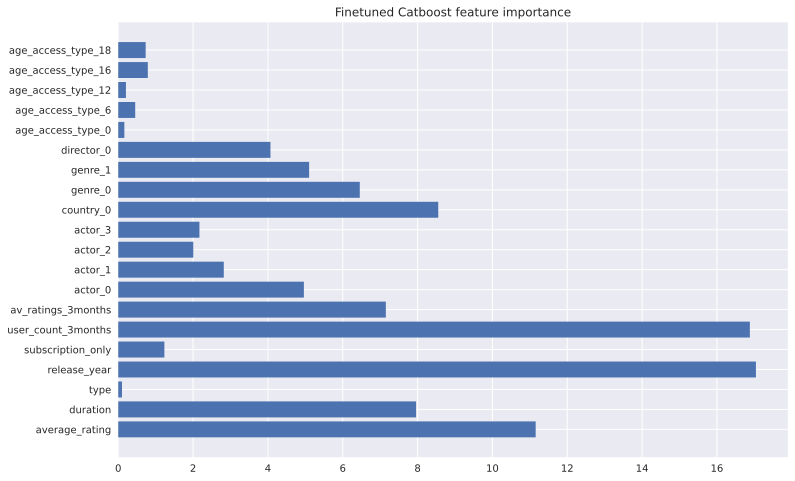

In [114]:
imp = cat_model.get_feature_importance(data=train_dataset)
fig, axes = plt.subplots(1, 1, figsize=(12, 8))
axes.barh(width=imp, y=cat_model.feature_names_)
axes.set_title('Finetuned Catboost feature importance')
plt.savefig('cat_feature_importance_2.png')
plt.show()

In [115]:
sns.pairplot(data, height=1.2, aspect=1.25)

# Tuning RUN!!!!

In [412]:
train_dataset = cat.Pool(X_train, 
                         y_train,
                         cat_features=cat_features)

test_dataset = cat.Pool(X_test, 
                        y_test,
                        cat_features=cat_features)

cat_params = {
    'loss_function': 'RMSE',
    'eval_metric': 'MAE',
    'verbose': True,
    'random_seed': 321,
    'allow_writing_files': False, 
    'cat_features': cat_features
}

In [414]:
from scipy.stats import uniform, randint

parameters_distr = {'depth': randint(3, 7),
              'learning_rate': uniform(0.01, 0.1),
              'iterations': [100, 1000, 5000]
             }

cat_model = cat.CatBoostRegressor(**cat_params)
grid = RandomizedSearchCV(estimator=cat_model, param_distributions=parameters_distr, 
                            cv=5, n_jobs=-1, verbose=3)

grid.fit(X_train, y_train)

import pickle
with open('bestimator_income_new_prepr', 'wb') as f:
    pickle.dump(grid.best_estimator_, f)
grid.best_params_

Fitting 5 folds for each of 10 candidates, totalling 50 fits
0:	learn: 1.6521307	total: 122ms	remaining: 10m 10s
1:	learn: 1.6201655	total: 135ms	remaining: 5m 36s
2:	learn: 1.5879661	total: 237ms	remaining: 6m 34s
3:	learn: 1.5606894	total: 729ms	remaining: 15m 11s
4:	learn: 1.5333852	total: 875ms	remaining: 14m 34s
5:	learn: 1.5094691	total: 1.02s	remaining: 14m 8s
6:	learn: 1.4869630	total: 1.13s	remaining: 13m 25s
7:	learn: 1.4660731	total: 1.16s	remaining: 12m 2s
8:	learn: 1.4475196	total: 1.39s	remaining: 12m 49s
9:	learn: 1.4353142	total: 1.6s	remaining: 13m 17s
10:	learn: 1.4193702	total: 1.87s	remaining: 14m 9s
11:	learn: 1.4090852	total: 2.37s	remaining: 16m 26s
12:	learn: 1.4005255	total: 2.44s	remaining: 15m 36s
13:	learn: 1.3896414	total: 2.93s	remaining: 17m 22s
14:	learn: 1.3820337	total: 3.68s	remaining: 20m 24s
15:	learn: 1.3748305	total: 3.95s	remaining: 20m 30s
16:	learn: 1.3651954	total: 4.52s	remaining: 22m 4s
17:	learn: 1.3548104	total: 5.03s	remaining: 23m 10s
18

111:	learn: 1.1719261	total: 1m 22s	remaining: 1h 15s
112:	learn: 1.1710336	total: 1m 26s	remaining: 1h 2m 2s
113:	learn: 1.1697560	total: 1m 26s	remaining: 1h 2m 8s
114:	learn: 1.1693768	total: 1m 27s	remaining: 1h 2m 8s
115:	learn: 1.1686487	total: 1m 28s	remaining: 1h 2m 7s
116:	learn: 1.1680121	total: 1m 29s	remaining: 1h 2m 2s
117:	learn: 1.1678451	total: 1m 30s	remaining: 1h 2m 11s
118:	learn: 1.1678177	total: 1m 31s	remaining: 1h 2m 50s
119:	learn: 1.1671042	total: 1m 32s	remaining: 1h 2m 32s
120:	learn: 1.1667255	total: 1m 33s	remaining: 1h 2m 47s
121:	learn: 1.1663758	total: 1m 34s	remaining: 1h 2m 41s
122:	learn: 1.1662188	total: 1m 34s	remaining: 1h 2m 43s
123:	learn: 1.1656117	total: 1m 37s	remaining: 1h 3m 36s
124:	learn: 1.1652585	total: 1m 37s	remaining: 1h 3m 18s
125:	learn: 1.1651531	total: 1m 38s	remaining: 1h 3m 16s
126:	learn: 1.1648402	total: 1m 41s	remaining: 1h 4m 36s
127:	learn: 1.1632165	total: 1m 41s	remaining: 1h 4m 19s
128:	learn: 1.1627677	total: 1m 42s	rem

0:	learn: 1.6805485	total: 835ms	remaining: 1h 9m 34s
1:	learn: 1.6731308	total: 1.33s	remaining: 55m 25s
2:	learn: 1.6644313	total: 1.88s	remaining: 52m 13s
3:	learn: 1.6558708	total: 2.17s	remaining: 45m 12s
4:	learn: 1.6476014	total: 3.12s	remaining: 51m 54s
5:	learn: 1.6404672	total: 3.32s	remaining: 46m 5s
6:	learn: 1.6322868	total: 4.15s	remaining: 49m 20s
7:	learn: 1.6247946	total: 4.97s	remaining: 51m 43s
8:	learn: 1.6172617	total: 5.54s	remaining: 51m 10s
9:	learn: 1.6104049	total: 5.77s	remaining: 48m 1s
10:	learn: 1.6033700	total: 6.04s	remaining: 45m 37s
11:	learn: 1.5970466	total: 6.39s	remaining: 44m 14s
12:	learn: 1.5914290	total: 7.03s	remaining: 44m 58s
13:	learn: 1.5860884	total: 8.94s	remaining: 53m 3s
14:	learn: 1.5801917	total: 9.48s	remaining: 52m 31s
15:	learn: 1.5741183	total: 10s	remaining: 51m 54s
16:	learn: 1.5685644	total: 11.1s	remaining: 54m 19s
17:	learn: 1.5628464	total: 11.7s	remaining: 53m 54s
18:	learn: 1.5567118	total: 11.8s	remaining: 51m 35s
19:	le

33:	learn: 1.4826227	total: 28.2s	remaining: 1h 8m 34s
34:	learn: 1.4790682	total: 29.4s	remaining: 1h 9m 25s
35:	learn: 1.4744647	total: 29.9s	remaining: 1h 8m 46s
36:	learn: 1.4699938	total: 30.1s	remaining: 1h 7m 21s
37:	learn: 1.4661854	total: 31s	remaining: 1h 7m 25s
38:	learn: 1.4617483	total: 31.6s	remaining: 1h 6m 56s
39:	learn: 1.4575883	total: 31.9s	remaining: 1h 5m 55s
40:	learn: 1.4536888	total: 32.8s	remaining: 1h 6m 8s
41:	learn: 1.4499586	total: 32.8s	remaining: 1h 4m 35s
42:	learn: 1.4467739	total: 33.4s	remaining: 1h 4m 6s
43:	learn: 1.4439596	total: 34.2s	remaining: 1h 4m 11s
44:	learn: 1.4409027	total: 34.3s	remaining: 1h 2m 52s
45:	learn: 1.4374526	total: 35.1s	remaining: 1h 3m
46:	learn: 1.4343733	total: 36.3s	remaining: 1h 3m 41s
47:	learn: 1.4308175	total: 37.3s	remaining: 1h 4m 11s
48:	learn: 1.4277054	total: 37.8s	remaining: 1h 3m 39s
49:	learn: 1.4248147	total: 38.8s	remaining: 1h 4m 5s
50:	learn: 1.4217729	total: 39.7s	remaining: 1h 4m 15s
51:	learn: 1.418751

103:	learn: 1.2046679	total: 1m 54s	remaining: 1h 30m
104:	learn: 1.2034147	total: 1m 55s	remaining: 1h 29m 45s
105:	learn: 1.2033387	total: 1m 56s	remaining: 1h 29m 19s
106:	learn: 1.2029077	total: 1m 56s	remaining: 1h 28m 28s
107:	learn: 1.2026522	total: 1m 56s	remaining: 1h 27m 40s
108:	learn: 1.2023713	total: 1m 58s	remaining: 1h 28m 24s
109:	learn: 1.2017274	total: 1m 59s	remaining: 1h 28m 10s
110:	learn: 1.2011170	total: 1m 59s	remaining: 1h 28m
111:	learn: 1.1993194	total: 2m	remaining: 1h 27m 25s
112:	learn: 1.1988375	total: 2m	remaining: 1h 27m 9s
113:	learn: 1.1979067	total: 2m 2s	remaining: 1h 27m 21s
114:	learn: 1.1969848	total: 2m 2s	remaining: 1h 27m 2s
115:	learn: 1.1967953	total: 2m 3s	remaining: 1h 26m 19s
116:	learn: 1.1957677	total: 2m 3s	remaining: 1h 25m 39s
117:	learn: 1.1952903	total: 2m 5s	remaining: 1h 26m 13s
118:	learn: 1.1934663	total: 2m 8s	remaining: 1h 28m 6s
119:	learn: 1.1932612	total: 2m 9s	remaining: 1h 28m
120:	learn: 1.1925076	total: 2m 10s	remainin

287:	learn: 1.1115209	total: 2m 54s	remaining: 47m 35s
288:	learn: 1.1114233	total: 2m 54s	remaining: 47m 30s
289:	learn: 1.1109423	total: 2m 55s	remaining: 47m 31s
290:	learn: 1.1105687	total: 2m 55s	remaining: 47m 27s
291:	learn: 1.1103749	total: 2m 56s	remaining: 47m 25s
292:	learn: 1.1095604	total: 2m 56s	remaining: 47m 21s
293:	learn: 1.1094885	total: 2m 58s	remaining: 47m 38s
294:	learn: 1.1094503	total: 2m 59s	remaining: 47m 36s
295:	learn: 1.1092634	total: 2m 59s	remaining: 47m 34s
296:	learn: 1.1080285	total: 2m 59s	remaining: 47m 26s
297:	learn: 1.1069377	total: 3m	remaining: 47m 21s
298:	learn: 1.1063389	total: 3m	remaining: 47m 15s
299:	learn: 1.1057213	total: 3m	remaining: 47m 13s
300:	learn: 1.1056953	total: 3m 1s	remaining: 47m 8s
301:	learn: 1.1056953	total: 3m 1s	remaining: 47m 10s
302:	learn: 1.1051845	total: 3m 2s	remaining: 47m 8s
303:	learn: 1.1049586	total: 3m 3s	remaining: 47m 8s
0:	learn: 1.6780811	total: 924ms	remaining: 15m 23s
1:	learn: 1.6640499	total: 1.77s

151:	learn: 1.2070089	total: 3m 2s	remaining: 17m
152:	learn: 1.2065552	total: 3m 3s	remaining: 16m 53s
0:	learn: 1.6386096	total: 1.07s	remaining: 1h 29m 31s
1:	learn: 1.5888869	total: 1.77s	remaining: 1h 13m 33s
2:	learn: 1.5522813	total: 2.16s	remaining: 59m 59s
3:	learn: 1.5193841	total: 2.69s	remaining: 56m
4:	learn: 1.4845517	total: 3.63s	remaining: 1h 32s
5:	learn: 1.4545855	total: 4.84s	remaining: 1h 7m 6s
6:	learn: 1.4357970	total: 6.18s	remaining: 1h 13m 31s
7:	learn: 1.4158916	total: 6.7s	remaining: 1h 9m 39s
8:	learn: 1.3956246	total: 7.63s	remaining: 1h 10m 32s
9:	learn: 1.3792952	total: 9.71s	remaining: 1h 20m 47s
10:	learn: 1.3668026	total: 11.4s	remaining: 1h 25m 52s
11:	learn: 1.3526573	total: 13.4s	remaining: 1h 32m 36s
12:	learn: 1.3418309	total: 15.2s	remaining: 1h 37m 17s
13:	learn: 1.3296572	total: 16.2s	remaining: 1h 36m 2s
14:	learn: 1.3216931	total: 16.6s	remaining: 1h 31m 56s
15:	learn: 1.3147639	total: 17s	remaining: 1h 28m 5s
16:	learn: 1.3061760	total: 17.5

52:	learn: 1.3372675	total: 35.4s	remaining: 10m 32s
53:	learn: 1.3340022	total: 36s	remaining: 10m 30s
54:	learn: 1.3313561	total: 36.6s	remaining: 10m 28s
55:	learn: 1.3283005	total: 37.6s	remaining: 10m 33s
56:	learn: 1.3257436	total: 38.3s	remaining: 10m 34s
57:	learn: 1.3229674	total: 38.8s	remaining: 10m 30s
58:	learn: 1.3200112	total: 39.3s	remaining: 10m 26s
59:	learn: 1.3181426	total: 40.4s	remaining: 10m 32s
60:	learn: 1.3151452	total: 40.8s	remaining: 10m 27s
61:	learn: 1.3123728	total: 41.2s	remaining: 10m 23s
62:	learn: 1.3096848	total: 41.3s	remaining: 10m 14s
63:	learn: 1.3070142	total: 43.6s	remaining: 10m 38s
64:	learn: 1.3050526	total: 47.3s	remaining: 11m 21s
65:	learn: 1.3024240	total: 51.4s	remaining: 12m 7s
66:	learn: 1.3003026	total: 52.1s	remaining: 12m 6s
67:	learn: 1.2981157	total: 56.2s	remaining: 12m 49s
68:	learn: 1.2961791	total: 58.5s	remaining: 13m 9s
69:	learn: 1.2949521	total: 1m 1s	remaining: 13m 41s
70:	learn: 1.2931182	total: 1m 2s	remaining: 13m 39

77:	learn: 1.2514377	total: 1m 33s	0:	learn: 1.6975410	total: 424ms	remaining: 35m 19s
1:	learn: 1.6888103	total: 906ms	remaining: 37m 43s
2:	learn: 1.6823099	total: 1.38s	remaining: 38m 13s
3:	learn: 1.6743554	total: 1.88s	remaining: 39m 5s
4:	learn: 1.6663651	total: 2.2s	remaining: 36m 38s
5:	learn: 1.6583578	total: 2.57s	remaining: 35m 38s
6:	learn: 1.6514672	total: 3.64s	remaining: 43m 18s
7:	learn: 1.6439859	total: 3.71s	remaining: 38m 36s
8:	learn: 1.6367605	total: 5s	remaining: 46m 11s
9:	learn: 1.6297890	total: 5.26s	remaining: 43m 43s
10:	learn: 1.6234971	total: 5.89s	remaining: 44m 30s
11:	learn: 1.6165264	total: 6.13s	remaining: 42m 29s
12:	learn: 1.6105728	total: 6.57s	remaining: 42m
13:	learn: 1.6042418	total: 6.88s	remaining: 40m 51s
14:	learn: 1.5978385	total: 7.49s	remaining: 41m 29s
15:	learn: 1.5917704	total: 8.61s	remaining: 44m 43s
16:	learn: 1.5860799	total: 9.1s	remaining: 44m 25s
17:	learn: 1.5796855	total: 9.2s	remaining: 42m 26s
18:	learn: 1.5731704	total: 12.1

51:	learn: 1.2787734	total: 1m 3s	remaining: 19m 9s
52:	learn: 1.2771077	total: 1m 4s	remaining: 19m 7s
53:	learn: 1.2747363	total: 1m 5s	remaining: 19m 9s
54:	learn: 1.2736186	total: 1m 7s	remaining: 19m 14s
55:	learn: 1.2717303	total: 1m 10s	remaining: 19m 41s
56:	learn: 1.2693725	total: 1m 11s	remaining: 19m 47s
57:	learn: 1.2674031	total: 1m 15s	remaining: 20m 33s
58:	learn: 1.2656885	total: 1m 16s	remaining: 20m 19s
59:	learn: 1.2644225	total: 1m 17s	remaining: 20m 15s
60:	learn: 1.2626968	total: 1m 18s	remaining: 20m 12s
61:	learn: 1.2613006	total: 1m 20s	remaining: 20m 19s
62:	learn: 1.2590290	total: 1m 23s	remaining: 20m 48s
63:	learn: 1.2572711	total: 1m 26s	remaining: 21m 11s
64:	learn: 1.2557766	total: 1m 28s	remaining: 21m 14s
65:	learn: 1.2534104	total: 1m 30s	remaining: 21m 23s
66:	learn: 1.2520067	total: 1m 31s	remaining: 21m 10s
67:	learn: 1.2502529	total: 1m 33s	remaining: 21m 19s
68:	learn: 1.2483255	total: 1m 34s	remaining: 21m 10s
69:	learn: 1.2466049	total: 1m 36s	

40:	learn: 1.2397227	total: 46.9s	remaining: 1h 34m 31s
41:	learn: 1.2381553	total: 47.7s	remaining: 1h 33m 54s
42:	learn: 1.2371796	total: 48.7s	remaining: 1h 33m 38s
43:	learn: 1.2348893	total: 49.9s	remaining: 1h 33m 41s
44:	learn: 1.2324757	total: 55.2s	remaining: 1h 41m 17s
45:	learn: 1.2309400	total: 1m	remaining: 1h 48m 41s
46:	learn: 1.2277217	total: 1m 1s	remaining: 1h 48m 35s
47:	learn: 1.2262120	total: 1m 2s	remaining: 1h 48m 18s
48:	learn: 1.2247379	total: 1m 4s	remaining: 1h 47m 50s
49:	learn: 1.2220847	total: 1m 5s	remaining: 1h 48m 2s
50:	learn: 1.2199688	total: 1m 7s	remaining: 1h 49m 12s
51:	learn: 1.2189862	total: 1m 9s	remaining: 1h 50m 24s
52:	learn: 1.2167121	total: 1m 10s	remaining: 1h 49m 46s
53:	learn: 1.2143817	total: 1m 12s	remaining: 1h 51m
54:	learn: 1.2136404	total: 1m 25s	remaining: 2h 8m 7s
55:	learn: 1.2121670	total: 1m 33s	remaining: 2h 17m
56:	learn: 1.2107873	total: 1m 34s	remaining: 2h 16m 42s
57:	learn: 1.2078728	total: 1m 35s	remaining: 2h 16m 10s


210:	learn: 1.0097179	total: 5m 3s	remaining: 1h 54m 40s
211:	learn: 1.0089709	total: 5m 5s	remaining: 1h 54m 56s
212:	learn: 1.0088995	total: 5m 6s	remaining: 1h 54m 41s
213:	learn: 1.0083330	total: 5m 7s	remaining: 1h 54m 26s
214:	learn: 1.0079632	total: 5m 8s	remaining: 1h 54m 16s
215:	learn: 1.0063847	total: 5m 10s	remaining: 1h 54m 31s
216:	learn: 1.0061748	total: 5m 10s	remaining: 1h 54m 12s
217:	learn0:	learn: 1.6676935	total: 423ms	remaining: 35m 14s
1:	learn: 1.6337146	total: 2s	remaining: 1h 23m 9s
2:	learn: 1.6028713	total: 3.67s	remaining: 1h 41m 48s
3:	learn: 1.5750242	total: 3.76s	remaining: 1h 18m 12s
4:	learn: 1.5483131	total: 7.85s	remaining: 2h 10m 41s
5:	learn: 1.5221921	total: 8.76s	remaining: 2h 1m 28s
6:	learn: 1.5011077	total: 9.97s	remaining: 1h 58m 29s
7:	learn: 1.4825628	total: 12.4s	remaining: 2h 8m 45s
8:	learn: 1.4629147	total: 13.4s	remaining: 2h 4m 5s
9:	learn: 1.4429221	total: 14.1s	remaining: 1h 57m 34s
10:	learn: 1.4258494	total: 15.5s	remaining: 1h 56

154:	learn: 1.2093472	total: 3m 20s	remaining: 18m 11s
155:	learn: 1.2086207	total: 3m 23s	remaining: 18m 21s
156:	learn: 1.2084124	total: 3m 24s	remaining: 18m 18s
157:	learn: 1.2074993	total: 3m 25s	remaining: 18m 13s
158:	learn: 1.2070020	total: 3m 26s	remaining: 18m 11s
159:	learn: 1.2066692	total: 3m 27s	remaining: 18m 10s
160:	learn: 1.2062224	total: 3m 28s	remaining: 18m 8s
161:	learn: 1.2054082	total: 3m 31s	remaining: 18m 11s
162:	learn: 1.2047047	total: 3m 31s	remaining: 18m 8s
163:	learn: 1.2040938	total: 3m 33s	remaining: 18m 9s
164:	learn: 1.2037550	total: 3m 34s	remaining: 18m 7s
165:	learn: 1.2034262	total: 3m 36s	remaining: 18m 5s
166:	learn: 1.2026614	total: 3m 36s	remaining: 18m 2s
167:	learn: 1.2019601	total: 3m 37s	remaining: 17m 58s
168:	learn: 1.2011125	total: 3m 39s	remaining: 18m
169:	learn: 1.2004208	total: 3m 39s	remaining: 17m 52s
170:	learn: 1.1996825	total: 3m 40s	remaining: 17m 48s
171:	learn: 1.1994568	total: 3m 41s	remaining: 17m 47s
172:	learn: 1.199230

49:	learn: 1.1940819	total: 2m 4s	remaining: 39m 26s
50:	learn: 1.1926953	total: 2m 6s	remaining: 39m 20s
51:	learn: 1.1909349	total: 2m 8s	remaining: 39m 5s
52:	learn: 1.1883538	total: 2m 10s	remaining: 38m 47s
53:	learn: 1.1881374	total: 2m 10s	remaining: 38m 7s
54:	learn: 1.1869211	total: 2m 14s	remaining: 38m 34s
55:	learn: 1.1851774	total: 2m 16s	remaining: 38m 25s
56:	learn: 1.1826964	total: 2m 21s	remaining: 38m 56s
57:	learn: 1.1805026	total: 2m 22s	remaining: 38m 38s
58:	learn: 1.1787226	total: 2m 24s	remaining: 38m 23s
59:	learn: 1.1757777	total: 2m 27s	remaining: 38m 37s
60:	learn: 1.1746707	total: 2m 29s	remaining: 38m 14s
61:	learn: 1.1725004	total: 2m 31s	remaining: 38m 17s
62:	learn: 1.1717378	total: 2m 32s	remaining: 37m 54s
63:	learn: 1.1697461	total: 2m 34s	remaining: 37m 42s
64:	learn: 1.1682834	total: 2m 39s	remaining: 38m 7s
65:	learn: 1.1677227	total: 2m 43s	remaining: 38m 28s
66:	learn: 1.1665315	total: 2m 44s	remaining: 38m 10s
67:	learn: 1.1657196	total: 2m 48s

98:	learn: 1.1357030	total: 2m 38s	remaining: 23m 59s
99:	learn: 1.1351961	total: 2m 39s	remaining: 23m 54s
100:	learn: 1.1346137	total: 2m 41s	remaining: 23m 58s
101:	learn: 1.1327208	total: 2m 42s	remaining: 23m 49s
102:	learn: 1.1313113	total: 2m 44s	remaining: 23m 51s
103:	learn: 1.1302146	total: 2m 45s	remaining: 23m 48s
104:	learn: 1.1296513	total: 2m 49s	remaining: 24m 8s
105:	learn: 1.1285467	total: 2m 51s	remaining: 24m 6s
106:	learn: 1.1264717	total: 2m 52s	remaining: 24m 1s
107:	learn: 1.1252003	total: 2m 54s	remaining: 24m
108:	learn: 1.1243116	total: 2m 56s	remaining: 24m
109:	learn: 1.1232456	total: 2m 56s	remaining: 23m 51s
110:	learn: 1.1223877	total: 2m 58s	remaining: 23m 46s
111:	learn: 1.1223209	total: 2m 59s	remaining: 23m 41s
112:	learn: 1.1207979	total: 3m 1s	remaining: 23m 42s
113:	learn: 1.1203775	total: 3m 3s	remaining: 23m 43s
114:	learn: 1.1195315	total: 3m 4s	remaining: 23m 43s
115:	learn: 1.1181223	total: 3m 6s	remaining: 23m 41s
116:	learn: 1.1178275	total

196:	learn: 1.1708907	total: 5m 14s	remaining: 21m 22s
197:	learn: 1.1704868	total: 5m 16s	remaining: 21m 20s
198:	learn: 1.1701897	total: 5m 17s	remaining: 21m 16s
199:	learn: 1.1696305	total: 5m 18s	remaining: 21m 15s
200:	learn: 1.1687678	total: 5m 24s	remaining: 21m 28s
201:	learn: 1.1683779	total: 5m 25s	remaining: 21m 24s
202:	learn: 1.1679599	total: 5m 25s	remaining: 21m 19s
203:	learn: 1.1677104	total: 5m 27s	remaining: 21m 19s
204:	learn: 1.1672476	total: 5m 28s	remaining: 21m 15s
205:	learn: 1.1664461	total: 5m 29s	remaining: 21m 10s
206:	learn: 1.1658877	total: 5m 29s	remaining: 21m 4s
207:	learn: 1.1654053	total: 5m 31s	remaining: 21m 1s
208:	learn: 1.1652925	total: 5m 31s	remaining: 20m 55s
209:	learn: 1.1650778	total: 5m 33s	remaining: 20m 54s
210:	learn: 1.1648423	total: 5m 34s	remaining: 20m 49s
211:	learn: 1.1645806	total: 5m 38s	remaining: 20m 57s
212:	learn: 1.1640167	total: 5m 38s	remaining: 20m 52s
213:	learn: 1.1630043	total: 5m 39s	remaining: 20m 46s
214:	learn: 

17:	learn: 1.4492730	total: 20s	remaining: 18m 12s
18:	learn: 1.4391207	total: 20.9s	remaining: 17m 57s
19:	learn: 1.4299140	total: 24.2s	remaining: 19m 46s
20:	learn: 1.4211315	total: 25.4s	remaining: 19m 42s
21:	learn: 1.4135078	total: 26s	remaining: 19m 17s
22:	learn: 1.4058475	total: 28.1s	remaining: 19m 54s
23:	learn: 1.3992950	total: 29.7s	remaining: 20m 8s
24:	learn: 1.3925963	total: 34s	remaining: 22m 6s
25:	learn: 1.3860132	total: 35s	remaining: 21m 49s
26:	learn: 1.3791483	total: 35.2s	remaining: 21m 9s
27:	learn: 1.3725751	total: 38.3s	remaining: 22m 7s
28:	learn: 1.3675569	total: 40s	remaining: 22m 19s
29:	learn: 1.3631357	total: 40.7s	remaining: 21m 56s
30:	learn: 1.3566837	total: 45.1s	remaining: 23m 30s
31:	learn: 1.3507753	total: 46.4s	remaining: 23m 23s
32:	learn: 1.3453587	total: 48.1s	remaining: 23m 29s
33:	learn: 1.3407680	total: 48.7s	remaining: 23m 3s
34:	learn: 1.3349694	total: 50.6s	remaining: 23m 14s
35:	learn: 1.3312081	total: 52.3s	remaining: 23m 20s
36:	lear

258:	learn: 1.0225147	total: 5m 48s	remaining: 1h 46m 26s
259:	learn: 1.0218089	total: 5m 48s	remaining: 1h 46m 2s
260:	learn: 1.0205582	total: 5m 49s	remaining: 1h 45m 47s
261:	learn: 1.0205290	total: 5m 50s	remaining: 1h 45m 32s
262:	learn: 1.0205210	total: 5m 50s	remaining: 1h 45m 7s
263:	learn: 1.0203215	total: 5m 50s	remaining: 1h 44m 56s
264:	learn: 1.0200390	total: 5m 51s	remaining: 1h 44m 35s
265:	learn: 1.0189349	total: 5m 51s	remaining: 1h 44m 10s
266:	learn: 1.0174696	total: 5m 51s	remaining: 1h 43m 58s
267:	learn: 1.0167539	total: 5m 52s	remaining: 1h 43m 43s
268:	learn: 1.0161472	total: 5m 53s	remaining: 1h 43m 31s
269:	learn: 1.0155766	total: 5m 54s	remaining: 1h 43m 24s
270:	learn: 1.0155683	total: 5m 54s	remaining: 1h 43m 5s
271:	learn: 1.0153530	total: 5m 55s	remaining: 1h 43m
272:	learn: 1.0153240	total: 5m 56s	remaining: 1h 42m 48s
273:	learn: 1.0149890	total: 5m 56s	remaining: 1h 42m 26s
274:	learn: 1.0127172	total: 5m 57s	remaining: 1h 42m 24s
275:	learn: 1.0122294

409:	learn: 0.8857214	total: 6m 15s	remaining: 1h 10m 6s
410:	learn: 0.8853990	total: 6m 15s	remaining: 1h 9m 55s
411:	learn: 0.8848829	total: 6m 15s	remaining: 1h 9m 44s
412:	learn: 0.8840900	total: 6m 15s	remaining: 1h 9m 33s
413:	learn: 0.8826440	total: 6m 15s	remaining: 1h 9m 23s
414:	learn: 0.8821607	total: 6m 15s	remaining: 1h 9m 12s
415:	learn: 0.8818079	total: 6m 15s	remaining: 1h 9m 1s
416:	learn: 0.8814915	total: 6m 15s	remaining: 1h 8m 51s
417:	learn: 0.8810756	total: 6m 15s	remaining: 1h 8m 40s
418:	learn: 0.8809869	total: 6m 15s	remaining: 1h 8m 30s
419:	learn: 0.8800875	total: 6m 15s	remaining: 1h 8m 20s
420:	learn: 0.8800125	total: 6m 16s	remaining: 1h 8m 10s
421:	learn: 0.8795489	total: 6m 16s	remaining: 1h 7m 59s
422:	learn: 0.8790953	total: 6m 16s	remaining: 1h 7m 49s
423:	learn: 0.8783070	total: 6m 16s	remaining: 1h 7m 39s
424:	learn: 0.8776636	total: 6m 16s	remaining: 1h 7m 29s
425:	learn: 0.8774149	total: 6m 16s	remaining: 1h 7m 19s
426:	learn: 0.8769055	total: 6m 

331:	learn: 1.1868973	total: 5m 5s	remaining: 1h 11m 35s
332:	learn: 1.1868148	total: 5m 5s	remaining: 1h 11m 24s
333:	learn: 1.1867083	total: 5m 5s	remaining: 1h 11m 11s
334:	learn: 1.1865602	total: 5m 5s	remaining: 1h 10m 59s
335:	learn: 1.1863791	total: 5m 5s	remaining: 1h 10m 46s
336:	learn: 1.1863335	total: 5m 6s	remaining: 1h 10m 34s
337:	learn: 1.1862212	total: 5m 6s	remaining: 1h 10m 24s
338:	learn: 1.1861257	total: 5m 6s	remaining: 1h 10m 11s
339:	learn: 1.1859355	total: 5m 6s	remaining: 1h 9m 59s
340:	learn: 1.1857934	total: 5m 6s	remaining: 1h 9m 46s
341:	learn: 1.1856692	total: 5m 6s	remaining: 1h 9m 35s
342:	learn: 1.1855544	total: 5m 6s	remaining: 1h 9m 23s
343:	learn: 1.1852815	total: 5m 6s	remaining: 1h 9m 11s
344:	learn: 1.1850865	total: 5m 6s	remaining: 1h 9m 1s
345:	learn: 1.1849356	total: 5m 7s	remaining: 1h 8m 50s
346:	learn: 1.1848688	total: 5m 7s	remaining: 1h 8m 38s
347:	learn: 1.1845343	total: 5m 7s	remaining: 1h 8m 28s
348:	learn: 1.1844328	total: 5m 7s	remain

55:	learn: 1.1876154	total: 1m 44s	remaining: 2h 34m 21s
56:	learn: 1.1870844	total: 1m 47s	remaining: 2h 35m 56s
57:	learn: 1.1856063	total: 1m 49s	remaining: 2h 35m 13s
58:	learn: 1.1846489	total: 1m 50s	remaining: 2h 34m 23s
59:	learn: 1.1832117	total: 1m 53s	remaining: 2h 36m 9s
60:	learn: 1.1820513	total: 2m 1s	remaining: 2h 43m 37s
61:	learn: 1.1801139	total: 2m 3s	remaining: 2h 44m 17s
62:	learn: 1.1790566	total: 2m 16s	remaining: 2h 57m 42s
63:	learn: 1.1775255	total: 2m 17s	remaining: 2h 57m 22s
64:	learn: 1.1772110	total: 2m 21s	remaining: 2h 58m 51s
65:	learn: 1.1763327	total: 2m 23s	remaining: 2h 58m 13s
66:	learn: 1.1746054	total: 2m 25s	remaining: 2h 58m 58s
67:	learn: 1.1732029	total: 2m 30s	remaining: 3h 1m 52s
68:	learn: 1.1705947	total: 2m 32s	remaining: 3h 2m 13s
69:	learn: 1.1692388	total: 2m 34s	remaining: 3h 54s
70:	learn: 1.1670401	total: 2m 36s	remaining: 3h 1m 30s
71:	learn: 1.1657994	total: 2m 38s	remaining: 3h 45s
72:	learn: 1.1631306	total: 2m 40s	remaining:

14:	learn: 1.3505736	total: 22.4s	remaining: 24m 28s
15:	learn: 1.3411177	total: 22.7s	remaining: 23m 14s
16:	learn: 1.3309912	total: 23.4s	remaining: 22m 32s
17:	learn: 1.3229900	total: 27s	remaining: 24m 31s
18:	learn: 1.3143875	total: 28.6s	remaining: 24m 37s
19:	learn: 1.3069899	total: 39.1s	remaining: 31m 55s
20:	learn: 1.2991514	total: 40.6s	remaining: 31m 34s
21:	learn: 1.2944579	total: 42.2s	remaining: 31m 17s
22:	learn: 1.2888607	total: 45.2s	remaining: 31m 58s
23:	learn: 1.2831591	total: 46.9s	remaining: 31m 46s
24:	learn: 1.2775361	total: 48.7s	remaining: 31m 39s
25:	learn: 1.2727840	total: 53.8s	remaining: 33m 37s
26:	learn: 1.2671346	total: 55.5s	remaining: 33m 18s
27:	learn: 1.2620633	total: 57.3s	remaining: 33m 9s
28:	learn: 1.2556137	total: 1m	remaining: 33m 39s
29:	learn: 1.2495971	total: 1m 1s	remaining: 33m 3s
30:	learn: 1.2459572	total: 1m 3s	remaining: 33m 18s
31:	learn: 1.2424269	total: 1m 5s	remaining: 33m 6s
32:	learn: 1.2382401	total: 1m 7s	remaining: 32m 51s
3

170:	learn: 1.0830950	total: 5m 9s	remaining: 2h 25m 36s
171:	learn: 1.0817356	total: 5m 9s	remaining: 2h 24m 56s
172:	learn: 1.0804431	total: 5m 9s	remaining: 2h 24m 6s
173:	learn: 1.0787448	total: 5m 10s	remaining: 2h 23m 21s
174:	learn: 1.0774277	total: 5m 10s	remaining: 2h 22m 36s
175:	learn: 1.0767920	total: 5m 10s	remaining: 2h 21m 50s
176:	learn: 1.0757164	total: 5m 10s	remaining: 2h 21m 4s
177:	learn: 1.0752348	total: 5m 10s	remaining: 2h 20m 21s
178:	learn: 1.0748584	total: 5m 10s	remaining: 2h 19m 35s
179:	learn: 1.0742813	total: 5m 11s	remaining: 2h 18m 56s
180:	learn: 1.0738616	total: 5m 11s	remaining: 2h 18m 17s
181:	learn: 1.0734081	total: 5m 11s	remaining: 2h 17m 31s
182:	learn: 1.0728984	total: 5m 12s	remaining: 2h 17m 1s
183:	learn: 1.0728021	total: 5m 12s	remaining: 2h 16m 18s
184:	learn: 1.0728087	total: 5m 12s	remaining: 2h 15m 35s
185:	learn: 1.0724074	total: 5m 12s	remaining: 2h 14m 57s
186:	learn: 1.0716891	total: 5m 12s	remaining: 2h 14m 14s
187:	learn: 1.071391

375:	learn: 0.9458221	total: 6m 52s	remaining: 11m : 1h 56m 55s
218:	learn: 1.0588177	total: 5m 20s	remaining: 1h 56m 28s
219:	learn: 1.0584730	total: 5m 20s	remaining: 1h 55m 58s
220:	learn: 1.0577804	total: 5m 20s	remaining: 1h 55m 26s
221:	learn: 1.0567166	total: 5m 20s	remaining: 1h 55m 5s
222:	learn: 1.0563008	total: 5m 21s	remaining: 1h 54m 38s
223:	learn: 1.0553146	total: 5m 21s	remaining: 1h 54m 19s
224:	learn: 1.0550014	total: 5m 21s	remaining: 1h 53m 52s
225:	learn: 1.0540901	total: 5m 22s	remaining: 1h 53m 27s
226:	learn: 1.0533719	total: 5m 22s	remaining: 1h 52m 58s
227:	learn: 1.0527742	total: 5m 22s	remaining: 1h 52m 31s
228:	learn: 1.0522683	total: 5m 22s	remaining: 1h 52m 3s
229:	learn: 1.0517266	total: 5m 22s	remaining: 1h 51m 33s
230:	learn: 1.0517349	total: 5m 23s	remaining: 1h 51m 9s
231:	learn: 1.0515632	total: 5m 23s	remaining: 1h 50m 47s
232:	learn: 1.0512202	total: 5m 23s	remaining: 1h 50m 22s
233:	learn: 1.0509020	total: 5m 23s	remaining: 1h 49m 53s
234:	learn:

366:	learn: 1.1831221	total: 6m 55s	remaining: 1h 27m 29s
367:	learn: 1.1828679	total: 6m 55s	remaining: 1h 27m 14s
368:	learn: 1.1827217	total: 6m 55s	remaining: 1h 26m 59s
369:	learn: 1.1826425	total: 6m 56s	remaining: 1h 26m 46s
370:	learn: 1.1823706	total: 6m 56s	remaining: 1h 26m 31s
371:	learn: 1.1820321	total: 6m 56s	remaining: 1h 26m 17s
372:	learn: 1.1819650	total: 6m 56s	remaining: 1h 26m 3s
373:	learn: 1.1819013	total: 6m 56s	remaining: 1h 25m 48s
374:	learn: 1.1818132	total: 6m 56s	remaining: 1h 25m 34s
375:	learn: 1.1817349	total: 6m 56s	remaining: 1h 25m 20s
376:	learn: 1.1816208	total: 6m 56s	remaining: 1h 25m 6s
377:	learn: 1.1814946	total: 6m 56s	remaining: 1h 24m 52s
378:	learn: 1.1812630	total: 6m 56s	remaining: 1h 24m 37s
379:	learn: 1.1810540	total: 6m 56s	remaining: 1h 24m 23s
380:	learn: 1.1808287	total: 6m 56s	remaining: 1h 24m 9s
381:	learn: 1.1804490	total: 6m 56s	remaining: 1h 23m 55s
382:	learn: 1.1798957	total: 6m 56s	remaining: 1h 23m 41s
383:	learn: 1.179

94:	learn: 1.1098076	total: 5m 36s	remaining: 4h 49m 48s
95:	learn: 1.1093134	total: 5m 39s	remaining: 4h 48m 50s
96:	learn: 1.1082218	total: 5m 42s	remaining: 4h 48m 56s
97:	learn: 1.1069360	total: 5m 45s	remaining: 4h 47m 42s
98:	learn: 1.1056747	total: 5m 45s	remaining: 4h 45m 9s
99:	learn: 1.1053208	total: 5m 49s	remaining: 4h 45m 1s
100:	learn: 1.1043336	total: 5m 50s	remaining: 4h 43m 27s
101:	learn: 1.1040791	total: 5m 50s	remaining: 4h 40m 43s
102:	learn: 1.1025499	total: 5m 52s	remaining: 4h 39m 22s
103:	learn: 1.1012661	total: 5m 55s	remaining: 4h 38m 36s
104:	learn: 1.0995707	total: 5m 56s	remaining: 4h 36m 36s
105:	learn: 1.0971734	total: 5m 58s	remaining: 4h 35m 42s
106:	learn: 1.0962585	total: 5m 58s	remaining: 4h 33m 25s
107:	learn: 1.0950350	total: 6m	remaining: 4h 31m 59s
108:	learn: 1.0923664	total: 6m 4s	remaining: 4h 32m 26s
109:	learn: 1.0911592	total: 6m 5s	remaining: 4h 30m 52s
110:	learn: 1.0895919	total: 6m 7s	remaining: 4h 29m 25s
111:	learn: 1.0879803	total: 

159:	learn: 1.0615734	total: 5m 28s	remaining: 2h 45m 22s
160:	learn: 1.0611800	total: 5m 28s	remaining: 2h 44m 23s
161:	learn: 1.0610928	total: 5m 28s	remaining: 2h 43m 25s
162:	learn: 1.0594356	total: 5m 28s	remaining: 2h 42m 28s
163:	learn: 1.0587994	total: 5m 28s	remaining: 2h 41m 33s
164:	learn: 1.0583871	total: 5m 28s	remaining: 2h 40m 39s
165:	learn: 1.0580434	total: 5m 29s	remaining: 2h 39m 50s
166:	learn: 1.0570722	total: 5m 29s	remaining: 2h 38m 52s
167:	learn: 1.0560324	total: 5m 29s	remaining: 2h 37m 55s
168:	learn: 1.0547206	total: 5m 29s	remaining: 2h 36m 58s
169:	learn: 1.0531686	total: 5m 29s	remaining: 2h 36m 2s
170:	learn: 1.0527097	total: 5m 29s	remaining: 2h 35m 10s
171:	learn: 1.0517026	total: 5m 29s	remaining: 2h 34m 18s
172:	learn: 1.0499598	total: 5m 29s	remaining: 2h 33m 25s
173:	learn: 1.0493183	total: 5m 30s	remaining: 2h 32m 44s
174:	learn: 1.0492257	total: 5m 30s	remaining: 2h 31m 56s
175:	learn: 1.0483444	total: 5m 30s	remaining: 2h 31m 8s
176:	learn: 1.04

292:	learn: 0.9765072	total: 5m 45s	remaining: 1h 32m 28s
293:	learn: 0.9759843	total: 5m 45s	remaining: 1h 32m 13s
294:	learn: 0.9746815	total: 5m 46s	remaining: 1h 32m 9s
295:	learn: 0.9736049	total: 5m 46s	remaining: 1h 31m 52s
296:	learn: 0.9730410	total: 5m 47s	remaining: 1h 31m 35s
297:	learn: 0.9723557	total: 5m 47s	remaining: 1h 31m 21s
298:	learn: 0.9721790	total: 5m 47s	remaining: 1h 31m 3s
299:	learn: 0.9713763	total: 5m 47s	remaining: 1h 30m 49s
300:	learn: 0.9706516	total: 5m 48s	remaining: 1h 30m 36s
301:	learn: 0.9702858	total: 5m 48s	remaining: 1h 30m 20s
302:	learn: 0.9699892	total: 5m 48s	remaining: 1h 30m 5s
303:	learn: 0.9697371	total: 5m 48s	remaining: 1h 29m 50s
304:	learn: 0.9690708	total: 5m 49s	remaining: 1h 29m 35s
305:	learn: 0.9680489	total: 5m 49s	remaining: 1h 29m 19s
306:	learn: 0.9672767	total: 5m 49s	remaining: 1h 29m 5s
307:	learn: 0.9669232	total: 5m 49s	remaining: 1h 28m 48s
308:	learn: 0.9659120	total: 5m 50s	remaining: 1h 28m 33s
309:	learn: 0.9656

202:	learn: 1.0641998	total: 6m 38s	remaining: 26m 6s
203:	learn: 1.0634623	total: 6m 39s	remaining: 25m 57s
204:	learn: 1.0634181	total: 6m 39s	remaining: 25m 47s
205:	learn: 1.0633632	total: 6m 39s	remaining: 25m 39s
206:	learn: 1.0631493	total: 6m 39s	remaining: 25m 30s
207:	learn: 1.0619876	total: 6m 39s	remaining: 25m 21s
208:	learn: 1.0590733	total: 6m 39s	remaining: 25m 12s
209:	learn: 1.0589208	total: 6m 39s	remaining: 25m 3s
210:	learn: 1.0579978	total: 6m 39s	remaining: 24m 54s
211:	learn: 1.0579867	total: 6m 39s	remaining: 24m 46s
212:	learn: 1.0567448	total: 6m 39s	remaining: 24m 37s
213:	learn: 1.0561373	total: 6m 39s	remaining: 24m 29s
214:	learn: 1.0554899	total: 6m 40s	remaining: 24m 20s
215:	learn: 1.0553741	total: 6m 40s	remaining: 24m 12s
216:	learn: 1.0552331	total: 6m 40s	remaining: 24m 4s
217:	learn: 1.0535272	total: 6m 40s	remaining: 23m 56s
218:	learn: 1.0530573	total: 6m 40s	remaining: 23m 48s
219:	learn: 1.0522372	total: 6m 40s	remaining: 23m 40s
220:	learn: 1

309:	learn: 1.0291194	total: 6m 45s	remaining: 1h 42m 14s
310:	learn: 1.0286016	total: 6m 45s	remaining: 1h 41m 55s
311:	learn: 1.0283065	total: 6m 45s	remaining: 1h 41m 38s
312:	learn: 1.0278232	total: 6m 46s	remaining: 1h 41m 23s
313:	learn: 1.0273861	total: 6m 46s	remaining: 1h 41m 6s
314:	learn: 1.0273325	total: 6m 46s	remaining: 1h 40m 48s
315:	learn: 1.0262873	total: 6m 46s	remaining: 1h 40m 30s
316:	learn: 1.0258870	total: 6m 47s	remaining: 1h 40m 21s
317:	learn: 1.0258127	total: 6m 47s	remaining: 1h 40m 2s
318:	learn: 1.0253043	total: 6m 47s	remaining: 1h 39m 43s
319:	learn: 1.0248523	total: 6m 48s	remaining: 1h 39m 28s
320:	learn: 1.0244940	total: 6m 48s	remaining: 1h 39m 16s
321:	learn: 1.0240876	total: 6m 48s	remaining: 1h 39m
322:	learn: 1.0232963	total: 6m 49s	remaining: 1h 38m 42s
323:	learn: 1.0233434	total: 6m 49s	remaining: 1h 38m 24s
324:	learn: 1.0233135	total: 6m 49s	remaining: 1h 38m 5s
325:	learn: 1.0230482	total: 6m 49s	remaining: 1h 37m 49s
326:	learn: 1.0230404

230:	learn: 1.1445679	total: 4m 18s	remaining: 1h 28m 50s
231:	learn: 1.1445825	total: 4m 18s	remaining: 1h 28m 36s
232:	learn: 1.1441252	total: 4m 20s	remaining: 1h 28m 48s
233:	learn: 1.1439632	total: 4m 23s	remaining: 1h 29m 26s
234:	learn: 1.1439786	total: 4m 24s	remaining: 1h 29m 18s
235:	learn: 1.1438927	total: 4m 24s	remaining: 1h 29m 7s
236:	learn: 1.1438083	total: 4m 24s	remaining: 1h 28m 44s
237:	learn: 1.1432469	total: 4m 25s	remaining: 1h 28m 37s
238:	learn: 1.1426093	total: 4m 26s	remaining: 1h 28m 29s
239:	learn: 1.1420120	total: 4m 34s	remaining: 1h 30m 46s
240:	learn: 1.1415177	total: 4m 34s	remaining: 1h 30m 29s
241:	learn: 1.1410616	total: 4m 37s	remaining: 1h 31m 2s
242:	learn: 1.1410709	total: 4m 39s	remaining: 1h 31m 10s
243:	learn: 1.1402981	total: 4m 40s	remaining: 1h 31m 3s
244:	learn: 1.1398965	total: 4m 40s	remaining: 1h 30m 49s
245:	learn: 1.1395398	total: 4m 41s	remaining: 1h 30m 33s
246:	learn: 1.1388571	total: 4m 41s	remaining: 1h 30m 10s
247:	learn: 1.138

325:	learn: 1.1332452	total: 6m 31s	remaining: 13m 29s
326:	learn: 1.1323130	total: 6m 31s	remaining: 13m 26s
327:	learn: 1.1318291	total: 6m 31s	remaining: 13m 22s
328:	learn: 1.1318134	total: 6m 31s	remaining: 13m 19s
329:	learn: 1.1318172	total: 6m 32s	remaining: 13m 15s
330:	learn: 1.1314685	total: 6m 32s	remaining: 13m 12s
331:	learn: 1.1311928	total: 6m 32s	remaining: 13m 9s
332:	learn: 1.1307817	total: 6m 32s	remaining: 13m 5s
333:	learn: 1.1306790	total: 6m 32s	remaining: 13m 2s
334:	learn: 1.1297379	total: 6m 32s	remaining: 12m 59s
335:	learn: 1.1293123	total: 6m 32s	remaining: 12m 55s
336:	learn: 1.1288748	total: 6m 32s	remaining: 12m 52s
337:	learn: 1.1288596	total: 6m 32s	remaining: 12m 49s
338:	learn: 1.1282542	total: 6m 32s	remaining: 12m 46s
339:	learn: 1.1277060	total: 6m 33s	remaining: 12m 42s
340:	learn: 1.1276316	total: 6m 33s	remaining: 12m 39s
341:	learn: 1.1273769	total: 6m 33s	remaining: 12m 36s
342:	learn: 1.1267212	total: 6m 33s	remaining: 12m 33s
343:	learn: 1

168:	learn: 1.0708379	total: 6m 12s	remaining: 30m 29s
169:	learn: 1.0687557	total: 6m 12s	remaining: 30m 17s
170:	learn: 1.0686353	total: 6m 12s	remaining: 30m 4s
171:	learn: 1.0679326	total: 6m 12s	remaining: 29m 52s
172:	learn: 1.0671621	total: 6m 12s	remaining: 29m 41s
173:	learn: 1.0658437	total: 6m 13s	remaining: 29m 30s
174:	learn: 1.0654966	total: 6m 13s	remaining: 29m 19s
175:	learn: 1.0651427	total: 6m 13s	remaining: 29m 8s
176:	learn: 1.0650974	total: 6m 13s	remaining: 28m 58s
177:	learn: 1.0642145	total: 6m 14s	remaining: 28m 47s
178:	learn: 1.0637071	total: 6m 14s	remaining: 28m 37s
179:	learn: 1.0627244	total: 6m 14s	remaining: 28m 27s
180:	learn: 1.0614353	total: 6m 14s	remaining: 28m 16s
181:	learn: 1.0611770	total: 6m 15s	remaining: 28m 8s
182:	learn: 1.0610039	total: 6m 15s	remaining: 27m 56s
183:	learn: 1.0607523	total: 6m 16s	remaining: 27m 47s
184:	learn: 1.0595490	total: 6m 16s	remaining: 27m 38s
185:	learn: 1.0578523	total: 6m 16s	remaining: 27m 27s
186:	learn: 1

273:	learn: 1.1843885	total: 5m 26s	remaining: 14m 24s
274:	learn: 1.1841103	total: 5m 26s	remaining: 14m 20s
275:	learn: 1.1839735	total: 5m 26s	remaining: 14m 16s
276:	learn: 1.1838362	total: 5m 26s	remaining: 14m 12s
277:	learn: 1.1836763	total: 5m 26s	remaining: 14m 8s
278:	learn: 1.1833005	total: 5m 26s	remaining: 14m 4s
279:	learn: 1.1830940	total: 5m 26s	remaining: 14m
280:	learn: 1.1824660	total: 5m 27s	remaining: 13m 56s
281:	learn: 1.1823302	total: 5m 27s	remaining: 13m 52s
282:	learn: 1.1820794	total: 5m 27s	remaining: 13m 49s
283:	learn: 1.1817622	total: 5m 27s	remaining: 13m 45s
284:	learn: 1.1817649	total: 5m 27s	remaining: 13m 41s
285:	learn: 1.1816724	total: 5m 27s	remaining: 13m 37s
286:	learn: 1.1815955	total: 5m 27s	remaining: 13m 33s
287:	learn: 1.1808030	total: 5m 27s	remaining: 13m 29s
288:	learn: 1.1801278	total: 5m 27s	remaining: 13m 25s
289:	learn: 1.1793797	total: 5m 27s	remaining: 13m 22s
290:	learn: 1.1791458	total: 5m 27s	remaining: 13m 18s
291:	learn: 1.17

189:	learn: 1.1511869	total: 4m 15s	remaining: 18m 8s
190:	learn: 1.1509610	total: 4m 15s	remaining: 18m 2s
191:	learn: 1.1508626	total: 4m 15s	remaining: 17m 56s
192:	learn: 1.1505708	total: 4m 16s	remaining: 17m 51s
193:	learn: 1.1501258	total: 4m 16s	remaining: 17m 45s
194:	learn: 1.1495250	total: 4m 16s	remaining: 17m 38s
195:	learn: 1.1492685	total: 4m 16s	remaining: 17m 32s
196:	learn: 1.1487414	total: 4m 16s	remaining: 17m 26s
197:	learn: 1.1482454	total: 4m 16s	remaining: 17m 19s
198:	learn: 1.1477671	total: 4m 16s	remaining: 17m 13s
199:	learn: 1.1474629	total: 4m 17s	remaining: 17m 9s
200:	learn: 1.1472391	total: 4m 17s	remaining: 17m 3s
201:	learn: 1.1470754	total: 4m 17s	remaining: 16m 58s
202:	learn: 1.1468968	total: 4m 17s	remaining: 16m 52s
203:	learn: 1.1465998	total: 4m 17s	remaining: 16m 46s
204:	learn: 1.1463686	total: 4m 18s	remaining: 16m 40s
205:	learn: 1.1461023	total: 4m 18s	remaining: 16m 35s
206:	learn: 1.1453313	total: 4m 18s	remaining: 16m 29s
207:	learn: 1.

176:	learn: 1.1638110	total: 4m 32s	remaining: 21m 7s
177:	learn: 1.1634666	total: 4m 33s	remaining: 21m 1s
178:	learn: 1.1625717	total: 4m 33s	remaining: 20m 52s
179:	learn: 1.1617079	total: 4m 33s	remaining: 20m 45s
180:	learn: 1.1611281	total: 4m 33s	remaining: 20m 37s
181:	learn: 1.1605522	total: 4m 33s	remaining: 20m 29s
182:	learn: 1.1603818	total: 4m 33s	remaining: 20m 21s
183:	learn: 1.1602641	total: 4m 33s	remaining: 20m 13s
184:	learn: 1.1596344	total: 4m 33s	remaining: 20m 5s
185:	learn: 1.1594090	total: 4m 33s	remaining: 19m 57s
186:	learn: 1.1585160	total: 4m 33s	remaining: 19m 50s
187:	learn: 1.1579319	total: 4m 34s	remaining: 19m 43s
188:	learn: 1.1576209	total: 4m 34s	remaining: 19m 36s
189:	learn: 1.1566725	total: 4m 34s	remaining: 19m 29s
190:	learn: 1.1555374	total: 4m 34s	remaining: 19m 23s
191:	learn: 1.1553956	total: 4m 35s	remaining: 19m 17s
192:	learn: 1.1553306	total: 4m 35s	remaining: 19m 10s
193:	learn: 1.1549834	total: 4m 35s	remaining: 19m 3s
194:	learn: 1.

466:	learn: 1.0763489	total: 5m 8s	remaining: 5m 52s
467:	learn: 1.0762975	total: 5m 8s	remaining: 5m 50s
468:	learn: 1.0760814	total: 5m 8s	remaining: 5m 49s
469:	learn: 1.0758278	total: 5m 8s	remaining: 5m 48s
470:	learn: 1.0755961	total: 5m 8s	remaining: 5m 46s
471:	learn: 1.0750579	total: 5m 8s	remaining: 5m 45s
472:	learn: 1.0745069	total: 5m 8s	remaining: 5m 44s
473:	learn: 1.0742183	total: 5m 8s	remaining: 5m 42s
474:	learn: 1.0740247	total: 5m 9s	remaining: 5m 41s
475:	learn: 1.0736822	total: 5m 9s	remaining: 5m 40s
476:	learn: 1.0735244	total: 5m 9s	remaining: 5m 39s
477:	learn: 1.0731937	total: 5m 9s	remaining: 5m 37s
478:	learn: 1.0729559	total: 5m 9s	remaining: 5m 36s
479:	learn: 1.0723536	total: 5m 9s	remaining: 5m 35s
480:	learn: 1.0721256	total: 5m 9s	remaining: 5m 33s
481:	learn: 1.0720701	total: 5m 9s	remaining: 5m 32s
482:	learn: 1.0718242	total: 5m 9s	remaining: 5m 31s
483:	learn: 1.0716770	total: 5m 9s	remaining: 5m 30s
484:	learn: 1.0716053	total: 5m 9s	remaining: 

587:	learn: 1.0620713	total: 6m 1s	remaining: 4m 12s
588:	learn: 1.0615979	total: 6m 1s	remaining: 4m 11s
589:	learn: 1.0613272	total: 6m 1s	remaining: 4m 10s
590:	learn: 1.0613343	total: 6m 1s	remaining: 4m 9s
591:	learn: 1.0612637	total: 6m 1s	remaining: 4m 8s
592:	learn: 1.0610871	total: 6m 1s	remaining: 4m 7s
593:	learn: 1.0604946	total: 6m 1s	remaining: 4m 6s
594:	learn: 1.0602041	total: 6m 1s	remaining: 4m 5s
595:	learn: 1.0601148	total: 6m 1s	remaining: 4m 4s
596:	learn: 1.0597923	total: 6m 1s	remaining: 4m 3s
597:	learn: 1.0597174	total: 6m 1s	remaining: 4m 2s
598:	learn: 1.0595993	total: 6m 1s	remaining: 4m 1s
599:	learn: 1.0595745	total: 6m 1s	remaining: 4m
600:	learn: 1.0592492	total: 6m 1s	remaining: 3m 59s
601:	learn: 1.0588017	total: 6m 1s	remaining: 3m 58s
602:	learn: 1.0586136	total: 6m 1s	remaining: 3m 57s
603:	learn: 1.0582539	total: 6m 1s	remaining: 3m 56s
604:	learn: 1.0581492	total: 6m 1s	remaining: 3m 55s
605:	learn: 1.0579261	total: 6m 1s	remaining: 3m 54s
606:	l

232:	learn: 1.1140509	total: 3m 31s	remaining: 1h 12m 5s
233:	learn: 1.1138886	total: 3m 31s	remaining: 1h 11m 47s
234:	learn: 1.1134754	total: 3m 33s	remaining: 1h 12m 11s
235:	learn: 1.1131171	total: 3m 36s	remaining: 1h 12m 48s
236:	learn: 1.1126248	total: 3m 36s	remaining: 1h 12m 31s
237:	learn: 1.1124999	total: 3m 37s	remaining: 1h 12m 28s
238:	learn: 1.1114967	total: 3m 37s	remaining: 1h 12m 20s
239:	learn: 1.1113300	total: 3m 38s	remaining: 1h 12m 5s
240:	learn: 1.1112010	total: 3m 38s	remaining: 1h 11m 56s
241:	learn: 1.1110883	total: 3m 40s	remaining: 1h 12m 21s
242:	learn: 1.1104878	total: 3m 41s	remaining: 1h 12m 13s
243:	learn: 1.1102551	total: 3m 41s	remaining: 1h 11m 57s
244:	learn: 1.1101273	total: 3m 41s	remaining: 1h 11m 39s
245:	learn: 1.1083441	total: 3m 41s	remaining: 1h 11m 30s
246:	learn: 1.1083200	total: 3m 42s	remaining: 1h 11m 17s
247:	learn: 1.1079612	total: 3m 42s	remaining: 1h 11m 4s
248:	learn: 1.1078388	total: 3m 43s	remaining: 1h 10m 58s
249:	learn: 1.107

414:	learn: 1.0732202	total: 6m 8s	remaining: 1h 7m 50s
415:	learn: 1.0730366	total: 6m 8s	remaining: 1h 7m 43s
416:	learn: 1.0728095	total: 6m 8s	remaining: 1h 7m 33s
417:	learn: 1.0726017	total: 6m 8s	remaining: 1h 7m 22s
418:	learn: 1.0725991	total: 6m 8s	remaining: 1h 7m 13s
419:	learn: 1.0723038	total: 6m 8s	remaining: 1h 7m 3s
420:	learn: 1.0720794	total: 6m 9s	remaining: 1h 6m 53s
421:	learn: 1.0718936	total: 6m 9s	remaining: 1h 6m 44s
422:	learn: 1.0716736	total: 6m 9s	remaining: 1h 6m 35s
423:	learn: 1.0715687	total: 6m 9s	remaining: 1h 6m 26s
424:	learn: 1.0714992	total: 6m 9s	remaining: 1h 6m 17s
425:	learn: 1.0715163	total: 6m 9s	remaining: 1h 6m 8s
426:	learn: 1.0711067	total: 6m 9s	remaining: 1h 5m 59s
427:	learn: 1.0710122	total: 6m 9s	remaining: 1h 5m 49s
428:	learn: 1.0707062	total: 6m 9s	remaining: 1h 5m 40s
429:	learn: 1.0705891	total: 6m 9s	remaining: 1h 5m 30s
430:	learn: 1.0706374	total: 6m 9s	remaining: 1h 5m 21s
431:	learn: 1.0701848	total: 6m 9s	remaining: 1h 5

287:	learn: 1.1202917	total: 4m 47s	remaining: 11m 50s
288:	learn: 1.1201997	total: 4m 47s	remaining: 11m 47s
289:	learn: 1.1201737	total: 4m 47s	remaining: 11m 44s
290:	learn: 1.1196735	total: 4m 47s	remaining: 11m 41s
291:	learn: 1.1192597	total: 4m 47s	remaining: 11m 37s
292:	learn: 1.1190607	total: 4m 47s	remaining: 11m 34s
293:	learn: 1.1188788	total: 4m 47s	remaining: 11m 31s
294:	learn: 1.1185563	total: 4m 48s	remaining: 11m 28s
295:	learn: 1.1182298	total: 4m 48s	remaining: 11m 25s
296:	learn: 1.1181960	total: 4m 48s	remaining: 11m 21s
297:	learn: 1.1178190	total: 4m 48s	remaining: 11m 18s
298:	learn: 1.1175645	total: 4m 48s	remaining: 11m 15s
299:	learn: 1.1172127	total: 4m 48s	remaining: 11m 12s
300:	learn: 1.1169464	total: 4m 48s	remaining: 11m 9s
301:	learn: 1.1165968	total: 4m 48s	remaining: 11m 6s
 13s
361:	learn: 1.1085807	total: 5m 32s	remaining: 1h 11m 2s
362:	learn: 1.1080698	total: 5m 32s	remaining: 1h 10m 49s
363:	learn: 1.1080392	total: 5m 32s	remaining: 1h 10m 37s

817:	learn: 1.0140612	total: 6m 28s	remaining: 1m 26s
818:	learn: 1.0135734	total: 6m 28s	remaining: 1m 25s
819:	learn: 1.0134639	total: 6m 28s	remaining: 1m 25s
820:	learn: 1.0133817	total: 6m 29s	remaining: 1m 24s
821:	learn: 1.0130097	total: 6m 29s	remaining: 1m 24s
822:	learn: 1.0128629	total: 6m 29s	remaining: 1m 23s
823:	learn: 1.0126458	total: 6m 29s	remaining: 1m 23s
824:	learn: 1.0125747	total: 6m 29s	remaining: 1m 22s
825:	learn: 1.0124389	total: 6m 29s	remaining: 1m 22s
826:	learn: 1.0119512	total: 6m 29s	remaining: 1m 21s
827:	learn: 1.0114946	total: 6m 29s	remaining: 1m 20s
828:	learn: 1.0114120	total: 6m 29s	remaining: 1m 20s
829:	learn: 1.0111106	total: 6m 29s	remaining: 1m 19s
830:	learn: 1.0109773	total: 6m 30s	remaining: 1m 19s
831:	learn: 1.0107846	total: 6m 30s	remaining: 1m 18s
832:	learn: 1.0104689	total: 6m 30s	remaining: 1m 18s
833:	learn: 1.0104275	total: 6m 30s	remaining: 1m 17s
834:	learn: 1.0102924	total: 6m 30s	remaining: 1m 17s
835:	learn: 1.0098333	total:

396:	learn: 1.0849412	total: 4m 44s	remaining: 7m 12s
397:	learn: 1.0846241	total: 4m 44s	remaining: 7m 10s
398:	learn: 1.0841856	total: 4m 44s	remaining: 7m 9s
399:	learn: 1.0839303	total: 4m 44s	remaining: 7m 7s
400:	learn: 1.0839116	total: 4m 45s	remaining: 7m 5s
401:	learn: 1.0833259	total: 4m 45s	remaining: 7m 4s
402:	learn: 1.0832146	total: 4m 45s	remaining: 7m 2s
403:	learn: 1.0829999	total: 4m 45s	remaining: 7m
404:	learn: 1.0828993	total: 4m 45s	remaining: 6m 59s
405:	learn: 1.0826035	total: 4m 45s	remaining: 6m 57s
406:	learn: 1.0825820	total: 4m 45s	remaining: 6m 55s
407:	learn: 1.0823774	total: 4m 45s	remaining: 6m 54s
408:	learn: 1.0822799	total: 4m 45s	remaining: 6m 52s
409:	learn: 1.0817498	total: 4m 45s	remaining: 6m 50s
410:	learn: 1.0815165	total: 4m 45s	remaining: 6m 49s
411:	learn: 1.0813288	total: 4m 45s	remaining: 6m 47s
412:	learn: 1.0810816	total: 4m 45s	remaining: 6m 45s
413:	learn: 1.0809863	total: 4m 45s	remaining: 6m 44s
414:	learn: 1.0808009	total: 4m 45s	r

893:	learn: 0.7525085	total: 5m 52s	remaining: 41.8s
894:	learn: 0.7524211	total: 5m 52s	remaining: 41.4s
895:	learn: 0.7522809	total: 5m 52s	remaining: 41s
896:	learn: 0.7520990	total: 5m 52s	remaining: 40.5s
897:	learn: 0.7518076	total: 5m 52s	remaining: 40.1s
898:	learn: 0.7513618	total: 5m 53s	remaining: 39.7s
899:	learn: 0.7513527	total: 5m 53s	remaining: 39.2s
900:	learn: 0.7509552	total: 5m 53s	remaining: 38.8s
901:	learn: 0.7505920	total: 5m 53s	remaining: 38.4s
902:	learn: 0.7501788	total: 5m 53s	remaining: 38s
903:	learn: 0.7500045	total: 5m 53s	remaining: 37.6s
904:	learn: 0.7495244	total: 5m 53s	remaining: 37.1s
905:	learn: 0.7492892	total: 5m 53s	remaining: 36.7s
906:	learn: 0.7489394	total: 5m 53s	remaining: 36.3s
907:	learn: 0.7483987	total: 5m 54s	remaining: 35.9s
908:	learn: 0.7475401	total: 5m 54s	remaining: 35.5s
909:	learn: 0.7468921	total: 5m 54s	remaining: 35s
910:	learn: 0.7467564	total: 5m 54s	remaining: 34.6s
911:	learn: 0.7466148	total: 5m 54s	remaining: 34.2s

531:	learn: 1.0994170	total: 5m 57s	remaining: 5m 14s
532:	learn: 1.0991323	total: 5m 57s	remaining: 5m 13s
533:	learn: 1.0990113	total: 5m 58s	remaining: 5m 12s
534:	learn: 1.0987804	total: 5m 58s	remaining: 5m 11s
535:	learn: 1.0985919	total: 5m 58s	remaining: 5m 9s
536:	learn: 1.0984854	total: 5m 58s	remaining: 5m 8s
537:	learn: 1.0982830	total: 5m 58s	remaining: 5m 7s
538:	learn: 1.0982763	total: 5m 58s	remaining: 5m 6s
539:	learn: 1.0981986	total: 5m 58s	remaining: 5m 5s
540:	learn: 1.0979360	total: 5m 58s	remaining: 5m 4s
541:	learn: 1.0977336	total: 5m 58s	remaining: 5m 2s
542:	learn: 1.0976285	total: 5m 58s	remaining: 5m 1s
543:	learn: 1.0975876	total: 5m 58s	remaining: 5m
544:	learn: 1.0974062	total: 5m 58s	remaining: 4m 59s
545:	learn: 1.0973380	total: 5m 58s	remaining: 4m 58s
546:	learn: 1.0972850	total: 5m 58s	remaining: 4m 57s
547:	learn: 1.0967632	total: 5m 58s	remaining: 4m 55s
548:	learn: 1.0967342	total: 5m 58s	remaining: 4m 54s
549:	learn: 1.0966850	total: 5m 58s	rema

134:	learn: 1.0743471	total: 6m 31s	remaining: 3h 54m 54s
135:	learn: 1.0730156	total: 6m 31s	remaining: 3h 53m 34s
136:	learn: 1.0714360	total: 6m 33s	remaining: 3h 53m 1s
137:	learn: 1.0703255	total: 6m 39s	remaining: 3h 54m 40s
138:	learn: 1.0693393	total: 6m 40s	remaining: 3h 53m 34s
139:	learn: 1.0690280	total: 6m 41s	remaining: 3h 52m 11s
140:	learn: 1.0678580	total: 6m 42s	remaining: 3h 51m 7s
141:	learn: 1.0668150	total: 6m 44s	remaining: 3h 50m 44s
142:	learn: 1.0654355	total: 6m 45s	remaining: 3h 49m 46s
143:	learn: 1.0639400	total: 6m 49s	remaining: 3h 50m 22s
144:	learn: 1.0628927	total: 6m 50s	remaining: 3h 49m 3s
145:	learn: 1.0618223	total: 6m 51s	remaining: 3h 48m 3s
608:	learn: 1.0937415	total: 5m 25s	remaining: 3m 29s
609:	learn: 1.0935477	total: 5m 25s	remaining: 3m 28s
610:	learn: 1.0935007	total: 5m 26s	remaining: 3m 27s
611:	learn: 1.0932465	total: 5m 26s	remaining: 3m 26s
612:	learn: 1.0929722	total: 5m 26s	remaining: 3m 26s
613:	learn: 1.0929669	total: 5m 26s	re

279:	learn: 1.0126245	total: 4m 37s	remaining: 1h 18m
280:	learn: 1.0122929	total: 4m 37s	remaining: 1h 17m 43s
281:	learn: 1.0121810	total: 4m 37s	remaining: 1h 17m 26s
282:	learn: 1.0112778	total: 4m 37s	remaining: 1h 17m 10s
283:	learn: 1.0109875	total: 4m 37s	remaining: 1h 16m 53s
284:	learn: 1.0108621	total: 4m 37s	remaining: 1h 16m 36s
285:	learn: 1.0104690	total: 4m 37s	remaining: 1h 16m 20s
286:	learn: 1.0100019	total: 4m 37s	remaining: 1h 16m 3s
287:	learn: 1.0098662	total: 4m 37s	remaining: 1h 15m 47s
605:	learn: 0.8785127	total: 7m 29s	remaining: 4m 52s
606:	learn: 0.8781836	total: 7m 29s	remaining: 4m 51s
607:	learn: 0.8776259	total: 7m 29s	remaining: 4m 49s
608:	learn: 0.8774214	total: 7m 29s	remaining: 4m 48s
609:	learn: 0.8769622	total: 7m 29s	remaining: 4m 47s
610:	learn: 0.8765778	total: 7m 29s	remaining: 4m 46s
611:	learn: 0.8759376	total: 7m 30s	remaining: 4m 45s
612:	learn: 0.8753828	total: 7m 30s	remaining: 4m 44s
613:	learn: 0.8750453	total: 7m 30s	remaining: 4m 4

389:	learn: 0.9438681	total: 6m 46s	remaining: 10m 35s
390:	learn: 0.9436951	total: 6m 46s	remaining: 10m 32s
391:	learn: 0.9435892	total: 6m 46s	remaining: 10m 29s
392:	learn: 0.9435580	total: 6m 46s	remaining: 10m 27s
393:	learn: 0.9420287	total: 6m 46s	remaining: 10m 24s
394:	learn: 0.9417160	total: 6m 46s	remaining: 10m 22s
395:	learn: 0.9414417	total: 6m 46s	remaining: 10m 19s
396:	learn: 0.9407154	total: 6m 46s	remaining: 10m 17s
397:	learn: 0.9405869	total: 6m 46s	remaining: 10m 14s
398:	learn: 0.9402360	total: 6m 46s	remaining: 10m 11s
399:	learn: 0.9398800	total: 6m 46s	remaining: 10m 9s
400:	learn: 0.9396149	total: 6m 46s	remaining: 10m 6s
401:	learn: 0.9394587	total: 6m 46s	remaining: 10m 4s
402:	learn: 0.9388349	total: 6m 46s	remaining: 10m 2s
403:	learn: 0.9384722	total: 6m 46s	remaining: 9m 59s
404:	learn: 0.9382153	total: 6m 46s	remaining: 9m 57s
405:	learn: 0.9378477	total: 6m 46s	remaining: 9m 54s
406:	learn: 0.9376733	total: 6m 46s	remaining: 9m 52s
407:	learn: 0.9370

882:	learn: 0.6908463	total: 8m 3s	remaining: 37m 36s
883:	learn: 0.6906988	total: 8m 4s	remaining: 37m 34s
884:	learn: 0.6902298	total: 8m 4s	remaining: 37m 33s
885:	learn: 0.6900074	total: 8m 4s	remaining: 37m 30s
886:	learn: 0.6899198	total: 8m 4s	remaining: 37m 28s
887:	learn: 0.6896242	total: 8m 4s	remaining: 37m 25s
888:	learn: 0.6887787	total: 8m 5s	remaining: 37m 23s
889:	learn: 0.6885921	total: 8m 5s	remaining: 37m 20s
890:	learn: 0.6885310	total: 8m 5s	remaining: 37m 18s
891:	learn: 0.6879991	total: 8m 5s	remaining: 37m 15s
892:	learn: 0.6876993	total: 8m 5s	remaining: 37m 13s
893:	learn: 0.6874236	total: 8m 5s	remaining: 37m 11s
894:	learn: 0.6869742	total: 8m 5s	remaining: 37m 8s
895:	learn: 0.6869342	total: 8m 6s	remaining: 37m 6s
896:	learn: 0.6866641	total: 8m 6s	remaining: 37m 4s
897:	learn: 0.6866002	total: 8m 6s	remaining: 37m 1s
898:	learn: 0.6866119	total: 8m 6s	remaining: 37m
899:	learn: 0.6864228	total: 8m 6s	remaining: 36m 58s
900:	learn: 0.6863551	total: 8m 7s	r

831:	learn: 0.8410195	total: 8m 11s	remaining: 41m 2s
832:	learn: 0.8410303	total: 8m 11s	remaining: 40m 59s
833:	learn: 0.8406892	total: 8m 12s	remaining: 40m 57s
834:	learn: 0.8404902	total: 8m 12s	remaining: 40m 54s
835:	learn: 0.8401915	total: 8m 12s	remaining: 40m 51s
836:	learn: 0.8400516	total: 8m 12s	remaining: 40m 49s
837:	learn: 0.8398945	total: 8m 12s	remaining: 40m 46s
838:	learn: 0.8395470	total: 8m 12s	remaining: 40m 43s
839:	learn: 0.8390410	total: 8m 12s	remaining: 40m 40s
840:	learn: 0.8388743	total: 8m 12s	remaining: 40m 37s
841:	learn: 0.8387627	total: 8m 13s	remaining: 40m 34s
842:	learn: 0.8380768	total: 8m 13s	remaining: 40m 31s
843:	learn: 0.8379840	total: 8m 13s	remaining: 40m 28s
844:	learn: 0.8377811	total: 8m 13s	remaining: 40m 25s
845:	learn: 0.8377217	total: 8m 13s	remaining: 40m 22s
846:	learn: 0.8374145	total: 8m 13s	remaining: 40m 19s
847:	learn: 0.8371697	total: 8m 13s	remaining: 40m 16s
848:	learn: 0.8369057	total: 8m 13s	remaining: 40m 14s
849:	learn:

1071:	learn: 0.6395120	total: 8m 30s	remaining: 31m 11s
1072:	learn: 0.6394468	total: 8m 30s	remaining: 31m 10s
1073:	learn: 0.6390327	total: 8m 31s	remaining: 31m 8s
1074:	learn: 0.6387568	total: 8m 31s	remaining: 31m 6s
1075:	learn: 0.6385012	total: 8m 31s	remaining: 31m 4s
1076:	learn: 0.6384515	total: 8m 31s	remaining: 31m 4s
1077:	learn: 0.6382684	total: 8m 31s	remaining: 31m 2s
1078:	learn: 0.6382387	total: 8m 32s	remaining: 31m 1s
1079:	learn: 0.6378152	total: 8m 32s	remaining: 30m 59s
1080:	learn: 0.6375287	total: 8m 32s	remaining: 30m 58s
1081:	learn: 0.6374717	total: 8m 32s	remaining: 30m 56s
1082:	learn: 0.6370477	total: 8m 32s	remaining: 30m 55s
1083:	learn: 0.6366624	total: 8m 32s	remaining: 30m 53s
1084:	learn: 0.6366430	total: 8m 33s	remaining: 30m 51s
1085:	learn: 0.6364206	total: 8m 33s	remaining: 30m 49s
1086:	learn: 0.6364178	total: 8m 33s	remaining: 30m 49s
1087:	learn: 0.6361883	total: 8m 34s	remaining: 30m 48s
1088:	learn: 0.6360466	total: 8m 34s	remaining: 30m 46

231:	learn: 0.9912279	total: 7m 18s	remaining: 2h 30m 13s
232:	learn: 0.9901825	total: 7m 18s	remaining: 2h 29m 37s
233:	learn: 0.9899588	total: 7m 19s	remaining: 2h 29m 1s
234:	learn: 0.9895274	total: 7m 19s	remaining: 2h 28m 24s
235:	learn: 0.9892829	total: 7m 19s	remaining: 2h 27m 46s
236:	learn: 0.9885416	total: 7m 19s	remaining: 2h 27m 9s
237:	learn: 0.9873789	total: 7m 19s	remaining: 2h 26m 36s
238:	learn: 0.9868414	total: 7m 19s	remaining: 2h 26m
239:	learn: 0.9867097	total: 7m 20s	remaining: 2h 25m 26s
240:	learn: 0.9858962	total: 7m 20s	remaining: 2h 24m 52s
241:	learn: 0.9844849	total: 7m 20s	remaining: 2h 24m 17s
242:	learn: 0.9837547	total: 7m 20s	remaining: 2h 23m 42s
243:	learn: 0.9830449	total: 7m 20s	remaining: 2h 23m 7s
244:	learn: 0.9812871	total: 7m 20s	remaining: 2h 22m 34s
245:	learn: 0.9810748	total: 7m 20s	remaining: 2h 22m
246:	learn: 0.9808341	total: 7m 21s	remaining: 2h 21m 26s
247:	learn: 0.9796515	total: 7m 21s	remaining: 2h 20m 54s
248:	learn: 0.9790146	tot

295:	learn: 1.1104238	total: 4m 49s	remaining: 1h 16m 44s
296:	learn: 1.1100064	total: 4m 49s	remaining: 1h 16m 27s
297:	learn: 1.1100190	total: 4m 49s	remaining: 1h 16m 13s
298:	learn: 1.1098602	total: 4m 49s	remaining: 1h 15m 59s
299:	learn: 1.1094509	total: 4m 50s	remaining: 1h 15m 45s
300:	learn: 1.1091384	total: 4m 50s	remaining: 1h 15m 32s
301:	learn: 1.1088985	total: 4m 50s	remaining: 1h 15m 19s
302:	learn: 1.1082512	total: 4m 50s	remaining: 1h 15m 4s
303:	learn: 1.1080895	total: 4m 50s	remaining: 1h 14m 50s
304:	learn: 1.1075205	total: 4m 50s	remaining: 1h 14m 37s
305:	learn: 1.1073232	total: 4m 51s	remaining: 1h 14m 24s
306:	learn: 1.1067197	total: 4m 51s	remaining: 1h 14m 9s
307:	learn: 1.1065723	total: 4m 51s	remaining: 1h 13m 56s
308:	learn: 1.1059213	total: 4m 51s	remaining: 1h 13m 44s
309:	learn: 1.1058815	total: 4m 51s	remaining: 1h 13m 31s
310:	learn: 1.1056514	total: 4m 51s	remaining: 1h 13m 16s
311:	learn: 1.1056003	total: 4m 51s	remaining: 1h 13m 4s
312:	learn: 1.105

784:	learn: 0.7338582	total: 6m 45s	remaining: 36m 15s
785:	learn: 0.7336245	total: 6m 45s	remaining: 36m 12s
786:	learn: 0.7332209	total: 6m 45s	remaining: 36m 9s
787:	learn: 0.7326170	total: 6m 45s	remaining: 36m 6s
788:	learn: 0.7323864	total: 6m 45s	remaining: 36m 3s
789:	learn: 0.7322945	total: 6m 45s	remaining: 36m
790:	learn: 0.7322407	total: 6m 45s	remaining: 35m 57s
791:	learn: 0.7321326	total: 6m 45s	remaining: 35m 54s
792:	learn: 0.7319486	total: 6m 45s	remaining: 35m 51s
793:	learn: 0.7317248	total: 6m 45s	remaining: 35m 49s
794:	learn: 0.7316486	total: 6m 45s	remaining: 35m 46s
795:	learn: 0.7316161	total: 6m 45s	remaining: 35m 43s
796:	learn: 0.7314450	total: 6m 45s	remaining: 35m 40s
797:	learn: 0.7312508	total: 6m 45s	remaining: 35m 37s
798:	learn: 0.7306753	total: 6m 46s	remaining: 35m 35s
799:	learn: 0.7300942	total: 6m 46s	remaining: 35m 32s
800:	learn: 0.7298745	total: 6m 46s	remaining: 35m 29s
801:	learn: 0.7295502	total: 6m 46s	remainingremaining: 27m 19s
959:	lea

380:	learn: 0.8948467	total: 7m 31s	remaining: 1h 31m 17s
381:	learn: 0.8934778	total: 7m 31s	remaining: 1h 31m 3s
382:	learn: 0.8931883	total: 7m 32s	remaining: 1h 30m 51s
383:	learn: 0.8924730	total: 7m 32s	remaining: 1h 30m 36s
384:	learn: 0.8921652	total: 7m 32s	remaining: 1h 30m 21s
385:	learn: 0.8916123	total: 7m 32s	remaining: 1h 30m 7s
386:	learn: 0.8906165	total: 7m 32s	remaining: 1h 29m 52s
387:	learn: 0.8899722	total: 7m 32s	remaining: 1h 29m 38s
388:	learn: 0.8893145	total: 7m 32s	remaining: 1h 29m 24s
389:	learn: 0.8891058	total: 7m 32s	remaining: 1h 29m 9s
390:	learn: 0.8887734	total: 7m 32s	remaining: 1h 28m 55s
391:	learn: 0.8882035	total: 7m 32s	remaining: 1h 28m 40s
392:	learn: 0.8874806	total: 7m 32s	remaining: 1h 28m 26s
393:	learn: 0.8868061	total: 7m 32s	remaining: 1h 28m 12s
394:	learn: 0.8864801	total: 7m 32s	remaining: 1h 27m 58s
395:	learn: 0.8850982	total: 7m 32s	remaining: 1h 27m 45s
396:	learn: 0.8846431	total: 7m 32s	remaining: 1h 27m 31s
397:	learn: 0.883

1156:	learn: 0.7626243	total: 8m 50s	remaining: 29m 21s
1157:	learn: 0.7624985	total: 8m 50s	remaining: 29m 19s
1158:	learn: 0.7624445	total: 8m 50s	remaining: 29m 17s
1159:	learn: 0.7622225	total: 8m 50s	remaining: 29m 15s
1160:	learn: 0.7611365	total: 8m 50s	remaining: 29m 14s
1161:	learn: 0.7610964	total: 8m 50s	remaining: 29m 12s
1162:	learn: 0.7608553	total: 8m 50s	remaining: 29m 10s
1163:	learn: 0.7606880	total: 8m 50s	remaining: 29m 8s
1164:	learn: 0.7603785	total: 8m 50s	remaining: 29m 6s
1165:	learn: 0.7601141	total: 8m 50s	remaining: 29m 4s
1166:	learn: 0.7592923	total: 8m 50s	remaining: 29m 2s
1167:	learn: 0.7592474	total: 8m 50s	remaining: 29m
1168:	learn: 0.7588327	total: 8m 50s	remaining: 28m 58s
1169:	learn: 0.7587133	total: 8m 50s	remaining: 28m 56s
1170:	learn: 0.7583915	total: 8m 50s	remaining: 28m 54s
tal: 8m 25s	remaining: 56m 25s
649:	learn: 0.7687228	total: 8m 25s	remaining: 56m 20s
650:	learn: 0.7682800	total: 8m 25s	remaining: 56m 15s
651:	learn: 0.7678636	total

1001:	learn: 0.9591847	total: 5m 32s	remaining: 22m 8s
1002:	learn: 0.9588951	total: 5m 32s	remaining: 22m 6s
1003:	learn: 0.9587652	total: 5m 33s	remaining: 22m 5s
1004:	learn: 0.9588103	total: 5m 33s	remaining: 22m 4s
1005:	learn: 0.9583443	total: 5m 33s	remaining: 22m 3s
1006:	learn: 0.9581229	total: 5m 33s	remaining: 22m 1s
1007:	learn: 0.9581145	total: 5m 33s	remaining: 22m 1s
1008:	learn: 0.9579632	total: 5m 33s	remaining: 22m
1009:	learn: 0.9578870	total: 5m 33s	remaining: 21m 58s
1010:	learn: 0.9578690	total: 5m 33s	remaining: 21m 57s
1011:	learn: 0.9578608	total: 5m 33s	remaining: 21m 56s
1012:	learn: 0.9577992	total: 5m 34s	remaining: 21m 56s
1013:	learn: 0.9577474	total: 5m 34s	remaining: 21m 54s
1014:	learn: 0.9576761	total: 5m 34s	remaining: 21m 53s
1015:	learn: 0.9576513	total: 5m 34s	remaining: 21m 53s
1016:	learn: 0.9575574	total: 5m 35s	remaining: 21m 52s
1017:	learn: 0.9571113	total: 5m 35s	remaining: 21m 50s
1018:	learn: 0.9570172	total: 5m 35s	remaining: 21m 49s
101

763:	learn: 0.7970620	total: 7m 50s	remaining: 2m 25s
764:	learn: 0.7965410	total: 7m 50s	remaining: 2m 24s
765:	learn: 0.7961195	total: 7m 50s	remaining: 2m 23s
766:	learn: 0.7959814	total: 7m 50s	remaining: 2m 23s
767:	learn: 0.7959002	total: 7m 51s	remaining: 2m 22s
768:	learn: 0.7953415	total: 7m 51s	remaining: 2m 21s
769:	learn: 0.7953182	total: 7m 51s	remaining: 2m 20s
770:	learn: 0.7951598	total: 7m 51s	remaining: 2m 20s
771:	learn: 0.7946501	total: 7m 51s	remaining: 2m 19s
772:	learn: 0.7940750	total: 7m 51s	remaining: 2m 18s
773:	learn: 0.7933419	total: 7m 52s	remaining: 2m 17s
774:	learn: 0.7930593	total: 7m 52s	remaining: 2m 17s
775:	learn: 0.7929675	total: 7m 52s	remaining: 2m 16s
776:	learn: 0.7928401	total: 7m 52s	remaining: 2m 15s
777:	learn: 0.7922862	total: 7m 52s	remaining: 2m 14s
778:	learn: 0.7922007	total: 7m 53s	remaining: 2m 14s
779:	learn: 0.7919405	total: 7m 53s	remaining: 2m 13s
780:	learn: 0.7918554	total: 7m 53s	remaining: 2m 12s
781:	learn: 0.7913278	total:

1469:	learn: 0.5515974	total: 9m 28s	remaining: 22m 46s
1470:	learn: 0.5512586	total: 9m 28s	remaining: 22m 44s
1471:	learn: 0.5510602	total: 9m 28s	remaining: 22m 43s
1472:	learn: 0.5510385	total: 9m 29s	remaining: 22m 42s
1473:	learn: 0.5507644	total: 9m 29s	remaining: 22m 41s
1474:	learn: 0.5507625	total: 9m 29s	remaining: 22m 40s
1475:	learn: 0.5504895	total: 9m 29s	remaining: 22m 39s
1476:	learn: 0.5502910	total: 9m 29s	remaining: 22m 38s
1477:	learn: 0.5502153	total: 9m 29s	remaining: 22m 37s
1478:	learn: 0.5498540	total: 9m 29s	remaining: 22m 35s
1479:	learn: 0.5496121	total: 9m 29s	remaining: 22m 34s
1480:	learn: 0.5491432	total: 9m 29s	remaining: 22m 33s
1481:	learn: 0.5488361	total: 9m 29s	remaining: 22m 32s
1482:	learn: 0.5486725	total: 9m 29s	remaining: 22m 31s
1483:	learn: 0.5484238	total: 9m 30s	remaining: 22m 30s
1484:	learn: 0.5482162	total: 9m 30s	remaining: 22m 29s
1485:	learn: 0.5478372	total: 9m 30s	remaining: 22m 28s
1486:	learn: 0.5478080	total: 9m 30s	remaining: 

999:	learn: 0.9552023	total: 6m 54s	remaining: 27m 39s
1000:	learn: 0.9552244	total: 6m 54s	remaining: 27m 37s
1001:	learn: 0.9552344	total: 6m 54s	remaining: 27m 35s
1002:	learn: 0.9550157	total: 6m 55s	remaining: 27m 33s
1003:	learn: 0.9548257	total: 6m 55s	remaining: 27m 31s
1004:	learn: 0.9544982	total: 6m 55s	remaining: 27m 29s
1005:	learn: 0.9541057	total: 6m 55s	remaining: 27m 29s
1006:	learn: 0.9540740	total: 6m 55s	remaining: 27m 28s
1007:	learn: 0.9539961	total: 6m 55s	remaining: 27m 26s
1008:	learn: 0.9538489	total: 6m 55s	remaining: 27m 24s
1009:	learn: 0.9538264	total: 6m 55s	remaining: 27m 22s
1010:	learn: 0.9538070	total: 6m 55s	remaining: 27m 20s
1011:	learn: 0.9534414	total: 6m 55s	remaining: 27m 19s
1012:	learn: 0.9533166	total: 6m 56s	remaining: 27m 17s
1013:	learn: 0.9531721	total: 6m 56s	remaining: 27m 16s
1014:	learn: 0.9531118	total: 6m 56s	remaining: 27m 14s
1015:	learn: 0.9530010	total: 6m 56s	remaining: 27m 13s
1016:	learn: 0.9529323	total: 6m 56s	remaining: 2

1161:	learn: 1.0729532	total: 8m 42s	remaining: 28m 47s
1162:	learn: 1.0729064	total: 8m 43s	remaining: 28m 45s
1163:	learn: 1.0725474	total: 8m 43s	remaining: 28m 44s
1164:	learn: 1.0724927	total: 8m 43s	remaining: 28m 42s
1165:	learn: 1.0724247	total: 8m 43s	remaining: 28m 40s
1166:	learn: 1.0722890	total: 8m 43s	remaining: 28m 39s
1167:	learn: 1.0722730	total: 8m 43s	remaining: 28m 37s
ining: 48m 58s
655:	learn: 1.1535462	total: 7m 23s	remaining: 48m 54s
656:	learn: 1.1535319	total: 7m 23s	remaining: 48m 50s
657:	learn: 1.1534616	total: 7m 23s	remaining: 48m 45s
658:	learn: 1.1534026	total: 7m 23s	remaining: 48m 40s
659:	learn: 1.1533631	total: 7m 23s	remaining: 48m 36s
660:	learn: 1.1531878	total: 7m 23s	remaining: 48m 31s
661:	learn: 1.1528670	total: 7m 23s	remaining: 48m 27s
662:	learn: 1.1525817	total: 7m 23s	remaining: 48m 23s
663:	learn: 1.1522791	total: 7m 24s	remaining: 48m 19s
664:	learn: 1.1522679	total: 7m 24s	remaining: 48m 15s
665:	learn: 1.1522246	total: 7m 24s	remaini

1066:	learn: 0.9499877	total: 5m 37s	remaining: 20m 45s
1067:	learn: 0.9497212	total: 5m 37s	remaining: 20m 43s
1068:	learn: 0.9496947	total: 5m 37s	remaining: 20m 42s
1069:	learn: 0.9496011	total: 5m 38s	remaining: 20m 41s
1070:	learn: 0.9493935	total: 5m 38s	remaining: 20m 40s
1071:	learn: 0.9492577	total: 5m 38s	remaining: 20m 38s
1072:	learn: 0.9492073	total: 5m 38s	remaining: 20m 37s
1073:	learn: 0.9491841	total: 5m 38s	remaining: 20m 36s
1074:	learn: 0.9488029	total: 5m 38s	remaining: 20m 35s
1075:	learn: 0.9484233	total: 5m 38s	remaining: 20m 33s
1076:	learn: 0.9484164	total: 5m 38s	remaining: 20m 33s
1077:	learn: 0.9481088	total: 5m 38s	remaining: 20m 31s
1078:	learn: 0.9481053	total: 5m 38s	remaining: 20m 30s
1079:	learn: 0.9480776	total: 5m 38s	remaining: 20m 29s
1080:	learn: 0.9480952	total: 5m 38s	remaining: 20m 27s
1081:	learn: 0.9478367	total: 5m 38s	remaining: 20m 26s
1082:	learn: 0.9477247	total: 5m 38s	remaining: 20m 25s
1083:	learn: 0.9477011	total: 5m 38s	remaining: 

944:	learn: 0.6930426	total: 7m 52s	remaining: 33m 47s
945:	learn: 0.6927752	total: 7m 52s	remaining: 33m 45s
946:	learn: 0.6920464	total: 7m 53s	remaining: 33m 44s
947:	learn: 0.6915135	total: 7m 53s	remaining: 33m 42s
948:	learn: 0.6910882	total: 7m 53s	remaining: 33m 40s
949:	learn: 0.6909570	total: 7m 53s	remaining: 33m 39s
950:	learn: 0.6902827	total: 7m 53s	remaining590:	learn: 1.0343766	total: 5m 23s	remaining: 40m 9s
591:	learn: 1.0343008	total: 5m 23s	remaining: 40m 5s
592:	learn: 1.0340321	total: 5m 23s	remaining: 40m
593:	learn: 1.0337406	total: 5m 23s	remaining: 39m 56s
594:	learn: 1.0334782	total: 5m 23s	remaining: 39m 52s
595:	learn: 1.0331604	total: 5m 23s	remaining: 39m 49s
596:	learn: 1.0331134	total: 5m 23s	remaining: 39m 45s
597:	learn: 1.0328377	total: 5m 23s	remaining: 39m 43s
598:	learn: 1.0325264	total: 5m 24s	remaining: 39m 40s
599:	learn: 1.0325486	total: 5m 24s	remaining: 39m 37s
600:	learn: 1.0325499	total: 5m 24s	remaining: 39m 33s
601:	learn: 1.0325790	tota

1248:	learn: 1.0798376	total: 7m 5s	remaining: 21m 18s
1249:	learn: 1.0797109	total: 7m 5s	remaining: 21m 17s
1250:	learn: 1.0794380	total: 7m 5s	remaining: 21m 16s
1251:	learn: 1.0792908	total: 7m 6s	remaining: 21m 15s
1252:	learn: 1.0791618	t6:	learn: 0.8601675	total: 6m 23s	remaining: 42m 15s
657:	learn: 0.8593328	total: 6m 23s	remaining: 42m 13s
658:	learn: 0.8590297	total: 6m 24s	remaining: 42m 11s
659:	learn: 0.8590245	total: 6m 24s	remaining: 42m 7s
660:	learn: 0.8585597	total: 6m 24s	remaining: 42m 4s
661:	learn: 0.8584582	total: 6m 24s	remaining: 42m 1s
662:	learn: 0.8584230	total: 6m 24s	remaining: 41m 57s
663:	learn: 0.8584039	total: 6m 25s	remaining: 41m 56s
664:	learn: 0.8582267	total: 6m 25s	remaining: 41m 53s
665:	learn: 0.8579317	total: 6m 25s	remaining: 41m 50s
666:	learn: 0.8577566	total: 6m 25s	remaining: 41m 47s
667:	learn: 0.8573064	total: 6m 26s	remaining: 41m 44s
668:	learn: 0.8572892	total: 6m 27s	remaining: 41m 46s
669:	learn: 0.8567161	total: 6m 27s	remaining:

1139:	learn: 0.9392304	total: 5m 40s	remaining: 19m 13s
1140:	learn: 0.9392187	total: 5m 40s	remaining: 19m 11s
1141:	learn: 0.9391667	total: 5m 40s	remaining: 19m 10s
1142:	learn: 0.9390992	total: 5m 40s	remaining: 19m 9s
1143:	learn: 0.9390414	total: 5m 40s	remaining: 19m 8s
1144:	learn: 0.9390887	total: 5m 40s	remaining: 19m 7s
1145:	learn: 0.9390730	total: 5m 40s	remaining: 19m 6s
1146:	learn: 0.9390558	total: 5m 40s	remaining: 19m 4s
1147:	learn: 0.9386644	total: 5m 40s	remaining: 19m 3s
1148:	learn: 0.9386147	total: 5m 40s	remaining: 19m 2s
1149:	learn: 0.9381173	total: 5m 40s	remaining: 19m 1s
1150:	learn: 0.9380481	total: 5m 41s	remaining: 19m
1151:	learn: 0.9379427	total: 5m 41s	remaining: 18m 59s
1152:	learn: 0.9378343	total: 5m 41s	remaining: 18m 58s
1153:	learn: 0.9377138	total: 5m 41s	remaining: 18m 57s
1154:	learn: 0.9376817	total: 5m 41s	remaining: 18m 56s
1155:	learn: 0.9375859	total: 5m 41s	remaining: 18m 55s
1156:	learn: 0.9374231	total: 5m 41s	remaining: 18m 54s
1157

1183:	learn: 0.6203434	total: 8m 32s	remaining: 27m 32s
1184:	learn: 0.6200689	total: 8m 32s	remaining: 27m 31s
1185:	learn: 0.6195711	total: 8m 33s	remaining: 27m 30s
1186:	learn: 0.6193321	total: 8m 33s	remaining: 27m 29s
1187:	learn: 0.6189372	total: 8m 33s	remaining: 27m 28s
1188:	learn: 0.6185385	total: 8m 33s	remaining: 27m 27s
1189:	learn: 0.6183616	total: 8m 34s	remaining: 27m 25s
1190:	learn: 0.6181368	total: 8m 34s	remaining: 27m 24s
1191:	learn: 0.6177735	total: 8m 34s	remaining: 27m 23s
1192:	learn: 0.6171331	total: 8m 34s	remaining: 27m 22s
1193:	learn: 0.6169839	total: 8m 35s	remaining: 27m 21s
1194:	learn: 0.6169793	total: 8m 35s	remaining: 27m 22s
1195:	learn: 0.6169546	total: 8m 36s	remaining: 27m 21s
1196:	learn: 0.6164717	total: 8m 36s	remaining: 27m 20s
1197:	learn: 0.6162633	total: 8m 36s	remaining: 27m 19s
1198:	learn: 0.6158185	total: 8m 36s	remaining: 27m 18s
1199:	learn: 0.6149632	total: 8m 36s	remaining: 27m 16s
1200:	learn: 0.6144235	total: 8m 37s	remaining: 

851:	learn: 1.1319647	total: 7m 48s	remaining: 38m
852:	learn: 1.1317803	total: 7m 48s	remaining: 37m 56s
853:	learn: 1.1317090	total: 7m 48s	remaining: 37m 53s
854:	learn: 1.1315638	total: 7m 48s	remaining: 37m 51s
855:	learn: 1.1313476	total: 7m 48s	remaining: 37m 48s
856:	learn: 1.1312441	total: 7m 48s	remaining: 37m 46s
857:	learn: 1.1311542	total: 7m 48s	remaining: 37m 44s
858:	learn: 1.1310576	total: 7m 49s	remaining: 37m 41s
859:	learn: 1.1310538	total: 7m 49s	remaining: 37m 38s
860:	learn: 1.1310575	total: 7m 49s	remaining: 37m 35s
861:	learn: 1.1309118	total: 7m 49s	remaining: 37m 32s
862:	learn: 1.1309214	total: 7m 49s	remaining: 37m 29s
863:	learn: 1.1308495	total: 7m 49s	remaining: 37m 27s
864:	learn: 1.1305810	total: 7m 49s	remaining: 37m 24s
865:	learn: 1.1304453	total: 7m 49s	remaining: 37m 22s
866:	learn: 1.1301346	total: 7m 49s	remaining: 37m 20s
867:	learn: 1.1301177	total: 7m 50s	remaining: 37m 17s
868:	learn: 1.1300719	total: 7m 50s	remaining: 37m 14s
869:	learn: 1.

1108:	learn: 0.7547822	total: 7m 19s	remaining: 25m 41s
1109:	learn: 0.7547323	total: 7m 19s	remaining: 25m 40s
1110:	learn: 0.7543799	total: 7m 19s	remaining: 25m 38s
1111:	learn: 0.7535122	total: 7m 19s	remaining: 25m 37s
1112:	learn: 0.7533377	total: 7m 19s	remaining: 25m 35s
1113:	learn: 0.7532021	total: 7m 19s	remaining: 25m 34s
1114:	learn: 0.7531459	total: 7m 19s	remaining: 25m 32s
1115:	learn: 0.7530977	total: 7m 19s	remaining: 25m 31s
1116:	learn: 0.7527978	total: 7m 20s	remaining: 25m 29s
1117:	learn: 0.7524858	total: 7m 20s	remaining: 25m 28s
1118:	learn: 0.7520585	total: 7m 20s	remaining: 25m 26s
1119:	learn: 0.7519570	total: 7m 20s	remaining: 25m 25s
1120:	learn: 0.7518607	total: 7m 20s	remaining: 25m 23s
1121:	learn: 0.7516009	total: 7m 20s	remaining: 25m 22s
1122:	learn: 0.7515048	total: 7m 20s	remaining: 25m 20s
1123:	learn: 0.7510257	total: 7m 20s	remaining: 25m 19s
1124:	learn: 0.7508369	total: 7m 20s	remaining: 25m 18s
1125:	learn: 0.7504636	total: 7m 20s	remaining: 

1714:	learn: 0.6536336	total: 10m 7s	remaining: 19m 24s
1715:	learn: 0.6534789	total: 10m 7s	remaining: 19m 23s
1716:	learn: 0.6533771	total: 10m 8s	remaining: 19m 22s
1717:	learn: 0.6532332	total: 10m 8s	remaining: 19m 22s
1718:	learn: 0.6531899	total: 10m 8s	remaining: 19m 21s
1719:	learn: 0.6529739	total: 10m 8s	remaining: 19m 20s
1720:	learn: 0.6528065	total: 10m 8s	remaining: 19m 19s
1721:	learn: 0.6526758	total: 10m 8s	remaining: 19m 18s
1722:	learn: 0.6525270	total: 10m 8s	remaining: 19m 18s
1723:	learn: 0.6523953	total: 10m 8s	remaining: 19m 17s
1724:	learn: 0.6522110	total: 10m 8s	remaining: 19m 16s
1725:	learn: 0.6520470	total: 10m 9s	remaining: 19m 15s
1726:	learn: 0.6519808	total: 10m 9s	remaining: 19m 14s
1727:	learn: 0.6518863	total: 10m 9s	remaining: 19m 13s
1728:	learn: 0.6517155	total: 10m 9s	remaining: 19m 12s
1729:	learn: 0.6516606	total: 10m 9s	remaining: 19m 12s
1730:	learn: 0.6514913	total: 10m 9s	remaining: 19m 11s
1731:	learn: 0.6514883	total: 10m 9s	remaining: 

820:	learn: 0.8218724	total: 5m 56s	remaining: 30m 15s
821:	learn: 0.8216139	total: 5m 56s	remaining: 30m 13s
822:	learn: 0.8213363	total: 5m 56s	remaining: 30m 11s
823:	learn: 0.8211924	total: 5m 57s	remaining: 30m 9s
824:	learn: 0.8209700	total: 5m 57s	remaining: 30m 7s
825:	learn: 0.8202521	total: 5m 57s	remaining: 30m 5s
826:	learn: 0.8201172	total: 5m 57s	remaining: 30m 3s
827:	learn: 0.8199512	total: 5m 57s	remaining: 30m 1s
828:	learn: 0.8195476	total: 5m 57s	remaining: 29m 59s
829:	learn: 0.8188439	total: 5m 57s	remaining: 29m 57s
830:	learn: 0.8182650	total: 5m 57s	remaining: 29m 55s
831:	learn: 0.8179060	total: 5m 57s	remaining: 29m 53s
832:	learn: 0.8177481	total: 5m 58s	remaining: 29m 51s
833:	learn: 0.8173349	total: 5m 58s	remaining: 29m 49s
834:	learn: 0.8172987	total: 5m 58s	remaining: 29m 47s
835:	learn: 0.8167433	total: 5m 58s	remaining: 29m 45s
836:	learn: 0.8162154	total: 5m 58s	remaining: 29m 44s
837:	learn: 0.8158201	total: 5m 58s	remaining: 29m 41s
838:	learn: 0.8

1452:	learn: 0.8965488	total: 6m 9s	remaining: 15m 2s
1453:	learn: 0.8962242	total: 6m 9s	remaining: 15m 1s
1454:	learn: 0.8961171	total: 6m 9s	remaining: 15m
1455:	learn: 0.8959001	total: 6m 9s	remaining: 14m 59s
1456:	learn: 0.8958834	total: 6m 9s	remaining: 14m 59s
1457:	learn: 0.8958689	total: 6m 10s	remaining: 14m 58s
1458:	learn: 0.8958798	total: 6m 10s	remaining: 14m 58s
1459:	learn: 0.8958590	total: 6m 10s	remaining: 14m 57s
1460:	learn: 0.8957796	total: 6m 10s	remaining: 14m 56s
1461:	learn: 0.8956308	total: 6m 10s	remaining: 14m 56s
1462:	learn: 0.8954453	total: 6m 10s	remaining: 14m 55s
1463:	learn: 0.8950492	total: 6m 10s	remaining: 14m 54s
1464:	learn: 0.8949818	total: 6m 10s	remaining: 14m 54s
1465:	learn: 0.8948037	total: 6m 10s	remaining: 14m 53s
1466:	learn: 0.8947863	total: 6m 10s	remaining: 14m 53s
1467:	learn: 0.8947471	total: 6m 10s	remaining: 14m 52s
1468:	learn: 0.8945784	total: 6m 10s	remaining: 14m 51s
1469:	learn: 0.8945935	total: 6m 11s	remaining: 14m 51s
147

1007:	learn: 0.7825320	total: 6m 38s	remaining: 26m 17s
1008:	learn: 0.7822081	total: 6m 38s	remaining: 26m 16s
1009:	learn: 0.7822002	total: 6m 38s	remaining: 26m 14s
1010:	learn: 0.7821111	total: 6m 38s	remaining: 26m 13s
1011:	learn: 0.7819295	total: 6m 39s	remaining: 26m 13s
1012:	learn: 0.7819321	total: 6m 39s	remaining: 26m 11s
1013:	learn: 0.7816239	total: 6m 39s	remaining: 26m 10s
1014:	learn: 0.7815700	total: 6m 39s	remaining: 26m 8s
1015:	learn: 0.7810589	total: 6m 39s	remaining: 26m 7s
1016:	learn: 0.7810624	total: 6m 39s	remaining: 26m 5s
1017:	learn: 0.7810304	total: 6m 39s	remaining: 26m 4s
1018:	learn: 0.7796540	total: 6m 40s	remaining: 26m 2s
1019:	learn: 0.7789730	total: 6m 40s	remaining: 26m 1s
1020:	learn: 0.7788462	total: 6m 40s	remaining: 25m 59s
1021:	learn: 0.7780992	total: 6m 40s	remaining: 25m 58s
1022:	learn: 0.7778401	total: 6m 40s	remaining: 25m 56s
1023:	learn: 0.7778199	total: 6m 40s	remaining: 25m 55s
1024:	learn: 0.7777290	total: 6m 40s	remaining: 25m 53

1081:	learn: 1.1091000	total: 8m 13s	remaining: 29m 46s
1082:	learn: 1.1089511	total: 8m 13s	remaining: 29m 45s
1083:	learn: 1.1089503	total: 8m 13s	remaining: 29m 42s
1084:	learn: 1.1089427	total: 8m 13s	remaining: 29m 40s
1085:	learn: 1.1088456	total: 8m 13s	remaining: 29m 39s
1086:	learn: 1.1087502	total: 8m 13s	remaining: 29m 37s
1087:	learn: 1.1087479	total: 8m 13s	remaining: 29m 35s
1088:	learn: 1.1087194	total: 8m 14s	remaining: 29m 34s
1089:	learn: 1.1084763	total: 8m 14s	remaining: 29m 32s
1090:	learn: 1.1083768	total: 8m 14s	remaining: 29m 30s
1091:	learn: 1.1082155	total: 8m 14s	remaining: 29m 28s
1092:	learn: 1.1081395	total: 8m 14s	remaining: 29m 27s
1093:	learn: 1.1077942	total: 8m 14s	remaining: 29m 25s
1094:	learn: 1.1076895	total: 8m 14s	remaining: 29m 23s
1095:	learn: 1.1074774	total: 8m 14s	remaining: 29m 22s
1096:	learn: 1.1074632	total: 8m 14s	remaining: 29m 20s
1097:	learn: 1.1073900	total: 8m 14s	remaining: 29m 18s
1098:	learn: 1.1073665	total: 8m 14s	remaining: 

1538:	learn: 1.0390778	total: 9m 41s	remaining: 21m 48s
1539:	learn: 1.0390271	total: 9m 41s	remaining: 21m 47s
1540:	learn: 1.0389885	total: 9m 41s	remaining: 21m 45s
1541:	learn: 1.0389661	total: 9m 41s	remaining: 21m 44s
1542:	learn: 1.0389132	total: 9m 41s	remaining: 21m 43s
1543:	learn: 1.0388124	total: 9m 42s	remaining: 21m 42s
1544:	learn: 1.0388123	total: 9m 42s	remaining: 21m 41s
1545:	learn: 1.0386523	total: 9m 42s	remaining: 21m 40s
1546:	learn: 1.0386522	total: 9m 42s	remaining: 21m 39s
1547:	learn: 1.0383397	total: 9m 42s	remaining: 21m 38s
1548:	learn: 1.0382737	total: 9m 42s	remaining: 21m 37s
1549:	learn: 1.0381421	total: 9m 42s	remaining: 21m 36s
1550:	learn: 1.0380526	total: 9m 42s	remaining: 21m 35s
1551:	learn: 1.0380070	total: 9m 42s	remaining: 21m 34s
1552:	learn: 1.0378559	total: 9m 42s	remaining: 21m 33s
1553:	learn: 1.0378509	total: 9m 43s	remaining: 21m 32s
1554:	learn: 1.0378303	total: 9m 43s	remaining: 21m 31s
1555:	learn: 1.0374824	total: 9m 43s	remaining: 

1835:	learn: 0.4784780	total: 10m 16s	remaining: 17m 42s
1836:	learn: 0.4783758	total: 10m 16s	remaining: 17m 41s
1837:	learn: 0.4781382	total: 10m 16s	remaining: 17m 41s
1838:	learn: 0.4779703	total: 10m 17s	remaining: 17m 40s
1839:	learn: 0.4778290	total: 10m 17s	remaining: 17m 39s
1840:	learn: 0.4778052	total: 10m 17s	remaining: 17m 39s
1841:	learn: 0.4774979	total: 10m 17s	remaining: 17m 38s
1842:	learn: 0.4774919	total: 10m 17s	remaining: 17m 37s
1843:	learn: 0.4771544	total: 10m 17s	remaining: 17m 36s
1844:	learn: 0.4770099	total: 10m 17s	remaining: 17m 36s
1845:	learn: 0.4769195	total: 10m 17s	remaining: 17m 35s
1846:	learn: 0.4766569	total: 10m 17s	remaining: 17m 34s
1847:	learn: 0.4763307	total: 10m 18s	remaining: 17m 34s
1848:	learn: 0.4763305	total: 10m 18s	remaining: 17m 33s
1849:	learn: 0.4761712	total: 10m 18s	remaining: 17m 33s
1850:	learn: 0.4756445	total: 10m 18s	remaining: 17m 32s
1851:	learn: 0.4756120	total: 10m 18s	remaining: 17m 31s
1852:	learn: 0.4752462	total: 1

1646:	learn: 0.8764032	total: 6m 28s	remaining: 13m 10s
1647:	learn: 0.8763205	total: 6m 28s	remaining: 13m 10s
1648:	learn: 0.8761792	total: 6m 28s	remaining: 13m 9s
1649:	learn: 0.8759418	total: 6m 28s	remaining: 13m 9s
1650:	learn: 0.8758728	total: 6m 28s	remaining: 13m 8s
1651:	learn: 0.8757990	total: 6m 28s	remaining: 13m 8s
1652:	learn: 0.8754947	total: 6m 29s	remaining: 13m 7s
1653:	learn: 0.8754708	total: 6m 29s	remaining: 13m 7s
1654:	learn: 0.8754527	total: 6m 29s	remaining: 13m 6s
1655:	learn: 0.8754298	total: 6m 29s	remaining: 13m 6s
1656:	learn: 0.8753309	total: 6m 29s	remaining: 13m 5s
1657:	learn: 0.8752938	total: 6m 29s	remaining: 13m 4s
1658:	learn: 0.8752739	total: 6m 29s	remaining: 13m 4s
1659:	learn: 0.8750443	total: 6m 29s	remaining: 13m 3s
1660:	learn: 0.8749334	total: 6m 29s	remaining: 13m 3s
1661:	learn: 0.8748222	total: 6m 29s	remaining: 13m 2s
1662:	learn: 0.8746093	total: 6m 29s	remaining: 13m 2s
1663:	learn: 0.8745944	total: 6m 29s	remaining: 13m 1s
1664:	le

1587:	learn: 0.6642724	total: 8m 10s	remaining: 17m 33s
1588:	learn: 0.6642399	total: 8m 10s	remaining: 17m 33s
1589:	learn: 0.6642258	total: 8m 10s	remaining: 17m 32s
1590:	learn: 0.6641662	total: 8m 10s	remaining: 17m 31s
1591:	learn: 0.6641385	total: 8m 10s	remaining: 17m 31s
1592:	learn: 0.6640342	total: 8m 11s	remaining: 17m 30s
1593:	learn: 0.6636426	total: 8m 11s	remaining: 17m 29s
1594:	learn: 0.6635027	total: 8m 11s	remaining: 17m 28s
1595:	learn: 0.6633073	total: 8m 11s	remaining: 17m 27s
1596:	learn: 0.6629715	total: 8m 11s	remaining: 17m 27s
1597:	learn: 0.6627862	total: 8m 11s	remaining: 17m 26s
1598:	learn: 0.6626182	total: 8m 11s	remaining: 17m 26s
1599:	learn: 0.6624717	total: 8m 11s	remaining: 17m 25s
1600:	learn: 0.6620685	total: 8m 12s	remaining: 17m 24s
1601:	learn: 0.6620034	total: 8m 12s	remaining: 17m 23s
1602:	learn: 0.6619712	total: 8m 12s	remaining: 17m 23s
1603:	learn: 0.6617696	total: 8m 12s	remaining: 17m 22s
1604:	learn: 0.6616339	total: 8m 12s	remaining: 

1255:	learn: 0.5899807	total: 9m 23s	remaining: 28m
1256:	learn: 0.5894850	total: 9m 23s	remaining: 27m 58s
1257:	learn: 0.5892798	total: 9m 23s	remaining: 27m 57s
1258:	learn: 0.5889781	total: 9m 24s	remaining: 27m 56s
1259:	learn: 0.5888495	total: 9m 24s	remaining: 27m 55s
1260:	learn: 0.5887483	total: 9m 24s	remaining: 27m 54s
1261:	learn: 0.5885605	total: 9m 24s	remaining: 27m 52s
1262:	learn: 0.5880977	total: 9m 25s	remaining: 27m 52s
1263:	learn: 0.5878496	total: 9m 25s	remaining: 27m 50s
1264:	learn: 0.5876988	total: 9m 25s	remaining: 27m 49s
1265:	learn: 0.5876196	total: 9m 25s	remaining: 27m 48s
1266:	learn: 0.5873238	total: 9m 25s	remaining: 27m 47s
1267:	learn: 0.5867673	total: 9m 25s	remaining: 27m 45s
1268:	learn: 0.5865918	total: 9m 26s	remaining: 27m 44s
1269:	learn: 0.5864052	total: 9m 26s	remaining: 27m 43s
1270:	learn: 0.5862332	total: 9m 26s	remaining: 27m 42s
1271:	learn: 0.5860820	total: 9m 26s	remaining: 27m 40s
1272:	learn: 0.5856029	total: 9m 26s	remaining: 27m 

1031:	learn: 0.7696477	total: 7m 11s	remaining: 27m 38s
1032:	learn: 0.7695223	total: 7m 11s	remaining: 27m 37s
1033:	learn: 0.7694246	total: 7m 11s	remaining: 27m 36s
1034:	learn: 0.7692633	total: 7m 11s	remaining: 27m 34s
1035:	learn: 0.7690918	total: 7m 12s	remaining: 27m 32s
1036:	learn: 0.7689414	total: 7m 12s	remaining: 27m 31s
1037:	learn: 0.7689371	total: 7m 12s	remaining: 27m 30s
1038:	learn: 0.7682510	total: 7m 12s	remaining: 27m 28s
1039:	learn: 0.7679635	total: 7m 12s	remaining: 27m 27s
1040:	learn: 0.7674956	total: 7m 12s	remaining: 27m 26s
1041:	learn: 0.7674801	total: 7m 13s	remaining: 27m 24s
1042:	learn: 0.7673184	total: 7m 13s	remaining: 27m 23s
1043:	learn: 0.7670025	total: 7m 13s	remaining: 27m 21s
1044:	learn: 0.7667938	total: 7m 13s	remaining: 27m 20s
1045:	learn: 0.7665518	total: 7m 13s	remaining: 27m 18s
1046:	learn: 0.7662694	total: 7m 13s	remaining: 27m 17s
1047:	learn: 0.7659701	total: 7m 13s	remaining: 27m 15s
1048:	learn: 0.7655947	total: 7m 13s	remaining: 

827:	learn: 1.1026262	total: 7m 25s	remaining: 37m 22s
828:	learn: 1.1024648	total: 7m 25s	remaining: 37m 19s
829:	learn: 1.1024189	total: 7m 25s	remaining: 37m 17s
830:	learn: 1.1021553	total: 7m 25s	remaining: 37m 13s
831:	learn: 1.1020571	total: 7m 25s	remaining: 37m 11s
832:	learn: 1.1018946	total: 7m 25s	remaining: 37m 8s
833:	learn: 1.1017621	total: 7m 25s	remaining: 37m 5s
834:	learn: 1.1017257	total: 7m 25s	remaining: 37m 2s
835:	learn: 1.1016511	total: 7m 25s	remaining: 36m 59s
836:	learn: 1.1014710	total: 7m 25s	remaining: 36m 56s
837:	learn: 1.1013141	total: 7m 25s	remaining: 36m 53s
838:	learn: 1.1012963	total: 7m 25s	remaining: 36m 50s
839:	learn: 1.1011469	total: 7m 25s	remaining: 36m 47s
840:	learn: 1.1010163	total: 7m 25s	remaining: 36m 44s
841:	learn: 1.1009188	total: 7m 25s	remaining: 36m 42s
842:	learn: 1.1006317	total: 7m 25s	remaining: 36m 39s
843:	learn: 1.1005857	total: 7m 26s	remaining: 36m 36s
844:	learn: 1.1004581	total: 7m 26s	remaining: 36m 33s
845:	learn: 1

1347:	learn: 0.7058684	total: 7m 39s	remaining: 20m 45s
1348:	learn: 0.7057851	total: 7m 39s	remaining: 20m 44s
1349:	learn: 0.7055124	total: 7m 39s	remaining: 20m 43s
1350:	learn: 0.7050733	total: 7m 39s	remaining: 20m 41s
1351:	learn: 0.7045815	total: 7m 39s	remaining: 20m 40s
1352:	learn: 0.7041186	total: 7m 39s	remaining: 20m 39s
1353:	learn: 0.7040411	total: 7m 39s	remaining: 20m 38s
1354:	learn: 0.7039568	total: 7m 39s	remaining: 20m 37s
1355:	learn: 0.7037596	total: 7m 39s	remaining: 20m 35s
1356:	learn: 0.7036414	total: 7m 39s	remaining: 20m 34s
1357:	learn: 0.7035633	total: 7m 39s	remaining: 20m 33s
1358:	learn: 0.7035311	total: 7m 40s	remaining: 20m 32s
1359:	learn: 0.7034590	total: 7m 40s	remaining: 20m 31s
1360:	learn: 0.7029771	total: 7m 40s	remaining: 20m 30s
1361:	learn: 0.7026942	total: 7m 40s	remaining: 20m 29s
1362:	learn: 0.7027486	total: 7m 40s	remaining: 20m 28s
1363:	learn: 0.7024464	total: 7m 40s	remaining: 20m 27s
1364:	learn: 0.7023564	total: 7m 40s	remaining: 

1348:	learn: 0.5833345	total: 7m 49s	remaining: 21m 10s
1349:	learn: 0.5830517	total: 7m 49s	remaining: 21m 10s
1350:	learn: 0.5830180	total: 7m 49s	remaining: 21m 9s
1351:	learn: 0.5829784	total: 7m 50s	remaining: 21m 8s
1352:	learn: 0.5828759	total: 7m 50s	remaining: 21m 7s
1353:	learn: 0.5827085	total: 7m 50s	remaining: 21m 6s
1354:	learn: 0.5826196	total: 7m 50s	remaining: 21m 5s
1355:	learn: 0.5821647	total: 7m 50s	remaining: 21m 4s
1356:	learn: 0.5819458	total: 7m 50s	remaining: 21m 3s
1357:	learn: 0.5815502	total: 7m 50s	remaining: 21m 2s
1358:	learn: 0.5810214	total: 7m 50s	remaining: 21m 1s
1359:	learn: 0.5809659	total: 7m 50s	remaining: 21m
1360:	learn: 0.5806420	total: 7m 51s	remaining: 20m 59s
1361:	learn: 0.5805342	total: 7m 51s	remaining: 20m 58s
1362:	learn: 0.5800813	total: 7m 51s	remaining: 20m 57s
1363:	learn: 0.5800133	total: 7m 51s	remaining: 20m 56s
1364:	learn: 0.5798981	total: 7m 51s	remaining: 20m 55s
1365:	learn: 0.5796816	total: 7m 51s	remaining: 20m 54s
1366:

1497:	learn: 0.6781848	total: 7m 46s	remaining: 18m 9s
1498:	learn: 0.6778165	total: 7m 46s	remaining: 18m 8s
1499:	learn: 0.6777569	total: 7m 46s	remaining: 18m 7s
1500:	learn: 0.6776144	total: 7m 46s	remaining: 18m 7s
1501:	learn: 0.6773997	total: 7m 46s	remaining: 18m 6s
1502:	learn: 0.6772147	total: 7m 46s	remaining: 18m 5s
1503:	learn: 0.6769863	total: 7m 46s	remaining: 18m 5s
1504:	learn: 0.6767183	total: 7m 47s	remaining: 18m 4s
1505:	learn: 0.6766765	total: 7m 47s	remaining: 18m 3s
1506:	learn: 0.6763160	total: 7m 47s	remaining: 18m 2s
1507:	learn: 0.6760554	total: 7m 47s	remaining: 18m 2s
1508:	learn: 0.6759123	total: 7m 47s	remaining: 18m 1s
1509:	learn: 0.6758329	total: 7m 47s	remaining: 18m
1510:	learn: 0.6757210	total: 7m 47s	remaining: 17m 59s
1511:	learn: 0.6755806	total: 7m 48s	remaining: 17m 59s
1512:	learn: 0.6754548	total: 7m 48s	remaining: 17m 58s
1513:	learn: 0.6750803	total: 7m 48s	remaining: 17m 58s
1514:	learn: 0.6749207	total: 7m 48s	remaining: 17m 57s
1515:	le

1500:	learn: 0.6783838	total: 6m 58s	remaining: 16m 14s
1501:	learn: 0.6783346	total: 6m 58s	remaining: 16m 13s
1502:	learn: 0.6779308	total: 6m 58s	remaining: 16m 12s
1503:	learn: 0.6778999	total: 6m 58s	remaining: 16m 12s
1504:	learn: 0.6777244	total: 6m 58s	remaining: 16m 11s
1505:	learn: 0.6774533	total: 6m 58s	remaining: 16m 10s
1506:	learn: 0.6773440	total: 6m 58s	remaining: 16m 10s
1507:	learn: 0.6772492	total: 6m 58s	remaining: 16m 9s
1508:	learn: 0.6772684	total: 6m 58s	remaining: 16m 8s
1509:	learn: 0.6768923	total: 6m 58s	remaining: 16m 8s
1510:	learn: 0.6767960	total: 6m 58s	remaining: 16m 7s
1511:	learn: 0.6765568	total: 6m 58s	remaining: 16m 6s
1512:	learn: 0.6763449	total: 6m 59s	remaining: 16m 5s
1513:	learn: 0.6760486	total: 6m 59s	remaining: 16m 4s
1514:	learn: 0.6759577	total: 6m 59s	remaining: 16m 4s
1515:	learn: 0.6758065	total: 6m 59s	remaining: 16m 3s
1516:	learn: 0.6757483	total: 6m 59s	remaining: 16m 2s
1517:	learn: 0.6754712	total: 6m 59s	remaining: 16m 1s
151

900:	learn: 1.0991718	total: 6m 5s	remaining: 27m 44s
901:	learn: 1.0989008	total: 6m 5s	remaining: 27m 42s
902:	learn: 1.0986464	total: 6m 5s	remaining: 27m 40s
903:	learn: 1.0984637	total: 6m 6s	remaining: 27m 39s
904:	learn: 1.0984352	total: 6m 6s	remaining: 27m 37s
905:	learn: 1.0984352	total: 6m 6s	remaining: 27m 35s
906:	learn: 1.0983520	total: 6m 6s	remaining: 27m 33s
907:	learn: 1.0982702	total: 6m 6s	remaining: 27m 32s
908:	learn: 1.0980562	total: 6m 6s	remaining: 27m 30s
909:	learn: 1.0979717	total: 6m 6s	remaining: 27m 27s
910:	learn: 1.0978553	total: 6m 6s	remaining: 27m 26s
911:	learn: 1.0975980	total: 6m 6s	remaining: 27m 24s
912:	learn: 1.0974660	total: 6m 6s	remaining: 27m 22s
913:	learn: 1.0974224	total: 6m 6s	remaining: 27m 20s
914:	learn: 1.0972584	total: 6m 7s	remaining: 27m 18s
915:	learn: 1.0972581	total: 6m 7s	remaining: 27m 16s
916:	learn: 1.0971528	total: 6m 7s	remaining: 27m 15s
917:	learn: 1.0969548	total: 6m 7s	remaining: 27m 13s
918:	learn: 1.0967709	total:

1713:	learn: 0.6430263	total: 7m 13s	remaining: 13m 51s
1714:	learn: 0.6429623	total: 7m 13s	remaining: 13m 51s
1715:	learn: 0.6429134	total: 7m 14s	remaining: 13m 50s
1716:	learn: 0.6425485	total: 7m 14s	remaining: 13m 50s
1717:	learn: 0.6425363	total: 7m 14s	remaining: 13m 49s
1718:	learn: 0.6425244	total: 7m 14s	remaining: 13m 48s
1719:	learn: 0.6425448	total: 7m 14s	remaining: 13m 48s
1720:	learn: 0.6425050	total: 7m 14s	remaining: 13m 47s
1721:	learn: 0.6424522	total: 7m 14s	remaining: 13m 46s
1722:	learn: 0.6424246	total: 7m 14s	remaining: 13m 46s
1723:	learn: 0.6422866	total: 7m 14s	remaining: 13m 45s
1724:	learn: 0.6420893	total: 7m 14s	remaining: 13m 45s
1725:	learn: 0.6419667	total: 7m 14s	remaining: 13m 44s
1726:	learn: 0.6417207	total: 7m 14s	remaining: 13m 43s
1727:	learn: 0.6416614	total: 7m 14s	remaining: 13m 43s
1728:	learn: 0.6415702	total: 7m 14s	remaining: 13m 42s
1729:	learn: 0.6412902	total: 7m 14s	remaining: 13m 41s
1730:	learn: 0.6412150	total: 7m 14s	remaining: 

1823:	learn: 0.6264832	total: 7m 22s	remaining: 12m 51s
1824:	learn: 0.6262393	total: 7m 22s	remaining: 12m 50s
1825:	learn: 0.6262308	total: 7m 23s	remaining: 12m 50s
1826:	learn: 0.6258778	total: 7m 23s	remaining: 12m 49s
1827:	learn: 0.6258061	total: 7m 23s	remaining: 12m 48s
1828:	learn: 0.6255572	total: 7m 23s	remaining: 12m 48s
1829:	learn: 0.6252698	total: 7m 23s	remaining: 12m 48s
1830:	learn: 0.6252071	total: 7m 23s	remaining: 12m 47s
1831:	learn: 0.6251047	total: 7m 23s	remaining: 12m 46s
1832:	learn: 0.6249928	total: 7m 23s	remaining: 12m 46s
1833:	learn: 0.6249875	total: 7m 23s	remaining: 12m 45s
1834:	learn: 0.6248427	total: 7m 23s	remaining: 12m 45s
1835:	learn: 0.6246924	total: 7m 23s	remaining: 12m 44s
1836:	learn: 0.6245698	total: 7m 24s	remaining: 12m 44s
1837:	learn: 0.6244549	total: 7m 24s	remaining: 12m 44s
1838:	learn: 0.6243466	total: 7m 24s	remaining: 12m 43s
1839:	learn: 0.6243295	total: 7m 24s	remaining: 12m 43s
1840:	learn: 0.6242247	total: 7m 24aining: 15m 5

2715:	learn: 0.3566356	total: 11m 53s	remaining: 9m 59s
2716:	learn: 0.3566012	total: 11m 53s	remaining: 9m 59s
2717:	learn: 0.3566038	total: 11m 53s	remaining: 9m 58s
2718:	learn: 0.3565217	total: 11m 53s	remaining: 9m 58s
2719:	learn: 0.3564329	total: 11m 53s	remaining: 9m 58s
2720:	learn: 0.3560367	total: 11m 53s	remaining: 9m 57s
2721:	learn: 0.3559557	total: 11m 53s	remaining: 9m 57s
2722:	learn: 0.3558968	total: 11m 53s	remaining: 9m 56s
2723:	learn: 0.3558420	total: 11m 53s	remaining: 9m 56s
2724:	learn: 0.3557826	total: 11m 53s	remaining: 9m 55s
2725:	learn: 0.3556839	total: 11m 53s	remaining: 9m 55s
2726:	learn: 0.3555842	total: 11m 53s	remaining: 9m 55s
2727:	learn: 0.3554077	total: 11m 53s	remaining: 9m 54s
2728:	learn: 0.3551185	total: 11m 54s	remaining: 9m 54s
2729:	learn: 0.3550563	total: 11m 54s	remaining: 9m 53s
2730:	learn: 0.3548920	total: 11m 54s	remaining: 9m 53s
2731:	learn: 0.3548653	total: 11m 54s	remaining: 9m 52s
2732:	learn: 0.3548126	total: 11m 54s	remaining:

1357:	learn: 1.0550694	total: 7m 57s	remaining: 21m 21s
1358:	learn: 1.0550584	total: 7m 58s	remaining: 21m 20s
1359:	learn: 1.0549601	total: 7m 58s	remaining: 21m 19s
1360:	learn: 1.0549434	total: 7m 58s	remaining: 21m 18s
1361:	learn: 1.0548623	total: 7m 58s	remaining: 21m 17s
1362:	learn: 1.0548633	total: 7m 58s	remaining: 21m 16s
1363:	learn: 1.0548258	total: 7m 58s	remaining: 21m 15s
1364:	learn: 1.0547555	total: 7m 58s	remaining: 21m 14s
1365:	learn: 1.0547227	total: 7m 58s	remaining: 21m 13s
1366:	learn: 1.0546652	total: 7m 58s	remaining: 21m 12s
1367:	learn: 1.0546151	total: 7m 58s	remaining: 21m 11s
1368:	learn: 1.0545186	total: 7m 59s	remaining: 21m 10s
1369:	learn: 1.0543174	total: 7m 59s	remaining: 21m 9s
1370:	learn: 1.0542199	total: 7m 59s	remaining: 21m 8s
1371:	learn: 1.0541986	total: 7m 59s	remaining: 21m 7s
1372:	learn: 1.0540859	total: 7m 59s	remaining: 21m 6s
1373:	learn: 1.0540456	total: 7m 59s	remaining: 21m 5s
1374:	learn: 1.0539482	total: 7m 59s	remaining: 21m 3

1875:	learn: 0.6218032	total: 8m 25s	remaining: 14m 2s
1876:	learn: 0.6217784	total: 8m 25s	remaining: 14m 1s
1877:	learn: 0.6213896	total: 8m 26s	remaining: 14m 1s
1878:	learn: 0.6213589	total: 8m 26s	remaining: 14m
1879:	learn: 0.6213380	total: 8m 26s	remaining: 14m
1880:	learn: 0.6211805	total: 8m 26s	remaining: 13m 59s
1881:	learn: 0.6210807	total: 8m 26s	remaining: 13m 58s
1882:	learn: 0.6210163	total: 8m 26s	remaining: 13m 58s
1883:	learn: 0.6208930	total: 8m 26s	remaining: 13m 57s
1884:	learn: 0.6206152	total: 8m 26s	remaining: 13m 57s
1885:	learn: 0.6204936	total: 8m 26s	remaining: 13m 56s
1886:	learn: 0.6204896	total: 8m 26s	remaining: 13m 55s
1887:	learn: 0.6204725	total: 8m 26s	remaining: 13m 55s
1888:	learn: 0.6203977	total: 8m 26s	remaining: 13m 54s
1889:	learn: 0.6202599	total: 8m 26s	remaining: 13m 53s
1890:	learn: 0.6201246	total: 8m 26s	remaining: 13m 53s
1891:	learn: 0.6198881	total: 8m 26s	remaining: 13m 52s
1892:	learn: 0.6196977	total: 8m 26s	remaining: 13m 51s
189

2826:	learn: 0.5065122	total: 11m 44s	remaining: 9m 1s
2827:	learn: 0.5063585	total: 11m 45s	remaining: 9m 1s
2828:	learn: 0.5061891	total: 11m 45s	remaining: 9m 1s
2829:	learn: 0.5061408	total: 11m 45s	remaining: 9m
2830:	learn: 0.5061268	total: 11m 45s	remaining: 9m
2831:	learn: 0.5060037	total: 11m 45s	remaining: 9m
2832:	learn: 0.5057595	total: 11m 45s	remaining: 8m 59s
2833:	learn: 0.5056355	total: 11m 45s	remaining: 8m 59s
2834:	learn: 0.5055509	total: 11m 45s	remaining: 8m 58s
2835:	learn: 0.5055530	total: 11m 45s	remaining: 8m 58s
2836:	learn: 0.5055271	total: 11m 45s	remaining: 8m 58s
2837:	learn: 0.5055279	total: 11m 45s	remaining: 8m 57s
2838:	learn: 0.5053403	total: 11m 45s	remaining: 8m 57s
2839:	learn: 0.5050866	total: 11m 46s	remaining: 8m 56s
2840:	learn: 0.5048202	total: 11m 46s	remaining: 8m 56s
2841:	learn: 0.5046134	total: 11m 46s	remain1895:	learn: 0.4251329	total: 10m 57s	remaining: 17m 56s
1896:	learn: 0.4250101	total: 10m 57s	remaining: 17m 56s
1897:	learn: 0.42

1728:	learn: 0.5093154	total: 8m 28s	remaining: 16m 2s
1729:	learn: 0.5092106	total: 8m 28s	remaining: 16m 1s
1730:	learn: 0.5088706	total: 8m 28s	remaining: 16m
1731:	learn: 0.5087000	total: 8m 28s	remaining: 16m
1732:	learn: 0.5086128	total: 8m 29s	remaining: 15m 59s
1733:	learn: 0.5084095	total: 8m 29s	remaining: 15m 58s
1734:	learn: 0.5081975	total: 8m 29s	remaining: 15m 58s
1735:	learn: 0.5081271	total: 8m 29s	remaining: 15m 57s
1736:	learn: 0.5080301	total: 8m 29s	remaining: 15m 56s
1737:	learn: 0.5076179	total: 8m 29s	remaining: 15m 55s
1738:	learn: 0.5074911	total: 8m 29s	remaining: 15m 55s
1739:	learn: 0.5074663	total: 8m 29s	remaining: 15m 54s
1740:	learn: 0.5072670	total: 8m 29s	remaining: 15m 53s
1741:	learn: 0.5071766	total: 8m 29s	remaining: 15m 52s
1742:	learn: 0.5070416	total: 8m 29s	remaining: 15m 52s
1743:	learn: 0.5068235	total: 8m 29s	remaining: 15m 51s
1744:	learn: 0.5065559	total: 8m 29s	remaining: 15m 50s
1745:	learn: 0.5065089	total: 8m 29s	remaining: 15m 49s
17

1968:	learn: 0.8660046	total: 8m 5s	remaining: 12m 27s
1969:	learn: 0.8658677	total: 8m 5s	remaining: 12m 27s
1970:	learn: 0.8658036	total: 8m 5s	remaining: 12m 26s
1971:	learn: 0.8657128	total: 8m 6s	remaining: 12m 26s
1972:	learn: 0.8656007	total: 8m 6s	remaining: 12m 26s
1973:	learn: 0.8655584	total: 8m 6s	remaining: 12m 25s
1974:	learn: 0.8654466	total: 8m 6s	remaining: 12m 25s
1975:	learn: 0.8652997	total: 8m 6s	remaining: 12m 24s
1976:	learn: 0.8652583	total: 8m 7s	remaining: 12m 25s
1977:	learn: 0.8652398	total: 8m 7s	remaining: 12m 24s
1978:	learn: 0.8651535	total: 8m 7s	remaining: 12m 24s
1979:	learn: 0.8651690	total: 8m 7s	remaining: 12m 23s
1980:	learn: 0.8649859	total: 8m 7s	remaining: 12m 23s
1981:	learn: 0.8646562	total: 8m 7s	remaining: 12m 22s
1982:	learn: 0.8645021	total: 8m 7s	remaining: 12m 22s
1983:	learn: 0.8644022	total: 8m 8s	remaining: 12m 21s
1984:	learn: 0.8642727	total: 8m 8s	remaining: 12m 21s
1985:	learn: 0.8642049	total: 8m 8s	remaining: 12m 20s
1986:	lear

1763:	learn: 0.5033168	total: 8m 31s	remaining: 15m 37s
1764:	learn: 0.5029820	total: 8m 31s	remaining: 15m 37s
1765:	learn: 0.5026457	total: 8m 31s	remaining: 15m 37s
1766:	learn: 0.5026119	total: 8m 32s	remaining: 15m 36s
1767:	learn: 0.5025286	total: 8m 32s	remaining: 15m 36s
1768:	learn: 0.5023099	total: 8m 32s	remaining: 15m 36s
1769:	learn: 0.5022776	total: 8m 33s	remaining: 15m 36s
1770:	learn: 0.5017905	total: 8m 33s	remaining: 15m 35s
1771:	learn: 0.5015481	total: 8m 33s	remaining: 15m 35s
1772:	learn: 0.5009812	total: 8m 33s	remaining: 15m 34s
1773:	learn: 0.5008946	total: 8m 33s	remaining: 15m 34s
1774:	learn: 0.5008335	total: 8m 33s	remaining: 15m 33s
1775:	learn: 0.5006474	total: 8m 34s	remaining: 15m 33s
1776:	learn: 0.5004247	total: 8m 35s	remaining: 15m 34s
1777:	learn: 0.5002052	total: 8m 35s	remaining: 15m 33s
1778:	learn: 0.5001649	total: 8m 35s	remaining: 15m 33s
1779:	learn: 0.5000223	total: 8m 35s	remaining: 15m 33s
1780:	learn: 0.4998552	total: 8m 36s	remaining: 

3166:	learn: 0.2839676	total: 13m 40s	remaining: 7m 54s
3167:	learn: 0.2838679	total: 13m 40s	remaining: 7m 54s
3168:	learn: 0.2838224	total: 13m 40s	remaining: 7m 54s
3169:	learn: 0.2835519	total: 13m 40s	remaining: 7m 53s
3170:	learn: 0.2834433	total: 13m 40s	remaining: 7m 53s
3171:	learn: 0.2833280	total: 13m 40s	remaining: 7m 52s
3172:	learn: 0.2832851	total: 13m 40s	remaining: 7m 52s
3173:	learn: 0.2832456	total: 13m 40s	remaining: 7m 52s
3174:	learn: 0.2831501	total: 13m 40s	remaining: 7m 51s
3175:	learn: 0.2830101	total: 13m 40s	remaining: 7m 51s
3176:	learn: 0.2828843	total: 13m 40s	remaining: 7m 50s
3177:	learn: 0.2827186	total: 13m 40s	remaining: 7m 50s
3178:	learn: 0.2827006	total: 13m 40s	remaining: 7m 50s
3179:	learn: 0.2826900	total: 13m 40s	remaining: 7m 49s
3180:	learn: 0.2826515	total: 13m 40s	remaining: 7m 49s
3181:	learn: 0.2825093	total: 13m 40s	remaining: 7m 48s
3182:	learn: 0.2824757	total: 13m 40s	remaining: 7m 48s
3183:	learn: 0.2824271	total: 13m 40s	remaining:

3567:	learn: 0.2755279	total: 13m 29s	remaining: 5m 24s
3568:	learn: 0.2754642	total: 13m 29s	remaining: 5m 24s
3569:	learn: 0.2753948	total: 13m 29s	remaining: 5m 24s
3570:	learn: 0.2753514	total: 13m 29s	remaining: 5m 23s
3571:	learn: 0.2753381	total: 13m 29s	remaining: 5m 23s
3572:	learn: 0.2753201	total: 13m 29s	remaining: 5m 23s
3573:	learn: 0.2752206	total: 13m 29s	remaining: 5m 23s
3574:	learn: 0.2752109	total: 13m 30s	remaining: 5m 22s
3575:	lelearn: 0.5693869	total: 9m 15s	remaining: 11m 3s
2278:	learn: 0.5693624	total: 9m 15s	remaining: 11m 3s
2279:	learn: 0.5692299	total: 9m 15s	remaining: 11m 2s
2280:	learn: 0.5691960	total: 9m 15s	remaining: 11m 2s
2281:	learn: 0.5689991	total: 9m 15s	remaining: 11m 1s
2282:	learn: 0.5689147	total: 9m 15s	remaining: 11m 1s
2283:	learn: 0.5688386	total: 9m 16s	remaining: 11m 1s
2284:	learn: 0.5687707	total: 9m 16s	remaining: 11m
2285:	learn: 0.5685371	total: 9m 16s	remaining: 11m
2286:	learn: 0.5684950	total: 9m 16s	remaining: 11m
2287:	lea

2376:	learn: 0.3503867	total: 11m 57s	remaining: 13m 11s
2377:	learn: 0.3502431	total: 11m 57s	remaining: 13m 11s
2378:	learn: 0.3501626	total: 11m 57s	remaining: 13m 10s
2379:	learn: 0.3499982	total: 11m 57s	remaining: 13m 10s
2380:	learn: 0.3497563	total: 11m 58s	remaining: 13m 9s
2381:	learn: 0.3497235	total: 11m 58s	remaining: 13m 9s
2382:	learn: 0.3496157	total: 11m 58s	remaining: 13m 8s
2383:	learn: 0.3495252	total: 11m 58s	remaining: 13m 8s
2384:	learn: 0.3494977	total: 11m 58s	remaining: 13m 8s
2385:	learn: 0.3493264	total: 11m 58s	remaining: 13m 7s
2386:	learn: 0.3490952	total: 11m 58s	remaining: 13m 7s
2387:	learn: 0.3489290	total: 11m 59s	remaining: 13m 6s
2388:	learn: 0.3488361	total: 11m 59s	remaining: 13m 6s
2389:	learn: 0.3487020	total: 11m 59s	remaining: 13m 5s
2390:	learn: 0.3486123	total: 11m 59s	remaining: 13m 5s
2391:	learn: 0.3485292	total: 11m 59s	remaining: 13m 4s
2392:	learn: 0.3484499	total: 11m 59s	remaining: 13m 4s
2393:	learn: 0.3483932	total: 11m 59s	remain

2346:	learn: 0.7978348	total: 7m 12s	remaining: 8m 8s
2347:	learn: 0.7977583	total: 7m 12s	remaining: 8m 8s
2348:	learn: 0.7977111	total: 7m 12s	remaining: 8m 8s
2349:	learn: 0.7976891	total: 7m 12s	remaining: 8m 7s
2350:	learn: 0.7976861	total: 7m 12s	remaining: 8m 7s
2351:	learn: 0.7976311	total: 7m 12s	remaining: 8m 7s
2352:	learn: 0.7976156	total: 7m 12s	remaining: 8m 6s
2353:	learn: 0.7974387	total: 7m 12s	remaining: 8m 6s
2354:	learn: 0.7974434	total: 7m 13s	remaining: 8m 6s
2355:	learn: 0.7974197	total: 7m 13s	remaining: 8m 6s
2356:	learn: 0.7974037	total: 7m 13s	remaining: 8m 5s
2357:	learn: 0.7973199	total: 7m 13s	remaining: 8m 5s
2358:	learn: 0.7972630	total: 7m 13s	remaining: 8m 5s
2359:	learn: 0.7971916	total: 7m 13s	remaining: 8m 4s
2360:	learn: 0.7971057	total: 7m 13s	remaining: 8m 4s
2361:	learn: 0.7971079	total: 7m 13s	remaining: 8m 4s
2362:	learn: 0.7970839	total: 7m 13s	remaining: 8m 3s
2363:	learn: 0.7969903	total: 7m 13s	remaining: 8m 3s
2364:	learn: 0.7969661	total

2711:	learn: 0.9638704	total: 9m 31s	remaining: 8m 1s
2712:	learn: 0.9638449	total: 9m 31s	remaining: 8m 1s
2713:	learn: 0.9637219	total: 9m 31s	remaining: 8m 1s
2714:	learn: 0.9636069	total: 9m 31s	remaining: 8m
2715:	learn: 0.9635926	total: 9m 31s	remaining: 8m
2716:	learn: 0.9634807	total: 9m 31s	remaining: 8m
2717:	learn: 0.9633516	total: 9m 31s	remaining: 8m
2718:	learn: 0.9633396	total: 9m 31s	remaining: 7m 59s
2719:	learn: 0.9633229	total: 9m 31s	remaining: 7m 59s
2720:	learn: 0.9633233	total: 9m 32s	remaining: 7m 59s
2721:	learn: 0.9633132	total: 9m 32s	remaining: 7m 58s
2722:	learn: 0.9633038	total: 9m 32s	remaining: 7m 58s
2723:	learn: 0.9632577	total: 9m 32s	remaining: 7m 58s
2724:	learn: 0.9631766	total: 9m 32s	remaining: 7m 57s
2725:	learn: 0.9631456	total: 9m 32s	remaining: 7m 57s
2726:	learn: 0.9631014	total: 9m 32s	remaining: 7m 57s
2727:	learn: 0.9630656	total: 9m 32s	remaining: 7m 56s
2728:	learn: 08s
2576:	learn: 0.5243533	total: 9m 11s	remaining: 8m 38s
2577:	learn:

2854:	learn: 0.4980299	total: 10m 25s	remaining: 7m 49s
2855:	learn: 0.4979615	total: 10m 25s	remaining: 7m 49s
2856:	learn: 0.4977044	total: 10m 25s	remaining: 7m 49s
2857:	learn: 0.4976524	total: 10m 25s	remaining: 7m 48s
2858:	learn: 0.4976590	total: 10m 25s	remaining: 7m 48s
2859:	learn: 0.4976423	total: 10m 25s	remaining: 7m 48s
2860:	learn: 0.4975963	total: 10m 25s	remaining: 7m 47s
2861:	learn: 0.4974006	total: 10m 26s	remaining: 7m 47s
2862:	learn: 0.4972965	total: 10m 26s	remaining: arn: 0.8352729	total: 7m 31s	remaining: 11m 19s
1995:	learn: 0.8352574	total: 7m 31s	remaining: 11m 19s
1996:	learn: 0.8349946	total: 7m 31s	remaining: 11m 18s
1997:	learn: 0.8347598	total: 7m 31s	remaining: 11m 18s
1998:	learn: 0.8346863	total: 7m 31s	remaining: 11m 17s
1999:	learn: 0.8345230	total: 7m 31s	remaining: 11m 17s
2000:	learn: 0.8344907	total: 7m 31s	remaining: 11m 16s
2001:	learn: 0.8344374	total: 7m 31s	remaining: 11m 16s
2002:	learn: 0.8344303	total: 7m 31s	remaining: 11m 15s
2003:	l

3401:	learn: 0.9137229	total: 12m 57s	remaining: 6m 5s
3402:	learn: 0.9136279	total: 12m 57s	remaining: 6m 4s
3403:	learn: 0.9135806	total: 12m 57s	remaining: 6m 4s
3404:	learn: 0.9135684	total: 12m 57s	remaining: 6m 4s
3405:	learn: 0.9135315	total: 12m 57s	remaining: 6m 4s
3406:	learn: 0.9135175	total: 12m 57s	remaining: 6m 3s
3407:	learn: 0.9134438	total: 12m 57s	remaining: 6m 3s
3408:	learn: 0.9134283	total: 12m 58s	remaining: 6m 3s
3409:	learn: 0.9132799	total: 12m 58s	remaining: 6m 2s
3410:	learn: 0.9132533	total: 12m 58s	remaining: 6m 2s
3411:	learn: 0.9132021	total: 12m 58s	remaining: 6m 2s
3412:	learn: 0.9131468	total: 12m 58s	remaining: 6m 2s
3413:	learn: 0.9130547	total: 12m 58s	remaining: 6m 1s
3414:	learn: 0.9129366	total: 12m 58s	remaining: 6m 1s
3415:	learn: 0.9129390	total: 12m 58s	remaining: 6m 1s
3416:	learn: 0.9128841	total: 12m 59s	remaining: 6m
3417:	learn: 0.9128645	total: 12m 59s	remaining: 6m
3418:	learn: 0.9126676	total: 12m 59s	remaining: 6m
3419:	learn: 0.9125

2776:	learn: 0.5045903	total: 9m 24s	remaining: 7m 31s
2777:	learn: 0.5045078	total: 9m 24s	remaining: 7m 31s
2778:	learn: 0.5043432	total: 9m 24s	remaining: 7m 31s
2779:	learn: 0.5042478	total: 9m 24s	remaining: 7m 30s
2780:	learn: 0.5042265	total: 9m 24s	remaining: 7m 30s
2781:	learn: 0.5041473	total: 9m 24s	remaining: 7m 30s
2782:	learn: 0.5040526	total: 9m 24s	remaining: 7m 29s
2783:	learn: 0.5038495	total: 9m 24s	remaining: 7m 29s
2784:	learn: 0.5037379	total: 9m 24s	remaining: 7m 29s
2785:	learn: 0.5037153	total: 9m 24s	remaining: 7m 28s
2786:	learn: 0.5035360	total: 9m 25s	remaining: 7m 28s
2787:	learn: 0.5033856	total: 9m 25s	remaining: 7m 28s
2788:	learn: 0.5032352	total: 9m 25s	remaining: 7m 28s
2789:	learn: 0.5032365	total: 9m 25s	remaining: 7m 27s
2790:	learn: 0.5031434	total: 9m 25s	remaining: 7m 27s
2791:	learn: 0.5029539	total: 9m 25s	remaining: 7m 27s
2792:	learn: 0.5029255	total: 9m 25s	remaining: 7m 26s
2793:	learn: 0.5028065	total: 9m 25s	remaining: 7m 26s
2794:	lear

2863:	learn: 0.4956246	total: 9m 36s	remaining: 7m 10s
2864:	learn: 0.4954650	total: 9m 36s	remaining: 7m 9s
2865:	learn: 0.4953517	total: 9m 37s	remaining: 7m 9s
2866:	learn: 0.4951731	total: 9m 37s	remaining: 7m 9s
2867:	learn: 0.4950748	total: 9m 37s	remaining: 7m 9s
2868:	learn: 0.4950125	total: 9m 37s	remaining: 7m 9s
2869:	learn: 0.4949718	total: 9m 38s	remaining: 7m 9s
2870:	learn: 0.4946173	total: 9m 38s	remaining: 7m 8s
2871:	learn: 0.4945960	total: 9m 38s	remaining: 7m 8s
2872:	learn: 0.4944766	total: 9m 38s	remaining: 7m 8s
2873:	learn: 0.4943269	total: 9m 38s	remaining: 7m 8s
2874:	learn: 0.4942432	total: 9m 38s	remaining: 7m 7s
2875:	learn: 0.4940646	total: 9m 39s	remaining: 7m 7s
2876:	learn: 0.4938297	total: 9m 39s	remaining: 7m 7s
2877:	learn: 0.4937976	total: 9m 39s	remaining: 7m 7s
2878:	learn: 0.4935951	total: 9m 39s	rem3502:	learn: 0.9082915	total: 13m 8s	remaining: 5m 36s
3503:	learn: 0.9082287	total: 13m 8s	remaining: 5m 36s
3504:	learn: 0.9082198	total: 13m 8s	re

2854:	learn: 0.2894798	total: 12m 47s	remaining: 9m 36s
2855:	learn: 0.2893765	total: 12m 47s	remaining: 9m 36s
2856:	learn: 0.2893485	total: 12m 47s	remaining: 9m 35s
2857:	learn: 0.2891263	total: 12m 47s	remaining: 9m 35s
2858:	learn: 0.2889797	total: 12m 47s	remaining: 9m 34s
2859:	learn: 0.2889490	total: 12m 47s	remaining: 9m 34s
2860:	learn: 0.2887955	total: 12m 47s	remaining: 9m 33s
2861:	learn: 0.2887325	total: 12m 47s	remaining: 9m 33s
2862:	learn: 0.2887193	total: 12m 47s	remaining: 9m 33s
2863:	learn: 0.2886153	total: 12m 47s	remaining: 9m 32s
2864:	learn: 0.2885221	total: 12m 47s	remaining: 9m 32s
2865:	learn: 0.2883985	total: 12m 47s	remaining: 9m 31s
2866:	learn: 0.2882851	total: 12m 47s	remaining: 9m 31s
2867:	learn: 0.2882728	total: 12m 47s	remaining: 9m 30s
2868:	learn: 0.2882051	total: 12m 47s	remaining: 9m 30s
2869:	learn: 0.2881358	total: 12m 47s	remaining: 9m 29s
2870:	learn: 0.2879804	total: 12m 47s	remaining: 9m 29s
2871:	learn: 0.2877971	total: 12m 47s	remaining:

2177:	learn: 0.9922387	total: 8m 16s	remaining: 10m 43s
2178:	learn: 0.9921570	total: 8m 16s	remaining: 10m 42s
2179:	learn: 0.9921159	total: 8m 16s	remaining: 10m 42s
2180:	learn: 0.9920818	total: 8m 17s	remaining: 10m 42s
2181:	learn: 0.9920032	total: 8m 17s	remaining: 10m 42s
2182:	learn: 0.9918241	total: 8m 17s	remaining: 10m 41s
2183:	learn: 0.9918165	total: 8m 17s	remaining: 10m 41s
2184:	learn: 0.9917795	total: 8m 17s	remaining: 10m 41s
2185:	learn: 0.9917031	total: 8m 17s	remaining: 10m 40s
2186:	learn: 0.9915659	total: 8m 17s	remaining: 10m 40s
2187:	learn: 0.9915070	total: 8m 18s	remaining: 10m 40s
2188:	learn: 0.9914806	total: 8m 18s	remaining: 10m 40s
2189:	learn: 0.9913871	total: 8m 18s	remaining: 10m 39s
2190:	learn: 0.9913129	total: 8m 18s	remaining: 10m 39s
2191:	learn: 0.9912220	total: 8m 18s	remaining: 10m 39s
2192:	learn: 0.9910686	total: 8m 19s	remaining: 10m 38s
2193:	learn: 0.9910123	total: 8m 19s	remaining: 10m 38s
2194:	learn: 0.9909085	total: 8m 19s	remaining: 

3754:	learn: 0.4195859	total: 13m 36s	remaining: 4m 30s
3755:	learn: 0.4195288	total: 13m 36s	remaining: 4m 30s
3756:	learn: 0.4194942	total: 13m 36s	remaining: 4m 30s
3757:	learn: 0.4193724	total: 13m 36s	remaining: 4m 29s
3758:	learn: 0.4193158	total: 13m 36s	remaining: 4m 29s
3759:	learn: 0.4192650	total: 13m 36s	remaining: 4m 29s
3760:	learn: 0.4191129	total: 13m 36s	remaining: 4m 29s
3761:	learn: 0.4190953	total: 13m 36s	remaining: 4m 28s
3762:	learn: 0.4190601	total: 13m 36s	remaining: 4m 28s
3763:	learn: 0.4190025	total: 13m 37s	remaining: 4m 28s
3764:	learn: 0.4189748	total: 13m 37s	remaining: 4m 28s
3765:	learn: 0.4189266	total: 13m 37s	remaining: 4m 27s
3766:	learn: 0.4189138	total: 13m 37s	remaining: 4m 27s
3767:	learn: 0.4188833	total: 13m 37s	remaining: 4m 27s
3768:	learn: 0.4187937	total: 13m 37s	remaining: 4m 27s
3769:	learn: 0.4187328	total: 13m 37s	remaining: 4m 26s
3770:	learn: 0.4187274	total: 13m 37s	remaining: 4m 26s
3771:	learn: 0.4186524	total: 13m 37s	remaining:

2986:	learn: 0.4803283	total: 9m 41s	remaining: 6m 31s
2987:	learn: 0.4802229	total: 9m 41s	remaining: 6m 31s
2988:	learn: 0.4799174	total: 9m 41s	remaining: 6m 31s
2989:	learn: 0.4798773	total: 9m 41s	remaining: 6m 31s
2990:	learn: 0.4797761	total: 9m 41s	remaining: 6m 30s
2991:	learn: 0.4796810	total: 9m 42s	remaining: 6m 30s
2992:	learn: 0.4795634	total: 9m 42s	remaining: 6m 30s
2993:	learn: 0.4795345	total: 9m 42s	remaining: 6m 30s
2994:	learn: 0.4794859	total: 9m 42s	remaining: 6m 29s
2995:	learn: 0.4794682	total: 9m 42s	remaining: 6m 29s
2996:	learn: 0.4793305	total: 9m 42s	remaining: 6m 29s
2997:	learn: 0.4792790	total: 9m 42s	remaining: 6m 29s
2998:	learn: 0.4791899	total: 9m 42s	remaining: 6m 28s
2999:	learn: 0.4791730	total: 9m 43s	remaining: 6m 28s
3000:	learn: 0.4789894	total: 9m 43s	remaining: 6m 28s
3001:	learn: 0.4789504	total: 9m 43s	remaining: 6m 28s
3002:	learn: 0.4786975	total: 9m 43s	remaining: 6m 27s
3003:	learn: 0.4785484	total: 9m 43s	remaining: 6m 27s
3004:	lear

2390:	learn: 0.9765698	total: 8m 42s	remaining: 9m 29s
2391:	learn: 0.9765164	total: 8m 42s	remaining: 9m 29s
2392:	learn: 0.9763653	total: 8m 42s	remaining: 9m 29s
2393:	learn: 0.9762049	total: 8m 42s	remaining: 9m 29s
2394:	learn: 0.9761177	total: 8m 43s	remaining: 9m 28s
2395:	learn: 0.9760787	total: 8m 43s	remaining: 9m 28s
2396:	learn: 0.9760206	total: 8m 43s	remaining: 9m 28s
2397:	learn: 0.9759504	total: 8m 43s	remaining: 9m 28s
2398:	learn: 0.9759421	total: 8m 43s	remaining: 9m 27s
2399:	learn: 0.9759052	total: 8m 43s	remaining: 9m 27s
2400:	learn: 0.9758785	total: 8m 43s	remaining: 9m 27s
2401:	learn: 0.9758196	total: 8m 44s	remaining: 9m 26s
2402:	learn: 0.9758076	total: 8m 44s	remaining: 9m 26s
2403:	learn: 0.9756879	total: 8m 44s	remaining: 9m 26s
2404:	learn: 0.9756402	total: 8m 44s	remaining: 9m 25s
2405:	learn: 0.9755324	total: 8m 44s	remaining: 9m 25s
2406:	learn: 0.9754631	total: 8m 44s	remaining: 9m 25s
2407:	learn: 0.9753784	total: 8m 44s	remaining: 9m 25s
2408:	lear

3481:	learn: 0.7191084	total: 8m 43s	remaining: 3m 48s
3482:	learn: 0.7190951	total: 8m 43s	remaining: 3m 47s
3483:	learn: 0.7190781	total: 8m 43s	remaining: 3m 47s
3484:	learn: 0.7190720	total: 8m 43s	remaining: 3m 47s
3485:	learn: 0.7188884	total: 8m 43s	remaining: 3m 47s
3486:	learn: 0.7187569	total: 8m 43s	remaining: 3m 47s
3487:	learn: 0.7187350	total: 8m 43s	remaining: 3m 46s
3488:	learn: 0.7186813	total: 8m 43s	remaining: 3m 46s
3489:	learn: 0.7186763	total: 8m 43s	remaining: 3m 46s
3490:	learn: 0.7185579	total: 8m 43s	remaining: 3m 46s
3491:	learn: 0.7185166	total: 8m 43s	remaining: 3m 46s
3492:	learn: 0.7184422	total: 8m 43s	remaining: 3m 46s
3493:	learn: 0.7183315	total: 8m 44s	remaining: 3m 45s
3494:	learn: 0.7182422	total: 8m 44s	remaining: 3m 45s
3495:	learn: 0.7182300	total: 8m 44s	remaining: 3m 45s
3496:	learn: 0.7179867	total: 8m 44s	remaining: 3m 45s
3497:	learn: 0.7179379	total: 8m 44s	remaining: 3m 45s
3498:	learn: 0.7179188	total: 8m 44s	remaining: 3m 44s
3499:	lear

3882:	learn: 0.2258817	total: 14m 17s	remaining: 4m 6s
3883:	learn: 0.2258698	total: 14m 17s	remaining: 4m 6s
3884:	learn: 0.2258137	total: 14m 18s	remaining: 4m 6s
3885:	learn: 0.2257596	total: 14m 18s	remaining: 4m 5s
3886:	learn: 0.2256925	total: 14m 18s	remaining: 4m 5s
3887:	learn: 0.2256470	total: 14m 18s	remaining: 4m 5s
3888:	learn: 0.2256095	total: 14m 18s	remaining: 4m 5s
3889:	learn: 0.2256080	total: 14m 18s	remaining: 4m 4s
3890:	learn: 0.2255663	total: 14m 18s	remaining: 4m 4s
3891:	learn: 0.2253645	total: 14m 18s	remaining: 4m 4s
3892:	learn: 0.2252817	total: 14m 18s	remaining: 4m 4s
3893:	learn: 0.2251823	total: 14m 18s	remaining: 4m 3s
3894:	learn: 0.2251252	total: 14m 18s	remaining: 4m 3s
3895:	learn: 0.2250962	total: 14m 18s	remaining: 4m 3s
3896:	learn: 0.2249180	total: 14m 18s	remaining: 4m 3s
3897:	learn: 0.2248314	total: 14m 18s	remaining: 4m 2s
3898:	learn: 0.2247449	total: 14m 18s	remaining: 4m 2s
3899:	learn: 0.2245542	total: 14m 18s	remaining: 4m 2s
3900:	lear

4126:	learn: 0.3910913	total: 14m 19s	remaining: 3m 1s
4127:	learn: 0.3910367	total: 14m 19s	remaining: 3m 1s
4128:	learn: 0.3908936	total: 14m 20s	remaining: 3m 1s
4129:	learn: 0.3908519	total: 14m 20s	remaining: 3m 1s
4130:	learn: 0.3907531	total: 14m 20s	remaining: 3m
4131:	learn: 0.3906490	total: 14m 20s	remaining: 3m
4132:	learn: 0.3906323	total: 14m 20s	remaining: 3m
4133:	learn: 0.3905780	total: 14m 20s	remaining: 3m
4134:	learn: 0.3904554	total: 14m 20s	remaining: 3m
4135:	learn: 0.3903361	total: 14m 21s	remaining: 2m 59s
4136:	learn: 0.3902665	total: 14m 21s	remaining: 2m 59s
4137:	learn: 0.3899936	total: 14m 21s	remaining: 2m 59s
4138:	learn: 0.3899891	total: 14m 21s	remaining: 2m 59s
4139:	learn: 0.3899436	total: 14m 21s	remaining: 2m 58s
4140:	learn: 0.3898838	total: 14m 21s	remaining: 2m 58s
4141:	learn: 0.3897572	total: 14m 21s	remaining: 2m 58s
4142:	learn: 0.3896433	total: 14m 21s	remaining: 2m 58s
4143:	learn: 0.3896201	total: 14m 21s	remaining: 2m 58s
4144:	learn: 0.3

2846:	learn: 0.9484992	total: 9m 37s	remaining: 7m 16s
2847:	learn: 0.9484991	total: 9m 37s	remaining: 7m 16s
2848:	learn: 0.9484888	total: 9m 37s	remaining: 7m 15s
2849:	learn: 0.9484739	total: 9m 37s	remaining: 7m 15s
2850:	learn: 0.9484192	total: 9m 37s	remaining: 7m 15s
2851:	learn: 0.9483195	total: 9m 37s	remaining: 7m 14s
2852:	learn: 0.9482454	total: 9m 37s	remaining: 7m 14s
2853:	learn: 0.9482135	total: 9m 37s	remaining: 7m 14s
2854:	learn: 0.9481948	total: 9m 37s	remaining: 7m 14s
2855:	learn: 0.9481641	total: 9m 37s	remaining: 7m 13s
2856:	learn: 0.9480977	total: 9m 38s	remaining: 7m 13s
2857:	learn: 0.9480278	total: 9m 38s	remaining: 7m 13s
2858:	learn: 0.9479304	total: 9m 38s	remaining: 7m 12s
2859:	learn: 0.9478074	total: 9m 38s	remaining: 7m 12s
2860:	learn: 0.9477618	total: 9m 38s	remaining: 7m 12s
2861:	learn: 0.9477545	total: 9m 38s	remaining: 7m 12s
2862:	learn: 0.9477224	total: 9m 38s	remaining: 7m 12s
2863:	learn: 0.9476442	total: 9m 38s	remaining: 7m 11s
2864:	lear

3485:	learn: 0.4382165	total: 11m 46s	remaining: 5m 6s
3486:	learn: 0.4378802	total: 11m 46s	remaining: 5m 6s
3487:	learn: 0.4376878	total: 11m 46s	remaining: 5m 6s
3488:	learn: 0.4376183	total: 11m 46s	remaining: 5m 6s
3489:	learn: 0.4375759	total: 11m 46s	remaining: 5m 5s
3490:	learn: 0.4375612	total: 11m 47s	remaining: 5m 5s
3491:	learn: 0.4375540	total: 11m 47s	remaining: 5m 5s
3492:	learn: 0.4374701	total: 11m 47s	remaining: 5m 5s
3493:	learn: 0.4374301	total: 11m 47s	remaining: 5m 4s
3494:	learn: 0.4371741	total: 11m 47s	remaining: 5m 4s
3495:	learn: 0.4371148	total: 11m 47s	remaining: 5m 4s
3496:	learn: 0.4371173	total: 11m 47s	remaining: 5m 4s
3497:	learn: 0.4370675	total: 11m 47s	remaining: 5m 3s
3498:	learn: 0.4370348	total: 11m 47s	remaining: 5m 3s
3499:	learn: 0.4370022	total: 11m 47s	remaining: 5m 3s
3500:	learn: 0.4369042	total: 11m 48s	remaining: 5m 3s
3501:	learn: 0.4368281	total: 11m 48s	remaining: 5m 2s
3502:	learn: 0.4367961	total: 11m 48s	remaining: 5m 2s
3503:	lear

3540:	learn: 0.4329758	total: 10m 48s	remaining: 4m 27s
3541:	learn: 0.4329267	total: 10m 49s	remaining: 4m 27s
3542:	learn: 0.4329055	total: 10m 49s	remaining: 4m 26s
3351:	learn: 0.2581794	total: 13m 33s	remaining: 6m 39s
3352:	learn: 0.2580378	total: 13m 33s	remaining: 6m 39s
3353:	learn: 0.2580164	total: 13m 34s	remaining: 6m 39s
3354:	learn: 0.2579357	total: 13m 34s	remaining: 6m 39s
3355:	learn: 0.2576603	total: 13m 34s	remaining: 6m 38s
3356:	learn: 0.2575026	total: 13m 34s	remaining: 6m 38s
3357:	learn: 0.2574596	total: 13m 35s	remaining: 6m 38s
3358:	learn: 0.2574272	total: 13m 35s	remaining: 6m 38s
3359:	learn: 0.2573122	total: 13m 35s	remaining: 6m 37s
3360:	learn: 0.2572275	total: 13m 35s	remaining: 6m 37s
3361:	learn: 0.2571112	total: 13m 35s	remaining: 6m 37s
3362:	learn: 0.2570584	total: 13m 35s	remaining: 6m 37s
3363:	learn: 0.2569039	total: 13m 36s	remaining: 6m 36s
3364:	learn: 0.2568830	total: 13m 36s	remaining: 6m 36s
3365:	learn: 0.2567545	total: 13m 36s	remaining:

3295:	learn: 0.4525599	total: 10m 17s	remaining: 5m 19s
3296:	learn: 0.4524642	total: 10m 17s	remaining: 5m 19s
3297:	learn: 0.4523429	total: 10m 17s	remaining: 5m 18s
3298:	learn: 0.4523316	total: 10m 17s	remaining: 5m 18s
3299:	learn: 0.4523209	total: 10m 17s	remaining: 5m 18s
3300:	learn: 0.4521853	total: 10m 18s	remaining: 5m 18s
3301:	learn: 0.4517537	total: 10m 18s	remaining: 5m 17s
3302:	learn: 0.4515862	total: 10m 18s	remaining: 5m 17s
3303:	learn: 0.4515634	total: 10m 18s	remaining: 5m 17s
3304:	learn: 0.4514144	total: 10m 18s	remaining: 5m 17s
3305:	learn: 0.4513123	total: 10m 18s	remaining: 5m 16s
3306:	learn: 0.4512667	total: 10m 18s	remaining: 5m 16s
3307:	learn: 0.4511419	total: 10m 18s	remaining: 5m 16s
3308:	learn: 0.4511107	total: 10m 18s	remaining: 5m 16s
3309:	learn: 0.4510164	total: 10m 18s	remaining: 5m 15s
3310:	learn: 0.4509454	total: 10m 18s	remaining: 5m 15s
3311:	learn: 0.4508957	total: 10m 19s	remaining: 5m 15s
3312:	learn: 0.4507036	total: 10m 19s	remaining:

3577:	learn: 0.9141651	total: 11m 50s	remaining: 4m 42s
3578:	learn: 0.9141570	total: 11m 50s	remaining: 4m 41s
3579:	learn: 0.9140518	total: 11m 50s	remaining: 4m 41s
3580:	learn: 0.9140438	total: 11m 50s	remaining: 4m 41s
3581:	learn: 0.9140081	total: 11m 50s	remaining: 4m 41s
3582:	learn: 0.9139153	total: 11m 50s	remaining: 4m 40s
3583:	learn: 0.9139063	total: 11m 50s	remaining: 4m 40s
3584:	learn: 0.9138690	total: 11m 50s	remaining: 4m 40s
3585:	learn: 0.9137527	total: 11m 50s	remaining: 4m 40s
3586:	learn: 0.9137135	total: 11m 50s	remaining: 4m 40s
3587:	learn: 0.9137022	total: 11m 50s	remaining: 4m 39s
3588:	learn: 0.9136308	total: 11m 51s	remaining: 4m 39s
3589:	learn: 0.9135776	total: 11m 51s	remaining: 4m 39s
3590:	learn: 0.9135398	total: 11m 51s	remaining: 4m 39s
3591:	learn: 0.9134781	total: 11m 51s	remaining: 4m 38s
3592:	learn: 0.9134370	total: 11m 51s	remaining: 4m 38s
3593:	learn: 0.9132550	total: 11m 51s	remaining: 4m 38s
3594:	le3819:	learn: 0.4093536	total: 12m 21s	re

3527:	learn: 0.4334170	total: 10m 39s	remaining: 4m 26s
3528:	learn: 0.4332675	total: 10m 39s	remaining: 4m 26s
3529:	learn: 0.4331931	total: 10m 39s	remaining: 4m 26s
3530:	learn: 0.4331558	total: 10m 39s	remaining: 4m 26s
3531:	learn: 0.4330229	total: 10m 39s	remaining: 4m 25s
3532:	learn: 0.4329830	total: 10m 39s	remaining: 4m 25s
3533:	learn: 0.4329628	total: 10m 39s	remaining: 4m 25s
3534:	learn: 0.4328741	total: 10m 39s	remaining: 4m 25s
3535:	learn: 0.4326811	total: 10m 39s	remaining: 4m 24s
3536:	learn: 0.4326676	total: 10m 39s	remaining: 4m 24s
3537:	learn: 0.4326423	total: 10m 39s	remaining: 4m 24s
3538:	learn: 0.4326126	total: 10m 39s	remaining: 4m 24s
4532:	learn: 0.8585502	total: 15m 10s	remaining: 1m 33s
4533:	learn: 0.8585085	total: 15m 10s	remaining: 1m 33s
4534:	learn: 0.8584619	total: 15m 10s	remaining: 1m 33s
4535:	learn: 0.8584333	total: 15m 10s	remaining: 1m 33s
4536:	learn: 0.8584200	total: 15m 10s	remaining: 1m 32s
4537:	learn: 0.8583572	total: 15m 11s	remaining:

4028:	learn: 0.3935119	total: 12m 44s	remaining: 3m 4s
4029:	learn: 0.3935299	total: 12m 44s	remaining: 3m 4s
4030:	learn: 0.3934855	total: 12m 44s	remaining: 3m 3s
4031:	learn: 0.3933574	total: 12m 44s	remaining: 3m 3s
4032:	learn: 0.3931407	total: 12m 44s	remaining: 3m 3s
4033:	learn: 0.3931333	total: 12m 45s	remaining: 3m 3s
4034:	learn: 0.3930718	total: 12m 45s	remaining: 3m 3s
4035:	learn: 0.3929742	total: 12m 45s	remaining: 3m 2s
4036:	learn: 0.3929510	total: 12m 45s	remaining: 3m 2s
4037:	learn: 0.3927766	total: 12m 45s	remaining: 3m 2s
4038:	learn: 0.3927095	total: 12m 45s	remaininining: 5m 44s
3571:	learn: 0.2247480	total: 14m 21s	remaining: 5m 44s
3572:	learn: 0.2246824	total: 14m 22s	remaining: 5m 44s
3573:	learn: 0.2246541	total: 14m 22s	remaining: 5m 43s
3574:	learn: 0.2243460	total: 14m 22s	remaining: 5m 43s
3575:	learn: 0.2241720	total: 14m 22s	remaining: 5m 43s
3576:	learn: 0.2241025	total: 14m 22s	remaining: 5m 43s
3577:	learn: 0.2240297	total: 14m 22s	remaining: 5m 42

4575:	learn: 0.3622034	total: 15m 4s	remaining: 1m 23s
4576:	learn: 0.3621866	total: 15m 5s	remaining: 1m 23s
4577:	learn: 0.3621576	total: 15m 5s	remaining: 1m 23s
4578:	learn: 0.3621113	total: 15m 5s	remaining: 1m 23s
4579:	learn: 0.3619392	total: 15m 5s	remaining: 1m 23s
4580:	learn: 0.3618555	total: 15m 5s	remaining: 1m 22s
4581:	learn: 0.3618420	total: 15m 5s	remaining: 1m 22s
4582:	learn: 0.3618360	total: 15m 5s	remaining: 1m 22s
4583:	learn: 0.3618273	total: 15m 5s	remaining: 1m 22s
4584:	learn: 0.3618007	total: 15m 6s	remaining: 1m 22s
4585:	learn: 0.3617999	total: 15m 6s	remaining: 1m 21s
4586:	learn: 0.3617448	total: 15m 6s	remaining: 1m 21s
4587:	learn: 0.3615009	total: 15m 6s	remaining: 1m 21s
4588:	learn: 0.3615026	total: 15m 6s	remaining: 1m 21s
4589:	learn: 0.3614703	total: 15m 6s	remaining: 1m 20s
4590:	learn: 0.3613625	total: 15m 6s	remaining: 1m 20s
4591:	learn: 0.3612884	total: 15m 6s	remaining: 1m 20s
4592:	learn: 0.3612590	total: 15m 7s	remaining: 1m 20s
4593:	lear

4240:	learn: 0.3882979	total: 13m 12s	remaining: 2m 21s
4241:	learn: 0.3882153	total: 13m 12s	remaining: 2m 21s
4242:	learn: 0.3881398	total: 13m 12s	remaining: 2m 21s
4243:	learn: 0.3881134	total: 13m 12s	remaining: 2m 21s
4244:	learn: 0.3879536	total: 13m 12s	remaining: 2m 20s
4245:	learn: 0.3879000	total: 13m 12s	remaining: 2m 20s
4246:	learn: 0.3878668	total: 13m 12s	remaining: 2m 20s
4247:	learn: 0.3878399	total: 13m 12s	remaining: 2m 20s
4248:	learn: 0.3877946	total: 13m 12s	remaining: 2m 20s
4249:	learn: 0.3877427	total: 13m 12s	remaining: 2m 19s
4250:	learn: 0.3877174	total: 13m 12s	remaining: 2m 19s
4251:	learn: 0.3876935	total: 13m 12s	remaining: 2m 19s
4252:	learn: 0.3876112	total: 13m 12s	remaining: 2m 19s
4253:	learn: 0.3874976	total: 13m 12s	remaining: 2m 19s
4254:	learn: 0.3874882	total: 13m 12s	remaining: 2m 18s
4255:	learn: 0.3873625	total: 13m 12s	remaining: 2m 18s
4256:	learn: 0.3872699	total: 13m 12s	remaining: 2m 18s
4257:	learn: 0.3871909	total: 13m 12s	remaining:

4378:	learn: 0.3686385	total: 13m 26s	remaining: 1m 54s
4379:	learn: 0.3686338	total: 13m 27s	remaining: 1m 54s
4380:	learn: 0.3684937	total: 13m 27s	remaining: 1m 54s
4381:	learn: 0.3684753	total: 13m 27s	remaining: 1m 53s
4382:	learn: 0.3684044	total: 13m 27s	remaining: 1m 53s
4383:	learn: 0.3683761	total: 13m 27s	remaining: 1m 53s
4384:	learn: 0.3683576	total: 13m 27s	remaining: 1m 53s
4385:	learn: 0.3683537	total: 13m 27s	remaining: 1m 53s
4386:	learn: 0.3683153	total: 13m 27s	remaining: 1m 52s
4387:	learn: 0.3682081	total: 13m 27s	remaining: 1m 52s
4388:	learn: 0.3681091	total: 13m 27s	remaining: 1m 52s
4389:	learn: 0.3680282	total: 13m 27s	remaining: 1m 52s
4390:	learn: 0.3680057	total: 13m 27s	remaining: 1m 52s
4391:	learn: 0.3679464	total: 13m 27s	remaining: 1m 51s
4392:	learn: 0.3678840	total: 13m 27s	remaining: 1m 51s
4393:	learn: 0.3678602	total: 13m 27s	remaining: 1m 51s
4394:	learn: 0.3677268	total: 13m 27s	remaining: 1m 51s
4395:	learn: 0.3675837	total: 13m 27s	remaining:

3566:	learn: 0.9078998	total: 10m 55s	remaining: 4m 23s
3567:	learn: 0.9078495	total: 10m 55s	remaining: 4m 23s
3568:	learn: 0.9077725	total: 10m 55s	remaining: 4m 22s
3569:	learn: 0.9077559	total: 10m 55s	remaining: 4m 22s
3570:	learn: 0.9077024	total: 10m 55s	remaining: 4m 22s
3571:	learn: 0.9076713	total: 10m 55s	remaining: 4m 22s
3572:	learn: 0.9076496	total: 10m 56s	remaining: 4m 22s
3573:	learn: 0.9075586	total: 10m 56s	remaining: 4m 21s
3574:	learn: 0.9075253	total: 10m 56s	remaining: 4m 21s
3575:	learn: 0.9074714	total: 10m 56s	remaining: 4m 21s
3576:	learn: 0.9073728	total: 10m 56s	remaining: 4m 21s
3577:	learn: 0.9073183	total: 10m 56s	remaining: 4m 20s
3578:	learn: 0.9072620	total: 10m 56s	remaining: 4m 20s
3579:	learn: 0.9071777	total: 10m 56s	remaining: 4m 20s
3580:	learn: 0.9071758	total: 10m 57s	remaining: 4m 20s
3581:	learn: 0.9070869	total: 10m 57s	remaining: 4m 20s
3582:	learn: 0.9070702	total: 10m 57s	remaining: 4m 20s
3583:	learn: 0.9069775	total: 10m 57s	remaining:

3858:	learn: 0.2493673	total: 14m 19s	remaining: 4m 14s
3859:	learn: 0.2493043	total: 14m 19s	remaining: 4m 13s
3860:	learn: 0.2492342	total: 14m 20s	remaining: 4m 13s
3861:	learn: 0.2491209	total: 14m 20s	remaining: 4m 13s
3862:	learn: 0.2491007	total: 14m 20s	remaining: 4m 13s
3863:	learn: 0.2490654	total: 14m 20s	remaining: 4m 13s
3864:	learn: 0.2490262	total: 14m 20s	remaining: 4m 12s
3865:	learn: 0.2488777	total: 14m 20s	remaining: 4m 12s
3866:	learn: 0.2488622	total: 14m 21s	remaining: 4m 12s
3867:	learn: 0.2487254	total: 14m 21s	remaining: 4m 12s
3868:	learn: 0.2arn: 0.3624859	total: 13m 35s	remaining: 1m 34s
4481:	learn: 0.3624181	total: 13m 35s	remaining: 1m 34s
4482:	learn: 0.3623889	total: 13m 36s	remaining: 1m 34s
4483:	learn: 0.3623797	total: 13m 36s	remaining: 1m 33s
4484:	learn: 0.3623331	total: 13m 36s	remaining: 1m 33s
4485:	learn: 0.3622859	total: 13m 36s	remaining: 1m 33s
4486:	learn: 0.3622087	total: 13m 36s	remaining: 1m 33s
4487:	learn: 0.3621615	total: 13m 36s	re

4461:	learn: 0.6436235	total: 12m 56s	remaining: 1m 33s
4462:	learn: 0.6436133	total: 12m 57s	remaining: 1m 33s
4463:	learn: 0.6434639	total: 12m 57s	remaining: 1m 33s
4464:	learn: 0.6434226	total: 12m 57s	remaining: 1m 33s
4465:	learn: 0.6433100	total: 12m 57s	remaining: 1m 32s
4466:	learn: 0.6432802	total: 12m 57s	remaining: 1m 32s
4467:	learn: 0.6431588	total: 12m 57s	remaining: 1m 32s
4468:	learn: 0.6430455	total: 12m 57s	remaining: 1m 32s
4469:	learn: 0.6430155	total: 12m 57s	remaining: 1m 32s
4470:	learn: 0.6429642	total: 12m 57s	remaining: 1m 32s
4471:	learn: 0.6429253	total: 12m 57s	remaining: 1m 31s
4472:	learn: 0.6427936	total: 12m 57s	remaining: 1m 31s
4473:	learn: 0.6427819	total: 12m 57s	remaining: 1m 31s
4474:	learn: 0.6427903	total: 12m 57s	remaining: 1m 31s
4475:	learn: 0.6427610	total: 12m 58s	remaining: 1m 31s
4476:	learn: 0.6426117	total: 12m 58s	remaining: 1m 30s
4477:	learn: 0.6423530	total: 12m 58s	remaining: 1m 30s
4478:	learn: 0.6422213	total: 12m 58s	remaining:

4155:	learn: 0.2290730	total: 14m 48s	remaining: 3m
4156:	learn: 0.2289674	total: 14m 48s	remaining: 3m
4157:	learn: 0.2288298	total: 14m 48s	remaining: 2m 59s
4158:	learn: 0.2287668	total: 14m 48s	remaining: 2m 59s
4159:	learn: 0.2287432	total: 14m 48s	remaining: 2m 59s
4160:	learn: 0.2287069	total: 14m 48s	remaining: 2m 59s
4161:	learn: 0.2285506	total: 14m 48s	remaining: 2m 58s
4162:	3984:	learn: 0.3973532	total: 11m 38s	remaining: 2m 57s
3985:	learn: 0.3973008	total: 11m 38s	remaining: 2m 57s
3986:	learn: 0.3971369	total: 11m 38s	remaining: 2m 57s
3987:	learn: 0.3970790	total: 11m 38s	remaining: 2m 57s
3988:	learn: 0.3970368	total: 11m 38s	remaining: 2m 56s
3989:	learn: 0.3970164	total: 11m 38s	remaining: 2m 56s
3990:	learn: 0.3969783	total: 11m 38s	remaining: 2m 56s
3991:	learn: 0.3968986	total: 11m 38s	remaining: 2m 56s
3992:	learn: 0.3968588	total: 11m 38s	remaining: 2m 56s
3993:	learn: 0.3967931	total: 11m 38s	remaining: 2m 55s
3994:	learn: 0.3967746	total: 11m 38s	remaining: 2

3970:	learn: 0.9196202	total: 13m	remaining: 3m 22s
3971:	learn: 0.9195933	total: 13m	remaining: 3m 22s
3972:	learn: 0.9195537	total: 13m 1s	remaining: 3m 21s
3973:	learn: 0.9195253	total: 13m 1s	remaining: 3m 21s
3974:	learn: 0.9193906	total: 13m 1s	remaining: 3m 21s
3975:	learn: 0.9193462	total: 13m 1s	remaining: 3m 21s
3976:	learn: 0.9193159	total: 13m 1s	remaining: 3m 21s
3977:	learn: 0.9190298	total: 13m 1s	remaining: 3m 20s
3978:	learn: 0.9190292	total: 13m 1s	remaining: 3m 20s
3979:	learn: 0.9190021	total: 13m 1s	remaining: 3m 20s
3980:	learn: 0.9189021	total: 13m 2s	remaining: 3m 20s
3981:	learn: 0.9188619	total: 13m 2s	remaining: 3m 19s
3982:	learn: 0.9188344	total: 13m 2s	remaining: 3m 19s
3983:	learn: 0.9188251	total: 13m 2s	remaining: 3m 19s
3984:	learn: 0.9185823	total: 13m 2s	remaining: 3m 19s
3985:	learn: 0.9185649	total: 13m 3s	remaining: 3m 19s
3986:	learn: 0.9185058	total: 13m 3s	remaining: 3m 18s
3987:	learn: 0.9184787	total: 13m 3s	remaining: 3m 18s
3988:	learn: 0.9

4664:	learn: 0.6605225	total: 12m 7s	remaining: 52.3s
4665:	learn: 0.6604871	total: 12m 7s	remaining: 52.1s
4666:	learn: 0.6604632	total: 12m 7s	remaining: 51.9s
4667:	learn: 0.6604203	total: 12m 7s	remaining: 51.8s
4668:	learn: 0.6603432	total: 12m 7s	remaining: 51.6s
4669:	learn: 0.6602626	total: 12m 8s	remaining: 51.4s
4670:	learn: 0.6602719	total: 12m 8s	remaining: 51.3s
4671:	learn: 0.6602574	total: 12m 8s	remaining: 51.1s
4672:	learn: 0.6602531	total: 12m 8s	remaining: 51s
4673:	learn: 0.6602236	total: 12m 8s	remaining: 50.8s
4674:	learn: 0.6601518	total: 12m 8s	remaining: 50.7s
4675:	learn: 0.6600911	total: 12m 8s	remaining: 50.5s
4676:	learn: 0.6600525	total: 12m 8s	remaining: 50.3s
4677:	learn: 0.6600019	total: 12m 8s	remaining: 50.2s
4678:	learn: 0.6598620	total: 12m 9s	remaining: 50s
4679:	learn: 0.6598465	total: 12m 9s	remaining: 49.9s
4680:	learn: 0.6598270	total: 12m 9s	remaining: 49.7s
4681:	learn: 0.6597995	total: 12m 9s	remaining: 49.5s
4682:	learn: 0.6597535	total: 12

4429:	learn: 0.3624177	total: 12m 16s	remaining: 1m 34s
4430:	learn: 0.3624037	total: 12m 16s	remaining: 1m 34s
4431:	learn: 0.3623935	total: 12m 16s	remaining: 1m 34s
4432:	learn: 0.3623070	total: 12m 16s	remaining: 1m 34s
4433:	learn: 0.3622787	total: 12m 16s	remaining: 1m 34s
4434:	learn: 0.3622366	total: 12m 17s	remaining: 1m 33s
4435:	learn: 0.3621581	total: 12m 17s	remaining: 1m 33s
4436:	learn: 0.3621482	total: 12m 17s	remaining: 1m 33s
4437:	learn: 0.3620540	total: 12m 17s	remaining: 1m 33s
4438:	learn: 0.3619615	total: 12m 17s	remaining: 1m 33s
4439:	learn: 0.3619126	total: 12m 18s	remaining: 1m 33s
4440:	learn: 0.3618215	total: 12m 18s	remaining: 1m 32s
4441:	learn: 0.3617512	total: 12m 18s	remaining: 1m 32s
4442:	learn: 0.3616754	total: 12m 18s	remaining: 1m 32s
4443:	learn: 0.3616681	total: 12m 18s	remaining: 1m 32s
4444:	learn: 0.3615908	total: 12m 18s	remaining: 1m 32s
4445:	learn: 0.3615449	total: 12m 19s	remaining: 1m 32s
4446:	learn: 0.3614755	total: 12m 19s	remaining:

4744:	learn: 0.6307420	total: 10m 33s	remaining: 34.1s
4745:	learn: 0.6307300	total: 10m 33s	remaining: 33.9s
4746:	learn: 0.6307386	total: 10m 33s	remaining: 33.8s
4747:	learn: 0.6307027	total: 10m 33s	remaining: 33.6s
4748:	learn: 0.6307064	total: 10m 33s	remaining: 33.5s
4749:	learn: 0.6306365	total: 10m 33s	remaining: 33.4s
4750:	learn: 0.6306154	total: 10m 33s	remaining: 33.2s
4751:	learn: 0.6305994	total: 10m 33s	remaining: 33.1s
4752:	learn: 0.6304783	total: 10m 34s	remaining: 32.9s
4753:	learn: 0.6304480	total: 10m 34s	remaining: 32.8s
4754:	learn: 0.6303021	total: 10m 34s	remaining: 32.7s
4568:	learn: 0.3522176	total: 12m 33s	remaining: 1m 11s
4569:	learn: 0.3522045	total: 12m 33s	remaining: 1m 10s
4570:	learn: 0.3521878	total: 12m 34s	remaining: 1m 10s
4571:	learn: 0.3521868	total: 12m 34s	remaining: 1m 10s
4572:	learn: 0.3521670	total: 12m 34s	remaining: 1m 10s
4573:	learn: 0.3520253	total: 12m 34s	remaining: 1m 10s
4574:	learn: 0.3519641	total: 12m 34s	remaining: 1m 10s
457

4114:	learn: 0.2500376	total: 13m 36s	remaining: 2m 55s
4115:	learn: 0.2500129	total: 13m 36s	remaining: 2m 55s
4116:	learn: 0.2499830	total: 13m 36s	remaining: 2m 55s
4117:	learn: 0.2498997	total: 13m 37s	remaining: 2m 55s
4118:	learn: 0.2498014	total: 13m 37s	remaining: 2m 54s
4119:	learn: 0.2497347	total: 13m 37s	remaining: 2m 54s
4120:	learn: 0.2496965	total: 13m 37s	remaining: 2m 54s
4121:	learn: 0.2496914	total: 13m 37s	remaining: 2m 54s
4122:	learn: 0.2496874	total: 13m 37s	remaining: 2m 53s
4123:	learn: 0.2496115	total: 13m 38s	remaining: 2m 53s
4124:	learn: 0.2495078	total: 13m 38s	remaining: 2m 53s
4125:	learn: 0.2493911	total: 13m 38s	remaining: 2m 53s
4126:	learn: 0.2492836	total: 13m 38s	remaining: 2m 53s
4127:	learn: 0.2492359	total: 13m 38s	remaining: 2m 52s
4128:	learn: 0.2492307	total: 13m 38s	remaining: 2m 52s
4129:	learn: 0.2492147	total: 13m 38s	remaining: 2m 52s
4130:	learn: 0.2490489	total: 13m 39s	remaining: 2m 52s
4131:	learn: 0.2489107	total: 13m 39s	remaining:

4959:	learn: 0.1879671	total: 16m 11s	remaining: 7.83s
4960:	learn: 0.1878084	total: 16m 11s	remaining: 7.64s
4961:	learn: 0.1877561	total: 16m 11s	remaining: 7.44s
4962:	learn: 0.1877057	total: 16m 11s	remaining: 7.24s
4963:	learn: 0.1876841	total: 16m 11s	remaining: 7.05s
4964:	learn: 0.1876585	total: 16m 11s	remaining: 6.85s
4965:	learn: 0.1876575	total: 16m 11s	remaining: 6.65s
4966:	learn: 0.1876482	total: 16m 11s	remaining: 6.46s
4967:	learn: 0.1876442	total: 16m 11s	remaining: 6.26s
4968:	learn: 0.1875734	total: 16m 11s	remaining: 6.06s
4969:	learn: 0.1875403	total: 16m 11s	remaining: 5.87s
4970:	learn: 0.1874709	total: 16m 11s	remaining: 5.67s
4971:	learn: 0.1874663	total: 16m 11s	remaining: 5.47s
4972:	learn: 0.1874438	total: 16m 11s	remaining: 5.28s
4973:	learn: 0.1872646	total: 16m 11s	remaining: 5.08s
4974:	learn: 0.1872052	total: 16m 11s	remaining: 4.88s
4975:	learn: 0.1871555	total: 16m 11s	remaining: 4.69s
4976:	learn: 0.1870966	total: 16m 11s	remaining: 4.49s
4977:	lear

4917:	learn: 0.6336212	total: 10m 44s	remaining: 10.7s
4918:	learn: 0.6335393	total: 10m 44s	remaining: 10.6s
4919:	learn: 0.6335126	total: 10m 44s	remaining: 10.5s
4920:	learn: 0.6334314	total: 10m 44s	remaining: 10.3s
4921:	learn: 0.6333853	total: 10m 44s	remaining: 10.2s
4922:	learn: 0.6333401	total: 10m 44s	remaining: 10.1s
4923:	learn: 0.6333246	total: 10m 45s	remaining: 9.96s
4924:	learn: 0.6332916	total: 10m 45s	remaining: 9.82s
4925:	learn: 0.6331943	total: 10m 45s	remaining: 9.69s
4926:	learn: 0.6331701	total: 10m 45s	remaining: 9.56s
4927:	learn: 0.6331247	total: 10m 45s	remaining: 9.43s
4928:	learn: 0.6330794	total: 10m 45s	remaining: 9.3s
4929:	learn: 0.6330711	total: 10m 45s	remaining: 9.17s
4930:	learn: 0.6329019	total: 10m 45s	remaining: 9.04s
4931:	learn: 0.6328205	total: 10m 45s	remaining: 8.9s
4932:	learn: 0.6328164	total: 10m 46s	remaining: 8.77s
4933:	learn: 0.6328148	total: 10m 46s	remaining: 8.64s
4934:	learn: 0.6327839	total: 10m 46s	remaining: 8.51s
4935:	learn:

0:	learn: 1.6712292	total: 27.8ms	remaining: 27.8s
1:	learn: 1.6520311	total: 52ms	remaining: 26s
2:	learn: 1.6313936	total: 75ms	remaining: 24.9s
3:	learn: 1.6134971	total: 95.1ms	remaining: 23.7s
4:	learn: 1.5957732	total: 111ms	remaining: 22.2s
5:	learn: 1.5806059	total: 126ms	remaining: 20.9s
6:	learn: 1.5654762	total: 141ms	remaining: 20s
7:	learn: 1.5509231	total: 157ms	remaining: 19.5s
8:	learn: 1.5371629	total: 172ms	remaining: 18.9s
9:	learn: 1.5220216	total: 186ms	remaining: 18.4s
10:	learn: 1.5085574	total: 200ms	remaining: 18s
11:	learn: 1.4963798	total: 209ms	remaining: 17.2s
12:	learn: 1.4844685	total: 221ms	remaining: 16.8s
13:	learn: 1.4726259	total: 234ms	remaining: 16.4s
14:	learn: 1.4603195	total: 246ms	remaining: 16.2s
15:	learn: 1.4507130	total: 261ms	remaining: 16s
16:	learn: 1.4408397	total: 274ms	remaining: 15.8s
17:	learn: 1.4322435	total: 286ms	remaining: 15.6s
18:	learn: 1.4231426	total: 296ms	remaining: 15.3s
19:	learn: 1.4148547	total: 307ms	remaining: 15s


171:	learn: 1.1722708	total: 1.67s	remaining: 8.02s
172:	learn: 1.1716522	total: 1.67s	remaining: 8s
173:	learn: 1.1705404	total: 1.68s	remaining: 7.99s
174:	learn: 1.1702819	total: 1.69s	remaining: 7.98s
175:	learn: 1.1695225	total: 1.7s	remaining: 7.96s
176:	learn: 1.1686012	total: 1.71s	remaining: 7.95s
177:	learn: 1.1683141	total: 1.72s	remaining: 7.94s
178:	learn: 1.1674643	total: 1.73s	remaining: 7.92s
179:	learn: 1.1668018	total: 1.74s	remaining: 7.91s
180:	learn: 1.1666666	total: 1.75s	remaining: 7.9s
181:	learn: 1.1665821	total: 1.75s	remaining: 7.88s
182:	learn: 1.1660631	total: 1.76s	remaining: 7.87s
183:	learn: 1.1657057	total: 1.77s	remaining: 7.86s
184:	learn: 1.1643457	total: 1.78s	remaining: 7.84s
185:	learn: 1.1638489	total: 1.79s	remaining: 7.83s
186:	learn: 1.1632535	total: 1.8s	remaining: 7.82s
187:	learn: 1.1626887	total: 1.8s	remaining: 7.79s
188:	learn: 1.1625816	total: 1.81s	remaining: 7.79s
189:	learn: 1.1624965	total: 1.82s	remaining: 7.77s
190:	learn: 1.16215

315:	learn: 1.1226275	total: 2.89s	remaining: 6.25s
316:	learn: 1.1225373	total: 2.9s	remaining: 6.24s
317:	learn: 1.1225204	total: 2.91s	remaining: 6.23s
318:	learn: 1.1220221	total: 2.92s	remaining: 6.22s
319:	learn: 1.1219708	total: 2.92s	remaining: 6.21s
320:	learn: 1.1216486	total: 2.93s	remaining: 6.2s
321:	learn: 1.1216346	total: 2.94s	remaining: 6.18s
322:	learn: 1.1213864	total: 2.94s	remaining: 6.17s
323:	learn: 1.1212486	total: 2.95s	remaining: 6.16s
324:	learn: 1.1212349	total: 2.96s	remaining: 6.14s
325:	learn: 1.1211101	total: 2.96s	remaining: 6.13s
326:	learn: 1.1207769	total: 2.97s	remaining: 6.12s
327:	learn: 1.1206306	total: 2.98s	remaining: 6.11s
328:	learn: 1.1205859	total: 2.99s	remaining: 6.1s
329:	learn: 1.1203911	total: 3s	remaining: 6.09s
330:	learn: 1.1203647	total: 3.01s	remaining: 6.08s
331:	learn: 1.1200407	total: 3.01s	remaining: 6.06s
332:	learn: 1.1199976	total: 3.02s	remaining: 6.05s
333:	learn: 1.1195692	total: 3.02s	remaining: 6.03s
334:	learn: 1.1193

484:	learn: 1.0813777	total: 4.31s	remaining: 4.58s
485:	learn: 1.0808977	total: 4.32s	remaining: 4.57s
486:	learn: 1.0808156	total: 4.33s	remaining: 4.56s
487:	learn: 1.0807956	total: 4.34s	remaining: 4.55s
488:	learn: 1.0805042	total: 4.35s	remaining: 4.54s
489:	learn: 1.0800738	total: 4.36s	remaining: 4.53s
490:	learn: 1.0799940	total: 4.36s	remaining: 4.52s
491:	learn: 1.0797894	total: 4.38s	remaining: 4.52s
492:	learn: 1.0795403	total: 4.39s	remaining: 4.51s
493:	learn: 1.0794890	total: 4.4s	remaining: 4.51s
494:	learn: 1.0793723	total: 4.41s	remaining: 4.5s
495:	learn: 1.0790512	total: 4.42s	remaining: 4.5s
496:	learn: 1.0787079	total: 4.44s	remaining: 4.49s
497:	learn: 1.0782354	total: 4.45s	remaining: 4.49s
498:	learn: 1.0777010	total: 4.46s	remaining: 4.48s
499:	learn: 1.0773971	total: 4.47s	remaining: 4.47s
500:	learn: 1.0773067	total: 4.49s	remaining: 4.47s
501:	learn: 1.0772290	total: 4.49s	remaining: 4.46s
502:	learn: 1.0771361	total: 4.5s	remaining: 4.45s
503:	learn: 1.07

644:	learn: 1.0491481	total: 5.73s	remaining: 3.15s
645:	learn: 1.0491383	total: 5.74s	remaining: 3.15s
646:	learn: 1.0489054	total: 5.75s	remaining: 3.14s
647:	learn: 1.0488987	total: 5.76s	remaining: 3.13s
648:	learn: 1.0488163	total: 5.76s	remaining: 3.12s
649:	learn: 1.0487191	total: 5.77s	remaining: 3.11s
650:	learn: 1.0484416	total: 5.78s	remaining: 3.1s
651:	learn: 1.0481877	total: 5.79s	remaining: 3.09s
652:	learn: 1.0478901	total: 5.8s	remaining: 3.08s
653:	learn: 1.0478416	total: 5.8s	remaining: 3.07s
654:	learn: 1.0478274	total: 5.82s	remaining: 3.06s
655:	learn: 1.0472618	total: 5.82s	remaining: 3.05s
656:	learn: 1.0471157	total: 5.83s	remaining: 3.04s
657:	learn: 1.0470407	total: 5.84s	remaining: 3.04s
658:	learn: 1.0470201	total: 5.85s	remaining: 3.03s
659:	learn: 1.0469018	total: 5.86s	remaining: 3.02s
660:	learn: 1.0467966	total: 5.87s	remaining: 3.01s
661:	learn: 1.0467008	total: 5.88s	remaining: 3s
662:	learn: 1.0466426	total: 5.88s	remaining: 2.99s
663:	learn: 1.0463

810:	learn: 1.0235204	total: 7.16s	remaining: 1.67s
811:	learn: 1.0233455	total: 7.17s	remaining: 1.66s
812:	learn: 1.0233425	total: 7.17s	remaining: 1.65s
813:	learn: 1.0232097	total: 7.18s	remaining: 1.64s
814:	learn: 1.0230092	total: 7.19s	remaining: 1.63s
815:	learn: 1.0225961	total: 7.2s	remaining: 1.62s
816:	learn: 1.0224556	total: 7.21s	remaining: 1.61s
817:	learn: 1.0224127	total: 7.22s	remaining: 1.6s
818:	learn: 1.0222040	total: 7.23s	remaining: 1.6s
819:	learn: 1.0220897	total: 7.24s	remaining: 1.59s
820:	learn: 1.0220359	total: 7.24s	remaining: 1.58s
821:	learn: 1.0219986	total: 7.25s	remaining: 1.57s
822:	learn: 1.0219813	total: 7.26s	remaining: 1.56s
823:	learn: 1.0215209	total: 7.27s	remaining: 1.55s
824:	learn: 1.0214059	total: 7.28s	remaining: 1.54s
825:	learn: 1.0212422	total: 7.28s	remaining: 1.53s
826:	learn: 1.0212330	total: 7.29s	remaining: 1.52s
827:	learn: 1.0209844	total: 7.3s	remaining: 1.52s
828:	learn: 1.0209699	total: 7.3s	remaining: 1.51s
829:	learn: 1.020

977:	learn: 0.9968751	total: 8.58s	remaining: 193ms
978:	learn: 0.9967909	total: 8.59s	remaining: 184ms
979:	learn: 0.9967365	total: 8.6s	remaining: 176ms
980:	learn: 0.9966617	total: 8.61s	remaining: 167ms
981:	learn: 0.9965241	total: 8.62s	remaining: 158ms
982:	learn: 0.9963425	total: 8.63s	remaining: 149ms
983:	learn: 0.9961971	total: 8.64s	remaining: 140ms
984:	learn: 0.9958916	total: 8.65s	remaining: 132ms
985:	learn: 0.9957955	total: 8.65s	remaining: 123ms
986:	learn: 0.9957303	total: 8.66s	remaining: 114ms
987:	learn: 0.9956791	total: 8.67s	remaining: 105ms
988:	learn: 0.9955640	total: 8.68s	remaining: 96.6ms
989:	learn: 0.9953654	total: 8.69s	remaining: 87.8ms
990:	learn: 0.9950393	total: 8.7s	remaining: 79ms
991:	learn: 0.9950211	total: 8.71s	remaining: 70.2ms
992:	learn: 0.9948379	total: 8.72s	remaining: 61.4ms
993:	learn: 0.9948418	total: 8.72s	remaining: 52.7ms
994:	learn: 0.9947884	total: 8.73s	remaining: 43.9ms
995:	learn: 0.9947052	total: 8.74s	remaining: 35.1ms
996:	lea

{'depth': 4, 'iterations': 1000, 'learning_rate': 0.04108628733004657}

In [415]:
best_cat = grid.best_estimator_
grid.best_params_

{'depth': 4, 'iterations': 1000, 'learning_rate': 0.04108628733004657}

In [416]:
grid.best_score_

0.46986524497080373

In [417]:
best_cat.save_model('cat_reg_income_new_prepr')

In [418]:
y_pred = best_cat.predict(test_dataset)

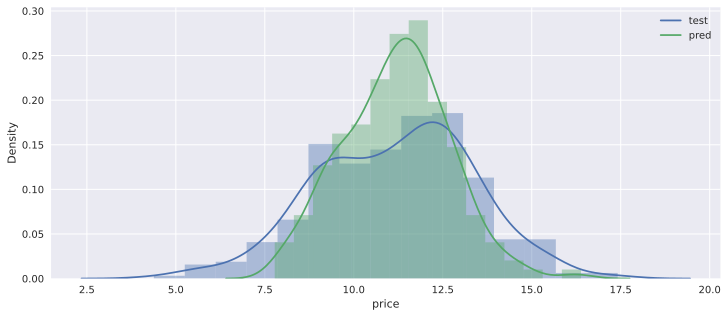

In [419]:
plt.figure(figsize=(12, 5))
sns.distplot(y_test)
sns.distplot(y_pred)
plt.legend(['test', 'pred'])
plt.show()

In [420]:
calc_metrics(y_test, y_pred)

*** VAL **: 
MSE:   2.1118232662207426
RMSE:  1.453211363229982
R2:    0.5646801020162491
MAE:   1.1299967719157546
MedAE: 0.888462235208789
------------------------------
[CV 5/5] END depth=5, iterations=5000, learning_rate=0.09625255790286641;, score=0.422 total time=124.3min
4875:	learn: 0.6482693	total: 12m 21s	remaining: 18.9s
4876:	learn: 0.6482229	total: 12m 21s	remaining: 18.7s
4877:	learn: 0.6480932	total: 12m 21s	remaining: 18.6s
4878:	learn: 0.6480423	total: 12m 22s	remaining: 18.4s
4879:	learn: 0.6480043	total: 12m 22s	remaining: 18.2s
4880:	learn: 0.6479787	total: 12m 22s	remaining: 18.1s
4881:	learn: 0.6479329	total: 12m 22s	remaining: 17.9s
4882:	learn: 0.6478161	total: 12m 22s	remaining: 17.8s
4883:	learn: 0.6476664	total: 12m 22s	remaining: 17.6s
4884:	learn: 0.6476265	total: 12m 22s	remaining: 17.5s
4885:	learn: 0.6476284	total: 12m 22s	remaining: 17.3s
4886:	learn: 0.6475669	total: 12m 22s	remaining: 17.2s
4887:	learn: 0.6474785	total: 12m 22s	remaining: 17s
4888:	le

4869:	learn: 0.8457708	total: 13m 6s	remaining: 21s
4870:	learn: 0.8457438	total: 13m 6s	remaining: 20.8s
4871:	learn: 0.8456959	total: 13m 6s	remaining: 20.7s
4872:	learn: 0.8456838	total: 13m 7s	remaining: 20.5s
4873:	learn: 0.8456693	total: 13m 7s	remaining: 20.4s
4874:	learn: 0.8455908	total: 13m 7s	remaining: 20.2s
4875:	learn: 0.8455865	total: 13m 7s	remaining: 20s
4876:	learn: 0.8455734	total: 13m 7s	remaining: 19.9s
4877:	learn: 0.8455588	total: 13m 7s	remaining: 19.7s
4878:	learn: 0.8455171	total: 13m 7s	remaining: 19.5s
4879:	learn: 0.8454709	total: 13m 7s	remaining: 19.4s
4880:	learn: 0.8453926	total: 13m 7s	remaining: 19.2s
4881:	learn: 0.8452654	total: 13m 8s	remaining: 19s
4882:	learn: 0.8452005	total: 13m 8s	remaining: 18.9s
4883:	learn: 0.8451086	total: 13m 8s	remaining: 18.7s
4884:	learn: 0.8450830	total: 13m 8s	remaining: 18.6s
4885:	learn: 0.8450751	total: 13m 8s	remaining: 18.4s
4886:	learn: 0.8450666	total: 13m 8s	remaining: 18.2s
4887:	learn: 0.8450637	total: 13m 

4998:	learn: 0.8470556	total: 14m 12s	remaining: 171ms
4999:	learn: 0.8470106	total: 14m 12s	remaining: 0us
[CV 4/5] END depth=4, iterations=5000, learning_rate=0.01632357444675522;, score=0.437 total time=127.2min
4904:	learn: 0.6211644	total: 10m 44s	remaining: 12.5s
4905:	learn: 0.6211370	total: 10m 44s	remaining: 12.4s
4906:	learn: 0.6210672	total: 10m 44s	remaining: 12.2s
4907:	learn: 0.6210112	total: 10m 44s	remaining: 12.1s
4908:	learn: 0.6209974	total: 10m 44s	remaining: 12s
4909:	learn: 0.6209615	total: 10m 44s	remaining: 11.8s
4910:	learn: 0.6209056	total: 10m 44s	remaining: 11.7s
4911:	learn: 0.6208762	total: 10m 45s	remaining: 11.6s
4912:	learn: 0.6208780	total: 10m 45s	remaining: 11.4s
4913:	learn: 0.6206932	total: 10m 45s	remaining: 11.3s
4914:	learn: 0.6206934	total: 10m 45s	remaining: 11.2s
4915:	learn: 0.6206519	total: 10m 45s	remaining: 11s
4916:	learn: 0.6206162	total: 10m 45s	remaining: 10.9s
4917:	learn: 0.6205444	total: 10m 45s	remaining: 10.8s
4918:	learn: 0.6205

4974:	learn: 0.1519285	total: 16m 30s	remaining: 4.98s
4975:	learn: 0.1518335	total: 16m 30s	remaining: 4.78s
4976:	learn: 0.1517006	total: 16m 30s	remaining: 4.58s
4977:	learn: 0.1516841	total: 16m 30s	remaining: 4.38s
4978:	learn: 0.1516127	total: 16m 31s	remaining: 4.18s
4979:	learn: 0.1515654	total: 16m 31s	remaining: 3.98s
4980:	learn: 0.1514792	total: 16m 31s	remaining: 3.78s
4981:	learn: 0.1514244	total: 16m 31s	remaining: 3.58s
4982:	learn: 0.1513791	total: 16m 31s	remaining: 3.38s
4983:	learn: 0.1513418	total: 16m 31s	remaining: 3.18s
4984:	learn: 0.1512604	total: 16m 31s	remaining: 2.98s
4985:	learn: 0.1512149	total: 16m 31s	remaining: 2.78s
4986:	learn: 0.1511034	total: 16m 31s	remaining: 2.58s
4987:	learn: 0.1510551	total: 16m 31s	remaining: 2.38s
4988:	learn: 0.1509924	total: 16m 31s	remaining: 2.19s
4989:	learn: 0.1509644	total: 16m 31s	remaining: 1.99s
4990:	learn: 0.1509313	total: 16m 31s	remaining: 1.79s
4991:	learn: 0.1509231	total: 16m 31s	remaining: 1.59s
4992:	lear

4999:	learn: 0.8737712	total: 14m 9s	remaining: 0us
[CV 3/5] END depth=4, iterations=5000, learning_rate=0.01632357444675522;, score=0.536 total time=128.2min
4893:	learn: 0.6194872	total: 10m 53s	remaining: 14.2s
4894:	learn: 0.6193757	total: 10m 53s	remaining: 14s
4895:	learn: 0.6193125	total: 10m 53s	remaining: 13.9s
4896:	learn: 0.6192995	total: 10m 53s	remaining: 13.7s
4897:	learn: 0.6191883	total: 10m 53s	remaining: 13.6s
4898:	learn: 0.6191786	total: 10m 53s	remaining: 13.5s
4899:	learn: 0.6191841	total: 10m 53s	remaining: 13.3s
4900:	learn: 0.6190709	total: 10m 53s	remaining: 13.2s
4901:	learn: 0.6190641	total: 10m 53s	remaining: 13.1s
4902:	learn: 0.6190559	total: 10m 53s	remaining: 12.9s
4903:	learn: 0.6190084	total: 10m 53s	remaining: 12.8s
4904:	learn: 0.6189914	total: 10m 53s	remaining: 12.7s
4905:	learn: 0.6189497	total: 10m 53s	remaining: 12.5s
4906:	learn: 0.6189378	total: 10m 53s	remaining: 12.4s
4907:	learn: 0.6188825	total: 10m 53s	remaining: 12.3s
4908:	learn: 0.618

4852:	learn: 0.2071134	total: 14m 7s	remaining: 25.7s
4853:	learn: 0.2071042	total: 14m 7s	remaining: 25.5s
4854:	learn: 0.2070894	total: 14m 7s	remaining: 25.3s
4855:	learn: 0.2068740	total: 14m 7s	remaining: 25.1s
4856:	learn: 0.2067439	total: 14m 7s	remaining: 25s
4857:	learn: 0.2066714	total: 14m 7s	remaining: 24.8s
4858:	learn: 0.2066590	total: 14m 7s	remaining: 24.6s
4859:	learn: 0.2066509	total: 14m 7s	remaining: 24.4s
4860:	learn: 0.2064845	total: 14m 7s	remaining: 24.2s
4861:	learn: 0.2064231	total: 14m 7s	remaining: 24.1s
4862:	learn: 0.2064224	total: 14m 7s	remaining: 23.9s
4863:	learn: 0.2063405	total: 14m 7s	remaining: 23.7s
4864:	learn: 0.2062241	total: 14m 7s	remaining: 23.5s
4865:	learn: 0.2062114	total: 14m 7s	remaining: 23.3s
4866:	learn: 0.2061855	total: 14m 7s	remaining: 23.2s
4867:	learn: 0.2060873	total: 14m 7s	remaining: 23s
4868:	learn: 0.2060446	total: 14m 7s	remaining: 22.8s
4869:	learn: 0.2060472	total: 14m 7s	remaining: 22.6s
4870:	learn: 0.2059463	total: 14